# Unpaired Style Transfer using CycleGAN
[CycleGAN](https://arxiv.org/pdf/1703.10593.pdf) improves upon paired style transfer architecture by relaxing the constraint on input and output images. CycleGAN explores the unpaired style transfer paradigm where the model actually tries to learn the stylistic differences between source and target domains without explicit pairing between input and output images. Zhu and Park et al. describe this unpaired style transfer similar to our ability of imagining how a Van Gogh or Monet would have painted a particular scene (without having actually seen a side by side example). Quoting from the paper  itself,

> Instead, we have knowledge of the set of Monet paintings and of the set of landscape photographs. We can reason about the stylistic differences between these two sets, and thereby imagine what a scene might look like if we were to “translate” it from one set into the other.


This provides a nice advantage as well as opens additional use cases where exact pairing of source and target domains is either not available or we do not have enough training examples.

[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/PacktPublishing/Hands-On-Generative-AI-with-Python-and-TensorFlow-2/blob/master/Chapter_7/cycleGAN/cycleGAN.ipynb)

## Load Libraries

In [1]:
from tensorflow.keras.layers import Input, Concatenate
from tensorflow.keras.layers import UpSampling2D, Conv2D
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.optimizers import Adam
from matplotlib import pyplot as plt
import tensorflow as tf
import numpy as np

## Load Utilities

In [2]:
from gan_utils import downsample_block, upsample_block, discriminator_block
from data_utils import plot_sample_images, batch_generator, get_samples

C:\Users\shkwon\anaconda3\envs\tensorflow-gpu\lib\site-packages\tensorflow_addons\utils\tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(
C:\Users\shkwon\anaconda3\envs\tensorflow-gpu\lib\site-packages\tensorflow_addons\utils\ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.12.0 and strictly below 2.15.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.6.0 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not f

## Set Configs

In [7]:
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (8,8),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}

plt.rcParams.update(params)

In [8]:
IMG_WIDTH = 128
IMG_HEIGHT = 128
dataset_name = 'apple2orange'

DOWNLOAD_URL = 'https://efrosgans.eecs.berkeley.edu/cyclegan/datasets/{}.zip'.format(dataset_name)

## U-Net Generator

In [9]:
def build_generator(img_shape, channels=3, num_filters=32):
    # Image input
    input_layer = Input(shape=img_shape)

    # Downsampling
    down_sample_1 = downsample_block(input_layer, num_filters)
    down_sample_2 = downsample_block(down_sample_1, num_filters*2)
    down_sample_3 = downsample_block(down_sample_2,num_filters*4)
    down_sample_4 = downsample_block(down_sample_3,num_filters*8)

    # Upsampling
    upsample_1 = upsample_block(down_sample_4, down_sample_3, num_filters*4)
    upsample_2 = upsample_block(upsample_1, down_sample_2, num_filters*2)
    upsample_3 = upsample_block(upsample_2, down_sample_1, num_filters)

    upsample_4 = UpSampling2D(size=2)(upsample_3)
    output_img = Conv2D(channels, 
                        kernel_size=4, 
                        strides=1, 
                        padding='same', 
                        activation='tanh')(upsample_4)

    return Model(input_layer, output_img)

## Discriminator

In [10]:
def build_discriminator(img_shape,num_filters=64):
    input_layer = Input(shape=img_shape)

    disc_block_1 = discriminator_block(input_layer, 
                                       num_filters, 
                                       instance_normalization=False)
    disc_block_2 = discriminator_block(disc_block_1, num_filters*2)
    disc_block_3 = discriminator_block(disc_block_2, num_filters*4)
    disc_block_4 = discriminator_block(disc_block_3, num_filters*8)

    output = Conv2D(1, kernel_size=4, strides=1, padding='same')(disc_block_4)

    return Model(input_layer, output)

## GAN Configuration

In [11]:
generator_filters = 32
discriminator_filters = 64

# input shape
channels = 3
input_shape = (IMG_HEIGHT, IMG_WIDTH, channels)

# Loss weights
lambda_cycle = 10.0            
lambda_identity = 0.1 * lambda_cycle

optimizer = Adam(0.0002, 0.5)

In [12]:
# prepare patch size for our setup
patch = int(IMG_HEIGHT / 2**4)
patch_gan_shape = (patch, patch, 1)
print("Patch Shape={}".format(patch_gan_shape))

Patch Shape=(8, 8, 1)


## Get Discriminators

In [13]:
disc_A = build_discriminator(input_shape,discriminator_filters)
disc_A.compile(loss='mse',
    optimizer=optimizer,
    metrics=['accuracy'])

disc_B = build_discriminator(input_shape,discriminator_filters)
disc_B.compile(loss='mse',
    optimizer=optimizer,
    metrics=['accuracy'])

## Get Generators and GAN Model Objects

In [14]:
gen_AB = build_generator(input_shape, channels, generator_filters)
gen_BA = build_generator(input_shape, channels, generator_filters)

In [15]:
img_A = Input(shape=input_shape)
img_B = Input(shape=input_shape)

# generate fake samples from both generators
fake_B = gen_AB(img_A)
fake_A = gen_BA(img_B)

# reconstruct orginal samples from both generators
reconstruct_A = gen_BA(fake_B)
reconstruct_B = gen_AB(fake_A)

# generate identity samples
identity_A = gen_BA(img_A)
identity_B = gen_AB(img_B)

# disable discriminator training
disc_A.trainable = False
disc_B.trainable = False

# use discriminator to classify real vs fake
output_A = disc_A(fake_A)
output_B = disc_B(fake_B)

# Combined model trains generators to fool discriminators
gan = Model(inputs=[img_A, img_B],
            outputs=[output_A, output_B,
                     reconstruct_A, reconstruct_B,
                     identity_A, identity_B ])
gan.compile(loss=['mse', 'mse','mae', 'mae','mae', 'mae'],
            loss_weights=[1, 1,
                          lambda_cycle, lambda_cycle,
                          lambda_identity, lambda_identity ],
            optimizer=optimizer)

## Custom Training Loop

In [16]:
def train(gen_AB, 
          gen_BA, 
          disc_A, 
          disc_B, 
          gan, 
          patch_gan_shape, 
          epochs, 
          path='./content/{}'.format(dataset_name) ,
          batch_size=1, 
          sample_interval=50):

    # Adversarial loss ground truths
    real_y = np.ones((batch_size,) + patch_gan_shape)
    fake_y = np.zeros((batch_size,) + patch_gan_shape)

    imgs = batch_generator(path, batch_size, image_res=[IMG_HEIGHT, IMG_WIDTH])
    print(imgs)

    for epoch in range(epochs):
        print("Epoch={}".format(epoch))
        for idx, (imgs_A, imgs_B) in enumerate(batch_generator(path,
                                                               batch_size,
                                                               image_res=[IMG_HEIGHT, IMG_WIDTH])):

            # train discriminators

            # generate fake samples from both generators
            fake_B = gen_AB.predict(imgs_A)
            fake_A = gen_BA.predict(imgs_B)

            # Train the discriminators (original images = real / translated = Fake)
            disc_A_loss_real = disc_A.train_on_batch(imgs_A, real_y)
            disc_A_loss_fake = disc_A.train_on_batch(fake_A, fake_y)
            disc_A_loss = 0.5 * np.add(disc_A_loss_real, disc_A_loss_fake)

            disc_B_loss_real = disc_B.train_on_batch(imgs_B, real_y)
            disc_B_loss_fake = disc_B.train_on_batch(fake_B, fake_y)
            disc_B_loss = 0.5 * np.add(disc_B_loss_real, disc_B_loss_fake)

            # Total disciminator loss
            discriminator_loss = 0.5 * np.add(disc_A_loss, disc_B_loss)


            # train generator
            gen_loss = gan.train_on_batch([imgs_A, imgs_B],
                                          [
                                           real_y, real_y,
                                           imgs_A, imgs_B,
                                           imgs_A, imgs_B
                                           ]
                                          )

            # training updates every 50 iterations
            if idx % 50 == 0:
              print ("[Epoch {}/{}] [Discriminator loss: {}, accuracy: {}][Generator loss: {}, Adversarial Loss: {}, Reconstruction Loss: {}, Identity Loss: {}]".format(idx, 
                                                  epoch,
                                                  discriminator_loss[0], 
                                                  100*discriminator_loss[1],
                                                  gen_loss[0],
                                                  np.mean(gen_loss[1:3]),
                                                  np.mean(gen_loss[3:5]),
                                                  np.mean(gen_loss[5:6])))
              
            # Plot and Save progress every few iterations
            if idx % sample_interval == 0:
              plot_sample_images(gen_AB,
                                 gen_BA,
                                 path=path,
                                 epoch=epoch,
                                 batch_num=idx,
                                 output_dir='images')

## Download Dataset

In [17]:
import os
path = os.getcwd()
path = os.path.join(path, 'content')

tf.keras.utils.get_file('{}.tar.gz'.format(dataset_name),
                         origin=DOWNLOAD_URL,
                         cache_subdir=path,
                         extract=True)

78471168/78456409 [==============================] - 9s 0us/step


'D:\\Home\\Project\\MachineLearning\\GAN\\gan_utils\\content\\apple2orange.tar.gz'

## Training Begins!

<generator object batch_generator at 0x0000020CBC4995F0>
Epoch=0
[Epoch 0/0] [Discriminator loss: 3.0956594944000244, accuracy: 48.828125][Generator loss: 62.604942321777344, Adversarial Loss: 21.514001846313477, Reconstruction Loss: 0.8823650181293488, Identity Loss: 0.9499697685241699]


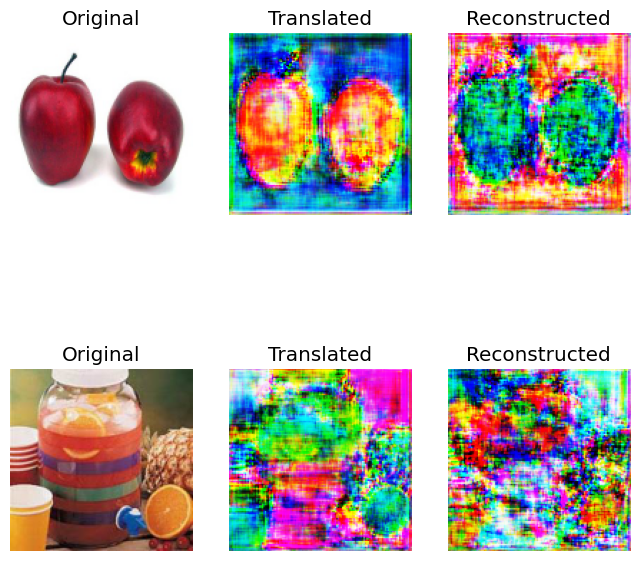

[Epoch 50/0] [Discriminator loss: 0.2841423377394676, accuracy: 66.40625][Generator loss: 10.857332229614258, Adversarial Loss: 0.8537413477897644, Reconstruction Loss: 0.35188429057598114, Identity Loss: 1.0356239080429077]
[Epoch 100/0] [Discriminator loss: 0.34982749074697495, accuracy: 56.25][Generator loss: 9.753205299377441, Adversarial Loss: 0.5290578305721283, Reconstruction Loss: 0.3509681224822998, Identity Loss: 0.8655134439468384]
[Epoch 150/0] [Discriminator loss: 0.4252697303891182, accuracy: 53.90625][Generator loss: 9.279027938842773, Adversarial Loss: 0.5513000190258026, Reconstruction Loss: 0.3520386219024658, Identity Loss: 0.5482386350631714]
[Epoch 200/0] [Discriminator loss: 0.2400454431772232, accuracy: 69.921875][Generator loss: 8.964183807373047, Adversarial Loss: 0.6247810423374176, Reconstruction Loss: 0.3384145349264145, Identity Loss: 0.4452284872531891]


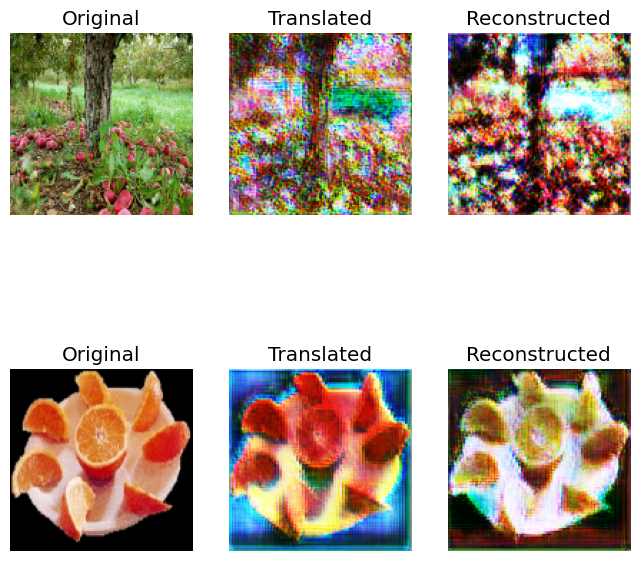

[Epoch 250/0] [Discriminator loss: 0.23084748908877373, accuracy: 68.75][Generator loss: 9.395936965942383, Adversarial Loss: 0.5351776480674744, Reconstruction Loss: 0.3723813593387604, Identity Loss: 0.45311152935028076]
[Epoch 300/0] [Discriminator loss: 0.33739616349339485, accuracy: 57.8125][Generator loss: 7.215364933013916, Adversarial Loss: 0.6850132942199707, Reconstruction Loss: 0.2652086913585663, Identity Loss: 0.26267313957214355]
[Epoch 350/0] [Discriminator loss: 0.21325543522834778, accuracy: 71.875][Generator loss: 10.697502136230469, Adversarial Loss: 0.5623877942562103, Reconstruction Loss: 0.432677686214447, Identity Loss: 0.4429067373275757]
[Epoch 400/0] [Discriminator loss: 0.19319790601730347, accuracy: 75.390625][Generator loss: 8.708669662475586, Adversarial Loss: 0.607227623462677, Reconstruction Loss: 0.34177178144454956, Identity Loss: 0.20694932341575623]


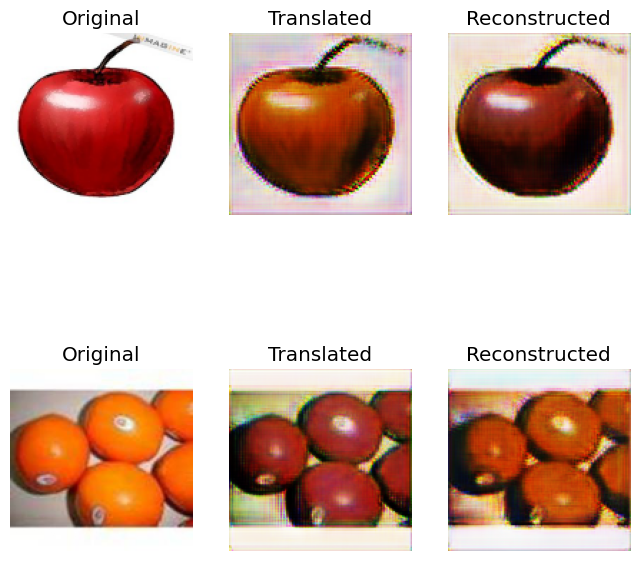

[Epoch 450/0] [Discriminator loss: 0.2872508727014065, accuracy: 59.375][Generator loss: 5.4542741775512695, Adversarial Loss: 0.6074396967887878, Reconstruction Loss: 0.19268275052309036, Identity Loss: 0.1722314953804016]
[Epoch 500/0] [Discriminator loss: 0.2632530014961958, accuracy: 66.796875][Generator loss: 11.470457077026367, Adversarial Loss: 0.5823877155780792, Reconstruction Loss: 0.4678308516740799, Identity Loss: 0.3276273012161255]
[Epoch 550/0] [Discriminator loss: 0.28922243416309357, accuracy: 52.34375][Generator loss: 8.163731575012207, Adversarial Loss: 0.5148539245128632, Reconstruction Loss: 0.32572802901268005, Identity Loss: 0.273121178150177]
[Epoch 600/0] [Discriminator loss: 0.24073057994246483, accuracy: 67.578125][Generator loss: 7.532066345214844, Adversarial Loss: 0.6020431220531464, Reconstruction Loss: 0.28756098449230194, Identity Loss: 0.308948278427124]


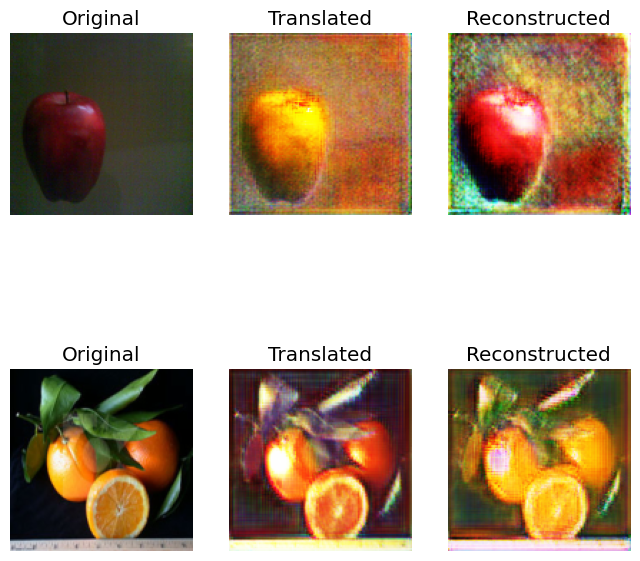

[Epoch 650/0] [Discriminator loss: 0.17100858315825462, accuracy: 74.609375][Generator loss: 9.429511070251465, Adversarial Loss: 0.630544513463974, Reconstruction Loss: 0.3662327080965042, Identity Loss: 0.5616084337234497]
[Epoch 700/0] [Discriminator loss: 0.26248716562986374, accuracy: 66.796875][Generator loss: 8.207418441772461, Adversarial Loss: 0.6151694059371948, Reconstruction Loss: 0.3179375231266022, Identity Loss: 0.26531141996383667]
[Epoch 750/0] [Discriminator loss: 0.23315772414207458, accuracy: 67.1875][Generator loss: 7.076235771179199, Adversarial Loss: 0.6869634389877319, Reconstruction Loss: 0.25781163573265076, Identity Loss: 0.2921143174171448]
[Epoch 800/0] [Discriminator loss: 0.16853225976228714, accuracy: 78.515625][Generator loss: 7.140296936035156, Adversarial Loss: 0.6287613213062286, Reconstruction Loss: 0.26752500981092453, Identity Loss: 0.2989257574081421]


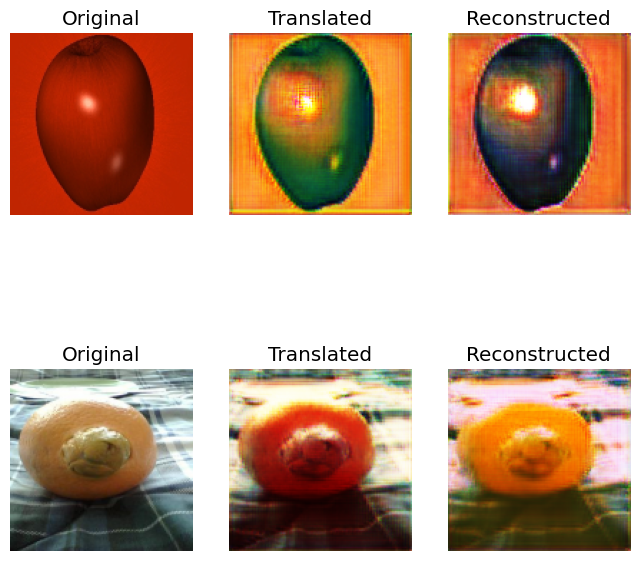

[Epoch 850/0] [Discriminator loss: 0.25488101691007614, accuracy: 63.671875][Generator loss: 5.77603816986084, Adversarial Loss: 0.6564455628395081, Reconstruction Loss: 0.20297180116176605, Identity Loss: 0.16970813274383545]
[Epoch 900/0] [Discriminator loss: 0.15238029789179564, accuracy: 78.90625][Generator loss: 6.5693464279174805, Adversarial Loss: 0.6490894556045532, Reconstruction Loss: 0.24192777276039124, Identity Loss: 0.1859872043132782]
[Epoch 950/0] [Discriminator loss: 0.3293279781937599, accuracy: 59.375][Generator loss: 7.528328895568848, Adversarial Loss: 0.4608224630355835, Reconstruction Loss: 0.29973694682121277, Identity Loss: 0.23217231035232544]
Epoch=1
[Epoch 0/1] [Discriminator loss: 0.21484509110450745, accuracy: 76.171875][Generator loss: 8.24301528930664, Adversarial Loss: 0.6174636483192444, Reconstruction Loss: 0.31515663862228394, Identity Loss: 0.35569655895233154]


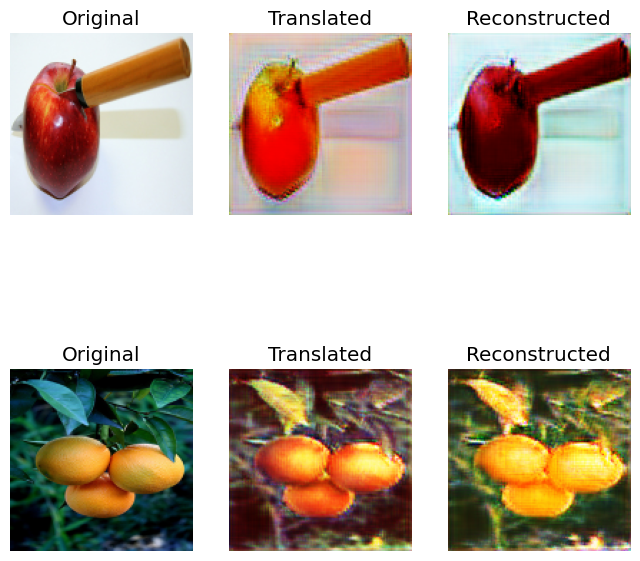

[Epoch 50/1] [Discriminator loss: 0.2670022062957287, accuracy: 57.03125][Generator loss: 7.591256141662598, Adversarial Loss: 0.4932619631290436, Reconstruction Loss: 0.30137524753808975, Identity Loss: 0.17863281071186066]
[Epoch 100/1] [Discriminator loss: 0.3576040118932724, accuracy: 43.75][Generator loss: 5.869470596313477, Adversarial Loss: 0.5221532136201859, Reconstruction Loss: 0.2196139693260193, Identity Loss: 0.2734387516975403]
[Epoch 150/1] [Discriminator loss: 0.2499910704791546, accuracy: 73.046875][Generator loss: 8.300047874450684, Adversarial Loss: 0.7048554420471191, Reconstruction Loss: 0.313102051615715, Identity Loss: 0.3259321451187134]
[Epoch 200/1] [Discriminator loss: 0.315134160220623, accuracy: 46.484375][Generator loss: 5.315964698791504, Adversarial Loss: 0.44576627016067505, Reconstruction Loss: 0.199726901948452, Identity Loss: 0.25582176446914673]


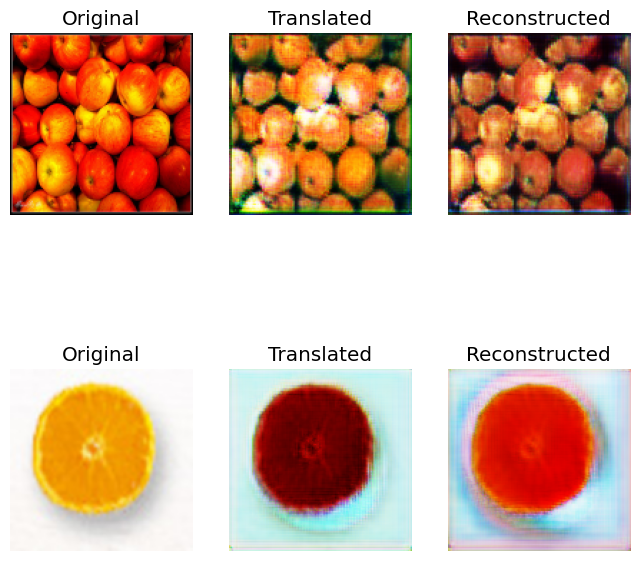

[Epoch 250/1] [Discriminator loss: 0.22906392253935337, accuracy: 71.09375][Generator loss: 6.041678428649902, Adversarial Loss: 0.5383395105600357, Reconstruction Loss: 0.22422326356172562, Identity Loss: 0.1660475730895996]
[Epoch 300/1] [Discriminator loss: 0.17561088874936104, accuracy: 74.609375][Generator loss: 5.674701690673828, Adversarial Loss: 0.661988765001297, Reconstruction Loss: 0.196298748254776, Identity Loss: 0.25627052783966064]
[Epoch 350/1] [Discriminator loss: 0.1268376437947154, accuracy: 86.71875][Generator loss: 8.431352615356445, Adversarial Loss: 0.7090371549129486, Reconstruction Loss: 0.3181106150150299, Identity Loss: 0.369361937046051]
[Epoch 400/1] [Discriminator loss: 0.24713821336627007, accuracy: 62.890625][Generator loss: 8.595050811767578, Adversarial Loss: 0.6843568682670593, Reconstruction Loss: 0.3241513669490814, Identity Loss: 0.30479443073272705]


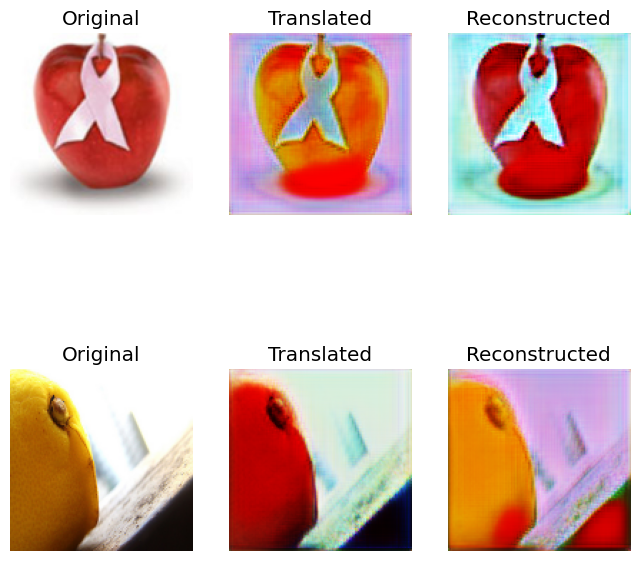

[Epoch 450/1] [Discriminator loss: 0.3374621532857418, accuracy: 73.828125][Generator loss: 8.003662109375, Adversarial Loss: 0.7386713325977325, Reconstruction Loss: 0.29187868535518646, Identity Loss: 0.3871544301509857]
[Epoch 500/1] [Discriminator loss: 0.2655858173966408, accuracy: 58.203125][Generator loss: 4.714085578918457, Adversarial Loss: 0.45450152456760406, Reconstruction Loss: 0.17126277834177017, Identity Loss: 0.18461869657039642]
[Epoch 550/1] [Discriminator loss: 0.33667775988578796, accuracy: 50.390625][Generator loss: 6.5035834312438965, Adversarial Loss: 0.5694037824869156, Reconstruction Loss: 0.24313603341579437, Identity Loss: 0.21484720706939697]
[Epoch 600/1] [Discriminator loss: 0.2917221300303936, accuracy: 52.34375][Generator loss: 6.107674598693848, Adversarial Loss: 0.4996984302997589, Reconstruction Loss: 0.2339271903038025, Identity Loss: 0.23651981353759766]


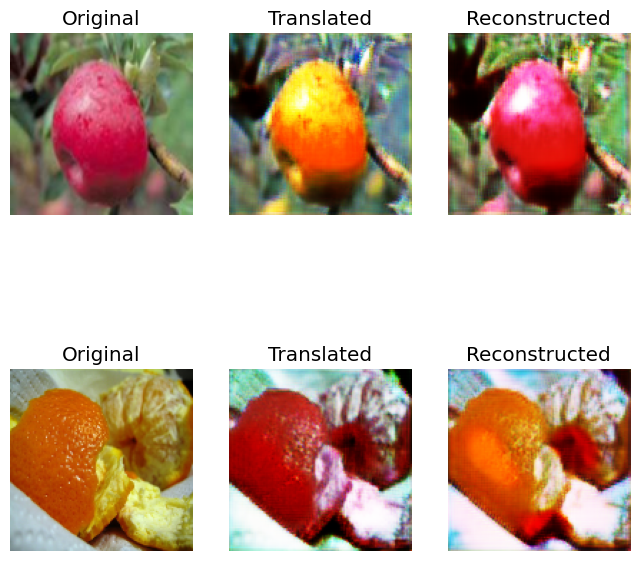

[Epoch 650/1] [Discriminator loss: 0.24394876137375832, accuracy: 68.359375][Generator loss: 5.798686981201172, Adversarial Loss: 0.4456944316625595, Reconstruction Loss: 0.2196560651063919, Identity Loss: 0.3462170362472534]
[Epoch 700/1] [Discriminator loss: 0.36671944335103035, accuracy: 45.703125][Generator loss: 5.631576061248779, Adversarial Loss: 0.5571953654289246, Reconstruction Loss: 0.20682316273450851, Identity Loss: 0.14983180165290833]
[Epoch 750/1] [Discriminator loss: 0.13976339157670736, accuracy: 84.375][Generator loss: 7.687972545623779, Adversarial Loss: 0.7400543391704559, Reconstruction Loss: 0.28002581000328064, Identity Loss: 0.3040367662906647]
[Epoch 800/1] [Discriminator loss: 0.24526285752654076, accuracy: 59.765625][Generator loss: 7.127310752868652, Adversarial Loss: 0.621840238571167, Reconstruction Loss: 0.26606879383325577, Identity Loss: 0.2699759006500244]


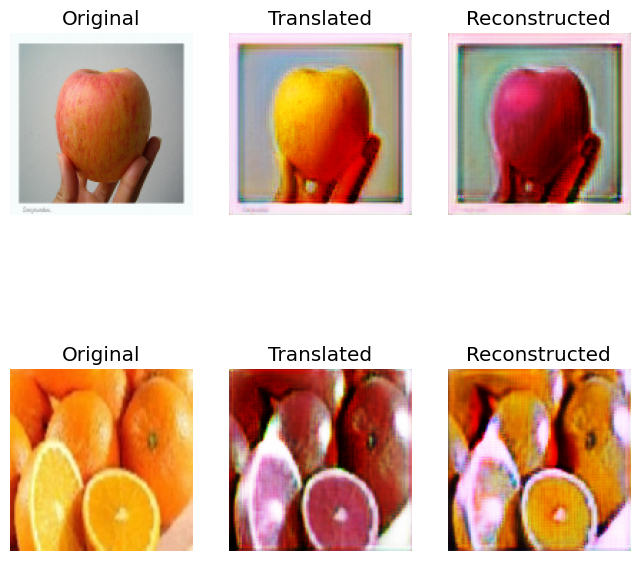

[Epoch 850/1] [Discriminator loss: 0.2274545282125473, accuracy: 67.578125][Generator loss: 9.330131530761719, Adversarial Loss: 0.63682621717453, Reconstruction Loss: 0.37326326966285706, Identity Loss: 0.3391273319721222]
[Epoch 900/1] [Discriminator loss: 0.29558010771870613, accuracy: 56.640625][Generator loss: 5.887368202209473, Adversarial Loss: 0.7531406581401825, Reconstruction Loss: 0.19279637187719345, Identity Loss: 0.29455697536468506]
[Epoch 950/1] [Discriminator loss: 0.2534102387726307, accuracy: 64.84375][Generator loss: 5.976912498474121, Adversarial Loss: 0.5587703883647919, Reconstruction Loss: 0.21893726289272308, Identity Loss: 0.2835503816604614]
Epoch=2
[Epoch 0/2] [Discriminator loss: 0.2797727510333061, accuracy: 65.234375][Generator loss: 6.462958335876465, Adversarial Loss: 0.7229792475700378, Reconstruction Loss: 0.2247374877333641, Identity Loss: 0.2588355839252472]


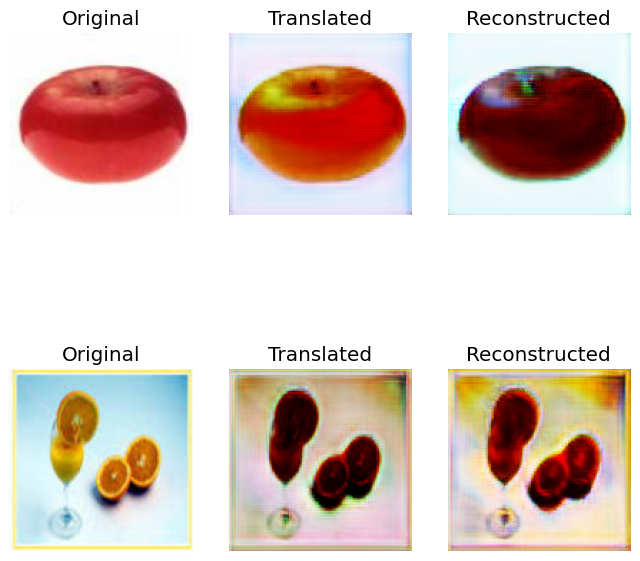

[Epoch 50/2] [Discriminator loss: 0.2529935799539089, accuracy: 68.359375][Generator loss: 9.62546443939209, Adversarial Loss: 0.6644617021083832, Reconstruction Loss: 0.3764050006866455, Identity Loss: 0.28346145153045654]
[Epoch 100/2] [Discriminator loss: 0.24135361053049564, accuracy: 68.359375][Generator loss: 6.821883678436279, Adversarial Loss: 0.7271018326282501, Reconstruction Loss: 0.2411983162164688, Identity Loss: 0.3174123764038086]
[Epoch 150/2] [Discriminator loss: 0.268494775518775, accuracy: 60.15625][Generator loss: 7.916377067565918, Adversarial Loss: 0.5925177335739136, Reconstruction Loss: 0.31231651455163956, Identity Loss: 0.256692111492157]
[Epoch 200/2] [Discriminator loss: 0.16846079751849174, accuracy: 76.953125][Generator loss: 6.927555561065674, Adversarial Loss: 0.6751806735992432, Reconstruction Loss: 0.2539694979786873, Identity Loss: 0.3037823438644409]


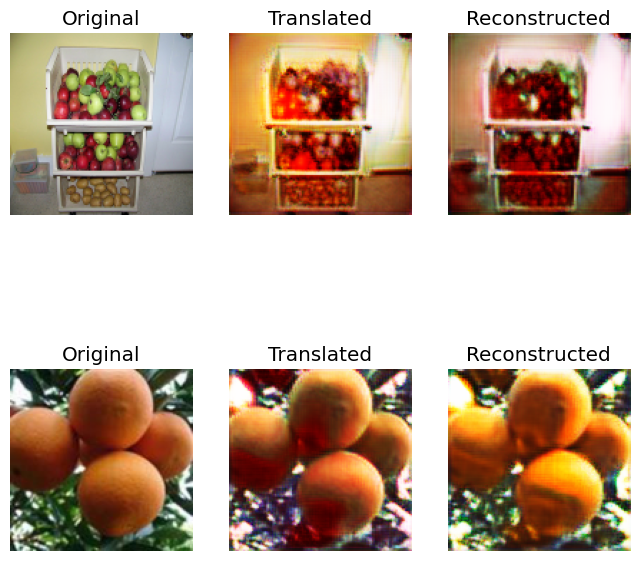

[Epoch 250/2] [Discriminator loss: 0.06915566138923168, accuracy: 97.65625][Generator loss: 8.196856498718262, Adversarial Loss: 0.7527127265930176, Reconstruction Loss: 0.3020636737346649, Identity Loss: 0.44079333543777466]
[Epoch 300/2] [Discriminator loss: 0.1799382772296667, accuracy: 73.4375][Generator loss: 4.669406890869141, Adversarial Loss: 0.5952262878417969, Reconstruction Loss: 0.15710794925689697, Identity Loss: 0.18856540322303772]
[Epoch 350/2] [Discriminator loss: 0.1386734927073121, accuracy: 80.46875][Generator loss: 7.513307571411133, Adversarial Loss: 0.6976959109306335, Reconstruction Loss: 0.27503952383995056, Identity Loss: 0.3208804130554199]
[Epoch 400/2] [Discriminator loss: 0.1664191409945488, accuracy: 75.0][Generator loss: 6.5581488609313965, Adversarial Loss: 0.8360003530979156, Reconstruction Loss: 0.21852990984916687, Identity Loss: 0.2056277096271515]


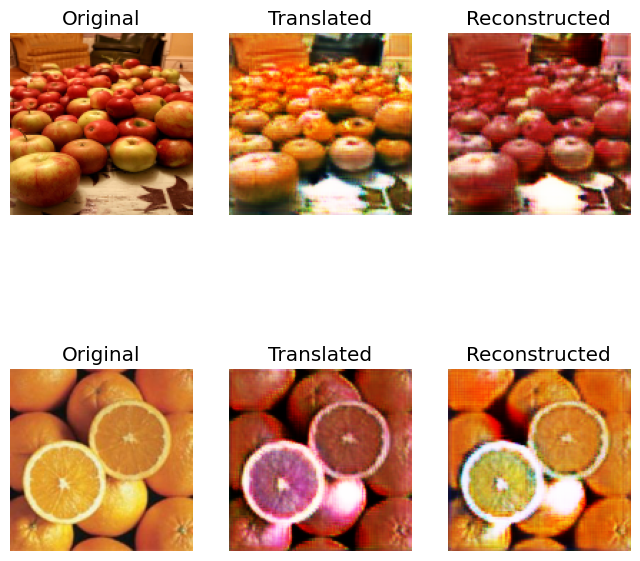

[Epoch 450/2] [Discriminator loss: 0.22347372770309448, accuracy: 71.875][Generator loss: 6.6345415115356445, Adversarial Loss: 0.7377567887306213, Reconstruction Loss: 0.2354699671268463, Identity Loss: 0.15133371949195862]
[Epoch 500/2] [Discriminator loss: 0.19946571812033653, accuracy: 76.5625][Generator loss: 6.697608947753906, Adversarial Loss: 0.6999884843826294, Reconstruction Loss: 0.24624058604240417, Identity Loss: 0.19272834062576294]
[Epoch 550/2] [Discriminator loss: 0.3171028718352318, accuracy: 52.734375][Generator loss: 4.891355514526367, Adversarial Loss: 0.5837255120277405, Reconstruction Loss: 0.17158115655183792, Identity Loss: 0.13017743825912476]
[Epoch 600/2] [Discriminator loss: 0.06200102996081114, accuracy: 98.046875][Generator loss: 7.233757495880127, Adversarial Loss: 0.9011460542678833, Reconstruction Loss: 0.24462132155895233, Identity Loss: 0.23560015857219696]


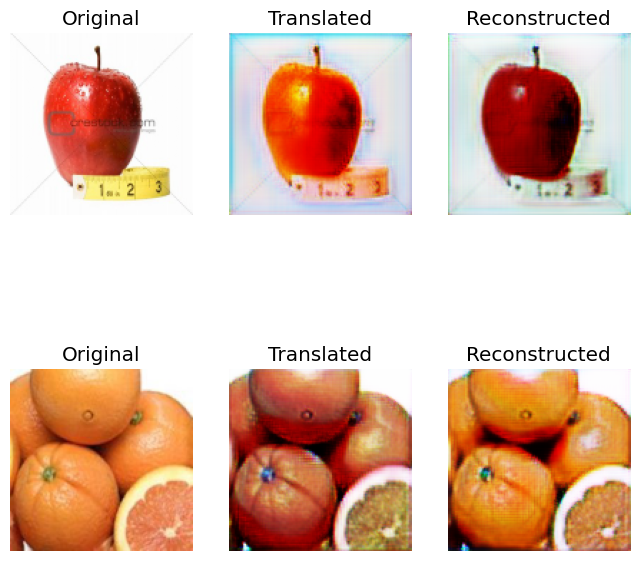

[Epoch 650/2] [Discriminator loss: 0.0928869228810072, accuracy: 96.484375][Generator loss: 7.6956892013549805, Adversarial Loss: 0.6977634131908417, Reconstruction Loss: 0.28241395950317383, Identity Loss: 0.37353551387786865]
[Epoch 700/2] [Discriminator loss: 0.5449804738163948, accuracy: 26.953125][Generator loss: 5.778764247894287, Adversarial Loss: 0.7440105974674225, Reconstruction Loss: 0.1967908889055252, Identity Loss: 0.15593375265598297]
[Epoch 750/2] [Discriminator loss: 0.21902121976017952, accuracy: 66.015625][Generator loss: 5.991995811462402, Adversarial Loss: 0.5496782958507538, Reconstruction Loss: 0.21988121420145035, Identity Loss: 0.2658655643463135]
[Epoch 800/2] [Discriminator loss: 0.21738865599036217, accuracy: 75.78125][Generator loss: 7.066519260406494, Adversarial Loss: 1.0761452913284302, Reconstruction Loss: 0.22723020613193512, Identity Loss: 0.1621769368648529]


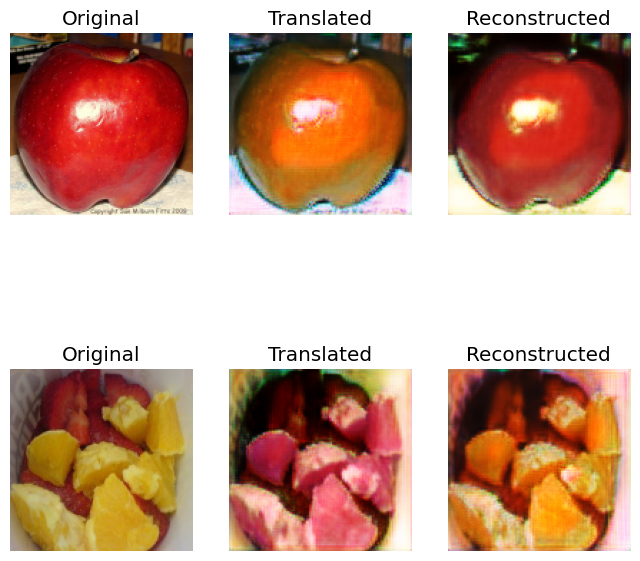

[Epoch 850/2] [Discriminator loss: 0.214160718023777, accuracy: 70.3125][Generator loss: 5.1915202140808105, Adversarial Loss: 0.4973897933959961, Reconstruction Loss: 0.1890564188361168, Identity Loss: 0.24322189390659332]
[Epoch 900/2] [Discriminator loss: 0.20376860909163952, accuracy: 65.234375][Generator loss: 6.174444675445557, Adversarial Loss: 0.674443855881691, Reconstruction Loss: 0.21627994626760483, Identity Loss: 0.2221652865409851]
[Epoch 950/2] [Discriminator loss: 0.26988331601023674, accuracy: 62.109375][Generator loss: 5.331663608551025, Adversarial Loss: 0.741361141204834, Reconstruction Loss: 0.17457375675439835, Identity Loss: 0.14789459109306335]
Epoch=3
[Epoch 0/3] [Discriminator loss: 0.19198660738766193, accuracy: 79.6875][Generator loss: 8.755657196044922, Adversarial Loss: 0.7179517447948456, Reconstruction Loss: 0.3338412791490555, Identity Loss: 0.25308769941329956]


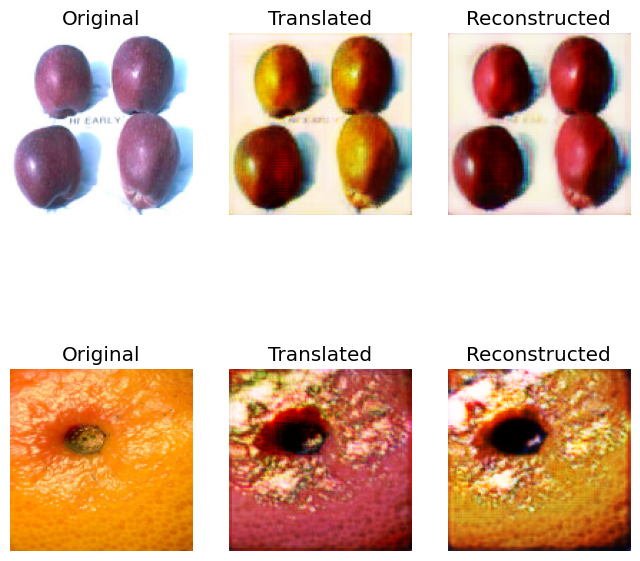

[Epoch 50/3] [Discriminator loss: 0.17964449431747198, accuracy: 75.78125][Generator loss: 7.025449752807617, Adversarial Loss: 0.8898565471172333, Reconstruction Loss: 0.2409975901246071, Identity Loss: 0.14201140403747559]
[Epoch 100/3] [Discriminator loss: 0.2570049464702606, accuracy: 60.15625][Generator loss: 6.131274223327637, Adversarial Loss: 0.5962763726711273, Reconstruction Loss: 0.22334158420562744, Identity Loss: 0.2857332229614258]
[Epoch 150/3] [Discriminator loss: 0.11132062412798405, accuracy: 88.28125][Generator loss: 6.231071472167969, Adversarial Loss: 0.7030907571315765, Reconstruction Loss: 0.21842142939567566, Identity Loss: 0.2417890727519989]
[Epoch 200/3] [Discriminator loss: 0.0674604750238359, accuracy: 95.3125][Generator loss: 9.3236665725708, Adversarial Loss: 0.726405143737793, Reconstruction Loss: 0.3584088385105133, Identity Loss: 0.34683942794799805]


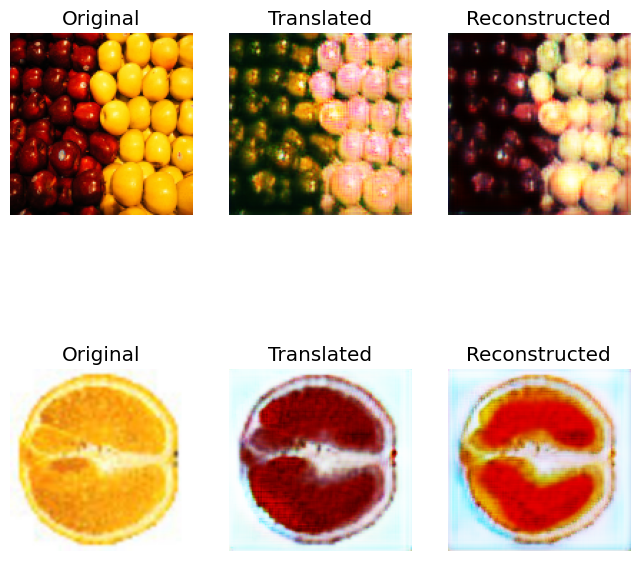

[Epoch 250/3] [Discriminator loss: 0.25798510015010834, accuracy: 73.4375][Generator loss: 6.786861419677734, Adversarial Loss: 0.8879765868186951, Reconstruction Loss: 0.2288178652524948, Identity Loss: 0.1472053974866867]
[Epoch 300/3] [Discriminator loss: 0.18892434053122997, accuracy: 71.875][Generator loss: 6.827188491821289, Adversarial Loss: 0.5466739237308502, Reconstruction Loss: 0.26094841212034225, Identity Loss: 0.18894249200820923]
[Epoch 350/3] [Discriminator loss: 0.2233816720545292, accuracy: 71.875][Generator loss: 5.60759162902832, Adversarial Loss: 0.7967651784420013, Reconstruction Loss: 0.17883393168449402, Identity Loss: 0.18701380491256714]
[Epoch 400/3] [Discriminator loss: 0.14188525918871164, accuracy: 76.953125][Generator loss: 5.491815567016602, Adversarial Loss: 0.8506186604499817, Reconstruction Loss: 0.17037131637334824, Identity Loss: 0.19940166175365448]


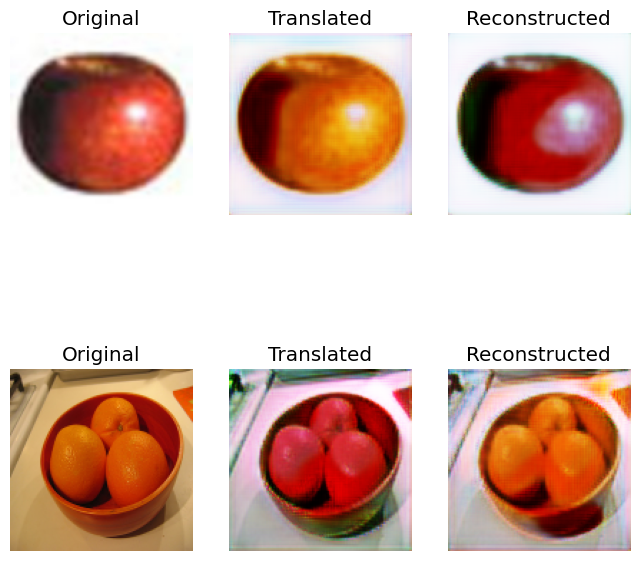

[Epoch 450/3] [Discriminator loss: 0.16938658710569143, accuracy: 82.421875][Generator loss: 7.69798469543457, Adversarial Loss: 0.9094342887401581, Reconstruction Loss: 0.2660965770483017, Identity Loss: 0.3072325587272644]
[Epoch 500/3] [Discriminator loss: 0.19722456857562065, accuracy: 72.265625][Generator loss: 5.349501609802246, Adversarial Loss: 0.6236328482627869, Reconstruction Loss: 0.1802489310503006, Identity Loss: 0.282278835773468]
[Epoch 550/3] [Discriminator loss: 0.1397162266075611, accuracy: 83.203125][Generator loss: 6.335654258728027, Adversarial Loss: 0.7796897888183594, Reconstruction Loss: 0.21313948929309845, Identity Loss: 0.22367453575134277]
[Epoch 600/3] [Discriminator loss: 0.11790580302476883, accuracy: 90.625][Generator loss: 6.326114177703857, Adversarial Loss: 0.768007755279541, Reconstruction Loss: 0.21610049903392792, Identity Loss: 0.2135823369026184]


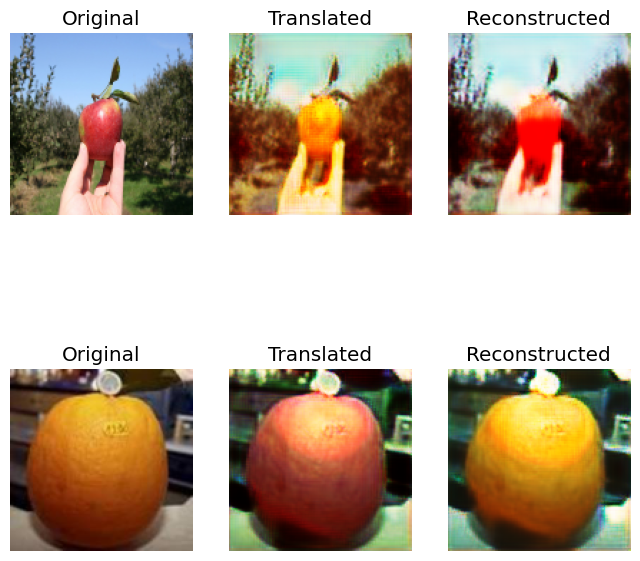

[Epoch 650/3] [Discriminator loss: 0.16755693778395653, accuracy: 80.46875][Generator loss: 6.991311073303223, Adversarial Loss: 0.8000646829605103, Reconstruction Loss: 0.24471040070056915, Identity Loss: 0.1325417309999466]
[Epoch 700/3] [Discriminator loss: 0.24202516674995422, accuracy: 60.15625][Generator loss: 4.834226131439209, Adversarial Loss: 0.6146779656410217, Reconstruction Loss: 0.1639939844608307, Identity Loss: 0.14571604132652283]
[Epoch 750/3] [Discriminator loss: 0.20755057968199253, accuracy: 72.65625][Generator loss: 5.8467512130737305, Adversarial Loss: 0.6700983047485352, Reconstruction Loss: 0.20528371632099152, Identity Loss: 0.2425537109375]
[Epoch 800/3] [Discriminator loss: 0.14683954790234566, accuracy: 77.734375][Generator loss: 5.4685211181640625, Adversarial Loss: 0.6004498898983002, Reconstruction Loss: 0.1906311810016632, Identity Loss: 0.24356041848659515]


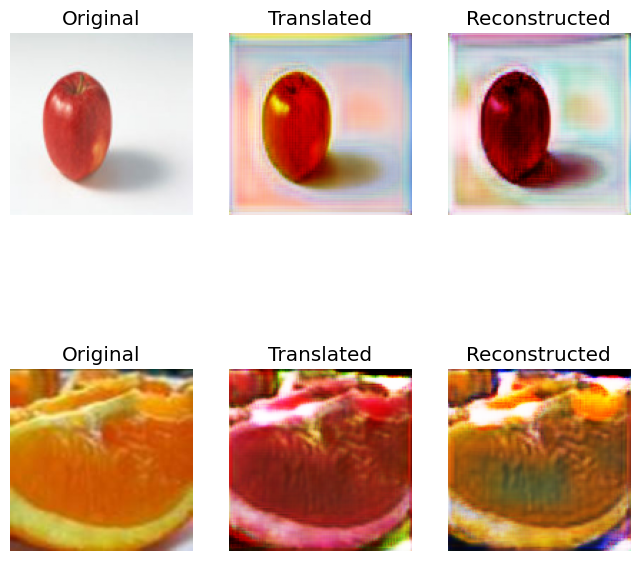

[Epoch 850/3] [Discriminator loss: 0.16641488391906023, accuracy: 81.25][Generator loss: 7.980281829833984, Adversarial Loss: 0.7484175264835358, Reconstruction Loss: 0.2926475703716278, Identity Loss: 0.19023121893405914]
[Epoch 900/3] [Discriminator loss: 0.15965288039296865, accuracy: 81.640625][Generator loss: 5.607285022735596, Adversarial Loss: 1.0625805854797363, Reconstruction Loss: 0.1573343127965927, Identity Loss: 0.16482976078987122]
[Epoch 950/3] [Discriminator loss: 0.15134082362055779, accuracy: 79.6875][Generator loss: 6.20850944519043, Adversarial Loss: 0.6933688521385193, Reconstruction Loss: 0.21884535998106003, Identity Loss: 0.1990058720111847]
Epoch=4
[Epoch 0/4] [Discriminator loss: 0.14622031897306442, accuracy: 81.25][Generator loss: 8.822888374328613, Adversarial Loss: 0.8398520648479462, Reconstruction Loss: 0.3218812122941017, Identity Loss: 0.5020420551300049]


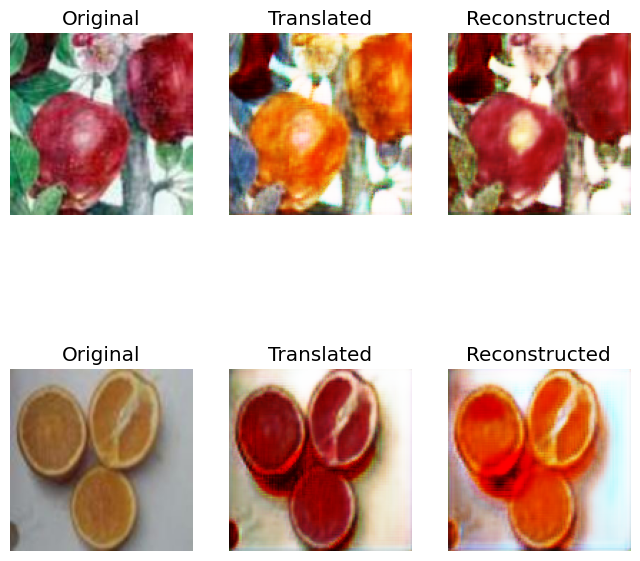

[Epoch 50/4] [Discriminator loss: 0.358591053634882, accuracy: 63.671875][Generator loss: 7.299863815307617, Adversarial Loss: 0.9963982701301575, Reconstruction Loss: 0.2411508932709694, Identity Loss: 0.24972262978553772]
[Epoch 100/4] [Discriminator loss: 0.10192609764635563, accuracy: 90.625][Generator loss: 6.20857048034668, Adversarial Loss: 0.69053915143013, Reconstruction Loss: 0.2193370759487152, Identity Loss: 0.23752155900001526]
[Epoch 150/4] [Discriminator loss: 0.17006860114634037, accuracy: 77.734375][Generator loss: 6.5253520011901855, Adversarial Loss: 0.7624614536762238, Reconstruction Loss: 0.22731062769889832, Identity Loss: 0.2866957187652588]
[Epoch 200/4] [Discriminator loss: 0.23622956313192844, accuracy: 60.546875][Generator loss: 5.170247554779053, Adversarial Loss: 0.6479889154434204, Reconstruction Loss: 0.17334333062171936, Identity Loss: 0.23240050673484802]


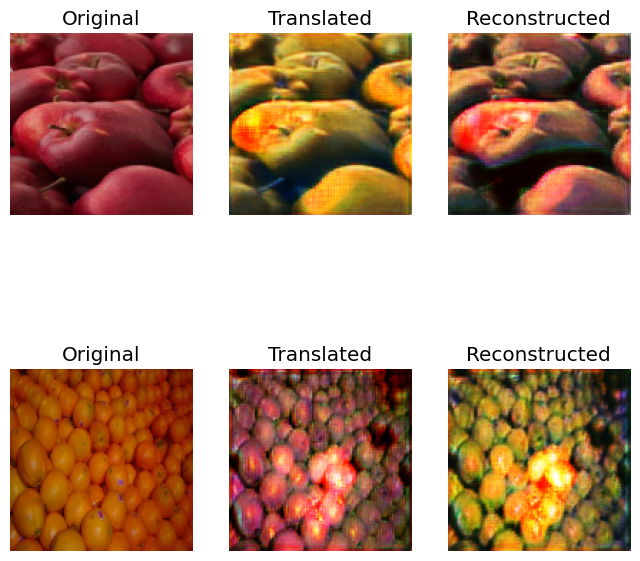

[Epoch 250/4] [Discriminator loss: 0.14649117458611727, accuracy: 80.078125][Generator loss: 5.461545944213867, Adversarial Loss: 0.6623702049255371, Reconstruction Loss: 0.1832030490040779, Identity Loss: 0.25289756059646606]
[Epoch 300/4] [Discriminator loss: 0.1381508046761155, accuracy: 82.03125][Generator loss: 6.717127799987793, Adversarial Loss: 0.8129303753376007, Reconstruction Loss: 0.22974174469709396, Identity Loss: 0.1672857701778412]
[Epoch 350/4] [Discriminator loss: 0.2043703757226467, accuracy: 69.140625][Generator loss: 6.461124420166016, Adversarial Loss: 0.8908588886260986, Reconstruction Loss: 0.20693671703338623, Identity Loss: 0.3601623773574829]
[Epoch 400/4] [Discriminator loss: 0.1244960268959403, accuracy: 87.890625][Generator loss: 7.3703131675720215, Adversarial Loss: 0.8605488240718842, Reconstruction Loss: 0.25773657858371735, Identity Loss: 0.2202586531639099]


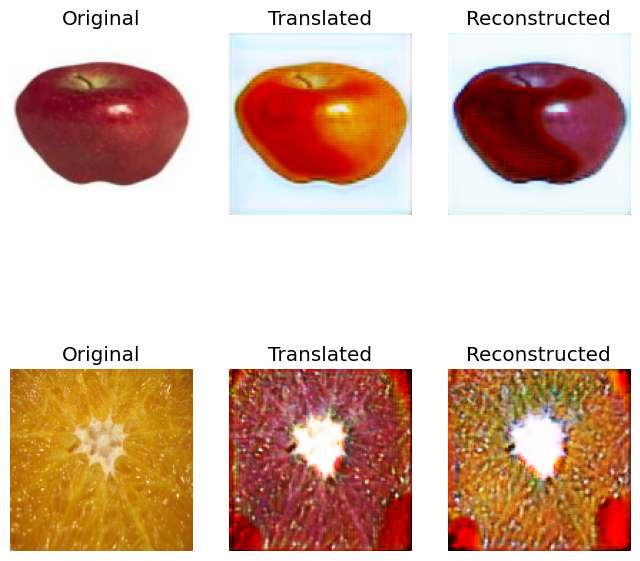

[Epoch 450/4] [Discriminator loss: 0.11836276389658451, accuracy: 87.5][Generator loss: 6.3492279052734375, Adversarial Loss: 0.7501511871814728, Reconstruction Loss: 0.22089321166276932, Identity Loss: 0.2111833393573761]
[Epoch 500/4] [Discriminator loss: 0.16726627061143517, accuracy: 78.515625][Generator loss: 6.829924583435059, Adversarial Loss: 0.8736393451690674, Reconstruction Loss: 0.23031365871429443, Identity Loss: 0.13403256237506866]
[Epoch 550/4] [Discriminator loss: 0.045796305406838655, accuracy: 98.046875][Generator loss: 7.963374614715576, Adversarial Loss: 0.8403571248054504, Reconstruction Loss: 0.2886439263820648, Identity Loss: 0.27533194422721863]
[Epoch 600/4] [Discriminator loss: 0.1584977973252535, accuracy: 76.171875][Generator loss: 7.009305477142334, Adversarial Loss: 0.7761237621307373, Reconstruction Loss: 0.24681171029806137, Identity Loss: 0.248623788356781]


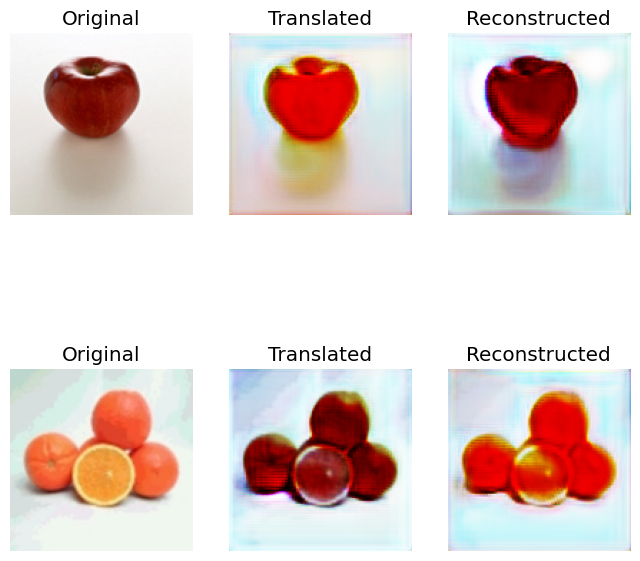

[Epoch 650/4] [Discriminator loss: 0.11782731860876083, accuracy: 87.109375][Generator loss: 5.932437896728516, Adversarial Loss: 0.675867348909378, Reconstruction Loss: 0.20603561401367188, Identity Loss: 0.2273644208908081]
[Epoch 700/4] [Discriminator loss: 0.265422435477376, accuracy: 73.046875][Generator loss: 7.693112373352051, Adversarial Loss: 0.8292478621006012, Reconstruction Loss: 0.27453887462615967, Identity Loss: 0.27255696058273315]
[Epoch 750/4] [Discriminator loss: 0.0826226407662034, accuracy: 90.625][Generator loss: 5.298091888427734, Adversarial Loss: 0.7830429375171661, Reconstruction Loss: 0.1690390706062317, Identity Loss: 0.12005750089883804]
[Epoch 800/4] [Discriminator loss: 0.35376705043017864, accuracy: 58.203125][Generator loss: 6.9082207679748535, Adversarial Loss: 0.5920415371656418, Reconstruction Loss: 0.25840386748313904, Identity Loss: 0.29592299461364746]


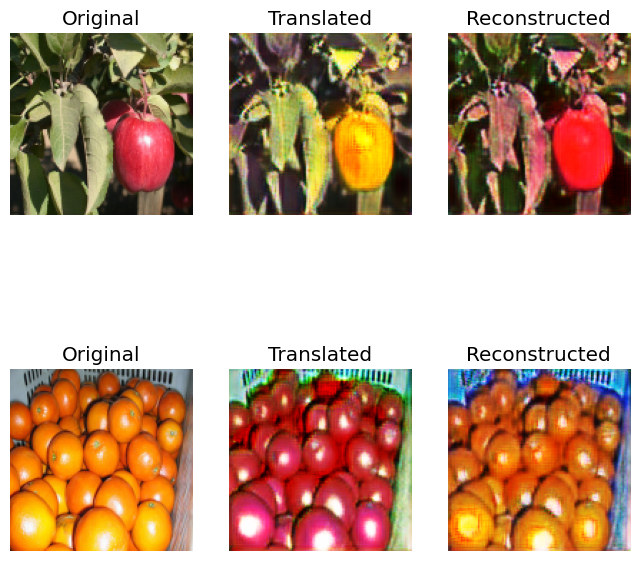

[Epoch 850/4] [Discriminator loss: 0.18945662304759026, accuracy: 76.5625][Generator loss: 5.106070518493652, Adversarial Loss: 0.7869102954864502, Reconstruction Loss: 0.1620284542441368, Identity Loss: 0.14696256816387177]
[Epoch 900/4] [Discriminator loss: 0.08021415024995804, accuracy: 93.75][Generator loss: 8.873753547668457, Adversarial Loss: 1.0198274552822113, Reconstruction Loss: 0.30971038341522217, Identity Loss: 0.24611428380012512]
[Epoch 950/4] [Discriminator loss: 0.16699449345469475, accuracy: 71.875][Generator loss: 6.559625625610352, Adversarial Loss: 0.7774041891098022, Reconstruction Loss: 0.22625024616718292, Identity Loss: 0.2459520846605301]
Epoch=5
[Epoch 0/5] [Discriminator loss: 0.09364475775510073, accuracy: 85.9375][Generator loss: 8.844773292541504, Adversarial Loss: 0.9704545140266418, Reconstruction Loss: 0.31118616461753845, Identity Loss: 0.40202218294143677]


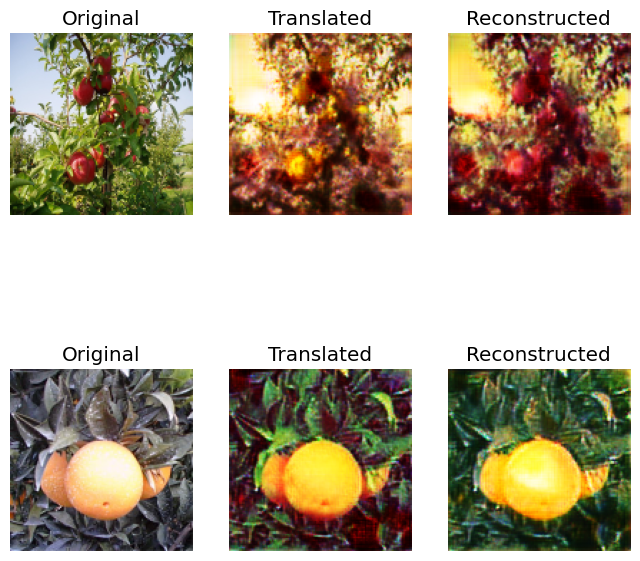

[Epoch 50/5] [Discriminator loss: 0.28337204083800316, accuracy: 78.125][Generator loss: 7.40976619720459, Adversarial Loss: 1.06968754529953, Reconstruction Loss: 0.2362004667520523, Identity Loss: 0.3632349967956543]
[Epoch 100/5] [Discriminator loss: 0.12916489504277706, accuracy: 84.375][Generator loss: 6.580769062042236, Adversarial Loss: 0.7415187358856201, Reconstruction Loss: 0.23199642449617386, Identity Loss: 0.26082807779312134]
[Epoch 150/5] [Discriminator loss: 0.09679874777793884, accuracy: 89.453125][Generator loss: 6.440289497375488, Adversarial Loss: 0.7163678705692291, Reconstruction Loss: 0.22577522695064545, Identity Loss: 0.28321021795272827]
[Epoch 200/5] [Discriminator loss: 0.5367115437984467, accuracy: 39.0625][Generator loss: 4.693078994750977, Adversarial Loss: 0.7549083232879639, Reconstruction Loss: 0.14178451895713806, Identity Loss: 0.18412688374519348]


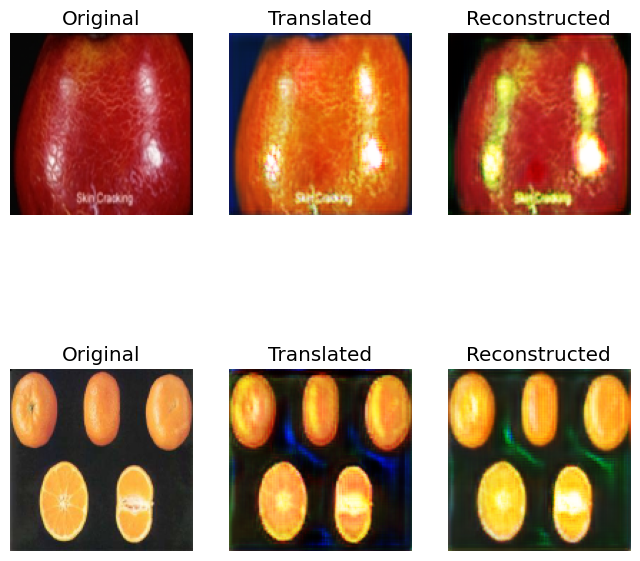

[Epoch 250/5] [Discriminator loss: 0.09739208780229092, accuracy: 91.015625][Generator loss: 6.503658294677734, Adversarial Loss: 0.7188798189163208, Reconstruction Loss: 0.22962021827697754, Identity Loss: 0.1762581467628479]
[Epoch 300/5] [Discriminator loss: 0.20664033899083734, accuracy: 78.515625][Generator loss: 6.896066665649414, Adversarial Loss: 0.953454315662384, Reconstruction Loss: 0.22387881577014923, Identity Loss: 0.23667487502098083]
[Epoch 350/5] [Discriminator loss: 0.06871710997074842, accuracy: 94.921875][Generator loss: 6.721291542053223, Adversarial Loss: 0.7836332023143768, Reconstruction Loss: 0.23054344952106476, Identity Loss: 0.2395952343940735]
[Epoch 400/5] [Discriminator loss: 0.09155446756631136, accuracy: 94.53125][Generator loss: 6.067723751068115, Adversarial Loss: 0.8377324938774109, Reconstruction Loss: 0.1992478147149086, Identity Loss: 0.18444016575813293]


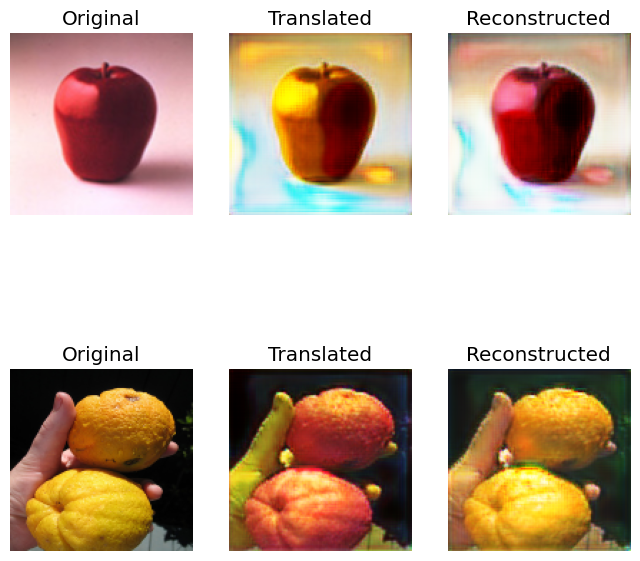

[Epoch 450/5] [Discriminator loss: 0.12312458828091621, accuracy: 89.453125][Generator loss: 4.930941581726074, Adversarial Loss: 0.7472352683544159, Reconstruction Loss: 0.1536988839507103, Identity Loss: 0.21236546337604523]
[Epoch 500/5] [Discriminator loss: 0.26677735429257154, accuracy: 61.71875][Generator loss: 7.936099529266357, Adversarial Loss: 0.7369353175163269, Reconstruction Loss: 0.29057710617780685, Identity Loss: 0.2716350555419922]
[Epoch 550/5] [Discriminator loss: 0.05341711454093456, accuracy: 97.65625][Generator loss: 6.143795013427734, Adversarial Loss: 0.8259151577949524, Reconstruction Loss: 0.2051885724067688, Identity Loss: 0.25259560346603394]
[Epoch 600/5] [Discriminator loss: 0.03872187249362469, accuracy: 97.65625][Generator loss: 7.466186046600342, Adversarial Loss: 0.8931776881217957, Reconstruction Loss: 0.2561630606651306, Identity Loss: 0.2670142650604248]


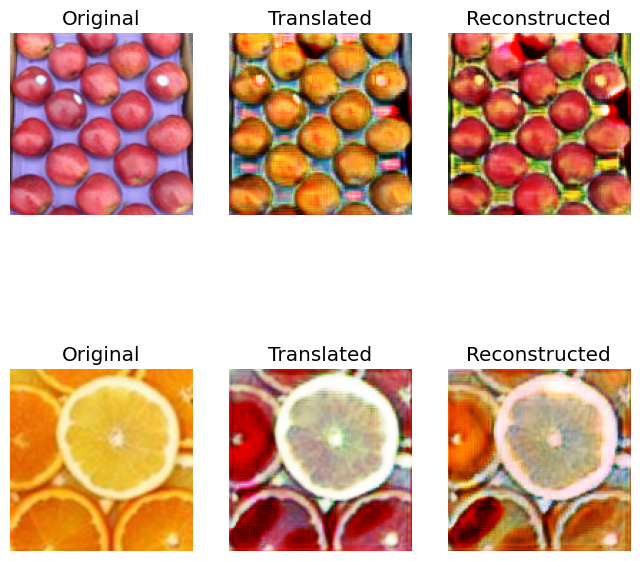

[Epoch 650/5] [Discriminator loss: 0.3286935221403837, accuracy: 63.28125][Generator loss: 5.789896011352539, Adversarial Loss: 0.6685175597667694, Reconstruction Loss: 0.2018900215625763, Identity Loss: 0.1833813637495041]
[Epoch 700/5] [Discriminator loss: 0.1119179055094719, accuracy: 90.234375][Generator loss: 6.293575286865234, Adversarial Loss: 0.8006496131420135, Reconstruction Loss: 0.2103366106748581, Identity Loss: 0.24950376152992249]
[Epoch 750/5] [Discriminator loss: 0.2099542487412691, accuracy: 71.875][Generator loss: 5.778006553649902, Adversarial Loss: 1.0578351616859436, Reconstruction Loss: 0.16720794141292572, Identity Loss: 0.1556326448917389]
[Epoch 800/5] [Discriminator loss: 0.12369006685912609, accuracy: 82.8125][Generator loss: 8.326120376586914, Adversarial Loss: 0.713652491569519, Reconstruction Loss: 0.31261445581912994, Identity Loss: 0.2549724578857422]


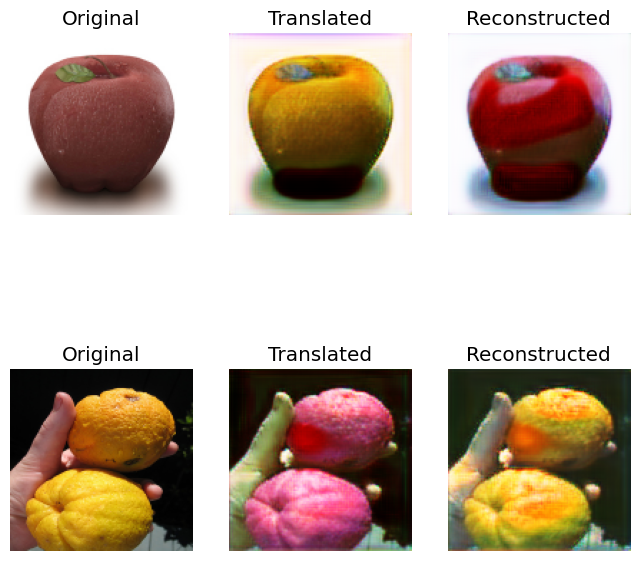

[Epoch 850/5] [Discriminator loss: 0.09574168780818582, accuracy: 90.234375][Generator loss: 7.22860860824585, Adversarial Loss: 0.9194295704364777, Reconstruction Loss: 0.2436264157295227, Identity Loss: 0.27084606885910034]
[Epoch 900/5] [Discriminator loss: 0.2067592591047287, accuracy: 67.96875][Generator loss: 6.020447731018066, Adversarial Loss: 0.7425186336040497, Reconstruction Loss: 0.20517931878566742, Identity Loss: 0.25369518995285034]
[Epoch 950/5] [Discriminator loss: 0.1781829558312893, accuracy: 75.390625][Generator loss: 5.151487827301025, Adversarial Loss: 0.6577062010765076, Reconstruction Loss: 0.17453277856111526, Identity Loss: 0.14966285228729248]
Epoch=6
[Epoch 0/6] [Discriminator loss: 0.22236873023211956, accuracy: 62.5][Generator loss: 6.196356296539307, Adversarial Loss: 0.5512811541557312, Reconstruction Loss: 0.2292502224445343, Identity Loss: 0.23584309220314026]


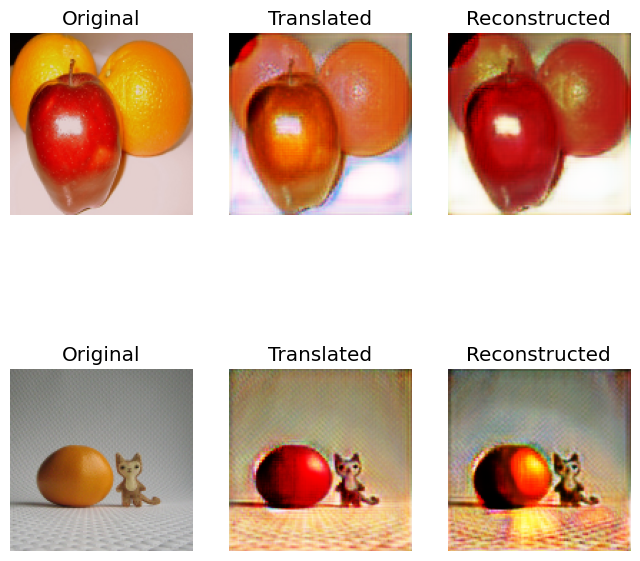

[Epoch 50/6] [Discriminator loss: 0.14090437069535255, accuracy: 83.203125][Generator loss: 7.999995708465576, Adversarial Loss: 0.6937838792800903, Reconstruction Loss: 0.30193793028593063, Identity Loss: 0.38816195726394653]
[Epoch 100/6] [Discriminator loss: 0.048776852898299694, accuracy: 96.875][Generator loss: 6.187727928161621, Adversarial Loss: 0.9488109350204468, Reconstruction Loss: 0.19279247522354126, Identity Loss: 0.2794899344444275]
[Epoch 150/6] [Discriminator loss: 0.06257781852036715, accuracy: 95.703125][Generator loss: 6.3573408126831055, Adversarial Loss: 0.9199215173721313, Reconstruction Loss: 0.20262391865253448, Identity Loss: 0.2379542589187622]
[Epoch 200/6] [Discriminator loss: 0.2420288184657693, accuracy: 71.875][Generator loss: 5.483155727386475, Adversarial Loss: 0.7422599941492081, Reconstruction Loss: 0.18101049959659576, Identity Loss: 0.14681953191757202]


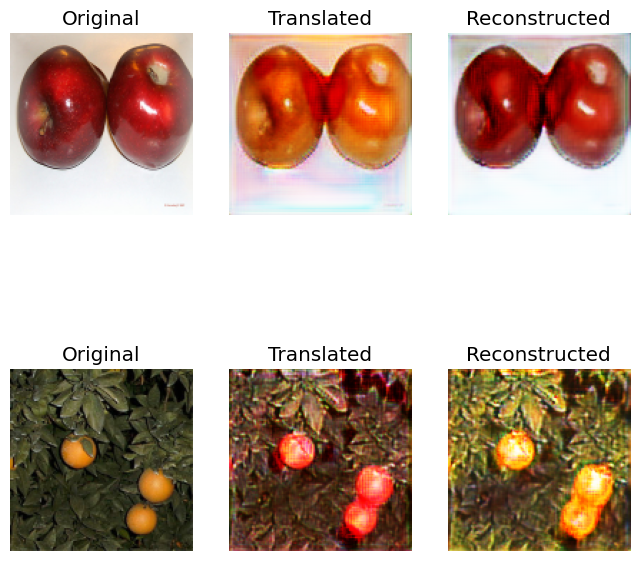

[Epoch 250/6] [Discriminator loss: 0.38249216694384813, accuracy: 67.578125][Generator loss: 5.867185115814209, Adversarial Loss: 0.9054711163043976, Reconstruction Loss: 0.18495136499404907, Identity Loss: 0.20925557613372803]
[Epoch 300/6] [Discriminator loss: 0.17000094428658485, accuracy: 77.734375][Generator loss: 6.287752151489258, Adversarial Loss: 0.9723173975944519, Reconstruction Loss: 0.19597455859184265, Identity Loss: 0.1955757737159729]
[Epoch 350/6] [Discriminator loss: 0.13342208974063396, accuracy: 79.6875][Generator loss: 7.553342819213867, Adversarial Loss: 0.7441555261611938, Reconstruction Loss: 0.2770112678408623, Identity Loss: 0.2898440957069397]
[Epoch 400/6] [Discriminator loss: 0.29323489870876074, accuracy: 64.84375][Generator loss: 5.1643571853637695, Adversarial Loss: 0.7160795629024506, Reconstruction Loss: 0.16647685319185257, Identity Loss: 0.14241164922714233]


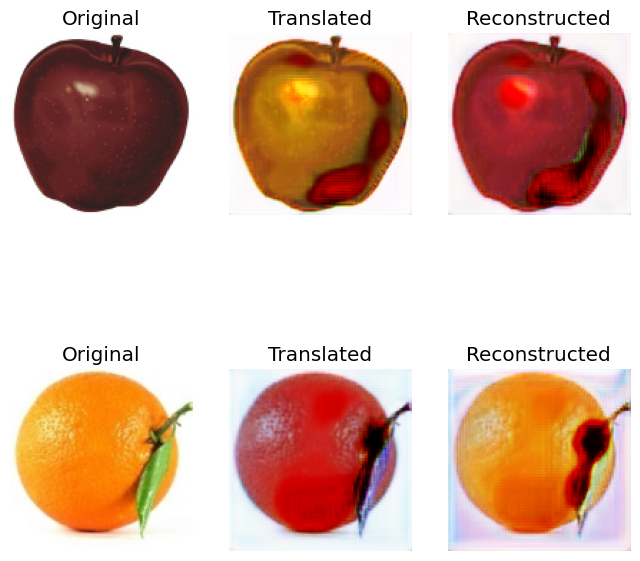

[Epoch 450/6] [Discriminator loss: 0.10677474271506071, accuracy: 94.53125][Generator loss: 7.039989948272705, Adversarial Loss: 0.9416321516036987, Reconstruction Loss: 0.23229970782995224, Identity Loss: 0.2250816524028778]
[Epoch 500/6] [Discriminator loss: 0.08956620562821627, accuracy: 92.1875][Generator loss: 5.842796325683594, Adversarial Loss: 0.806242823600769, Reconstruction Loss: 0.1897132322192192, Identity Loss: 0.22134435176849365]
[Epoch 550/6] [Discriminator loss: 0.10119925159960985, accuracy: 94.921875][Generator loss: 6.620162010192871, Adversarial Loss: 0.852725476026535, Reconstruction Loss: 0.22384434938430786, Identity Loss: 0.22486504912376404]
[Epoch 600/6] [Discriminator loss: 0.16236867383122444, accuracy: 75.78125][Generator loss: 5.0367608070373535, Adversarial Loss: 0.7059274017810822, Reconstruction Loss: 0.15808603167533875, Identity Loss: 0.2028735727071762]


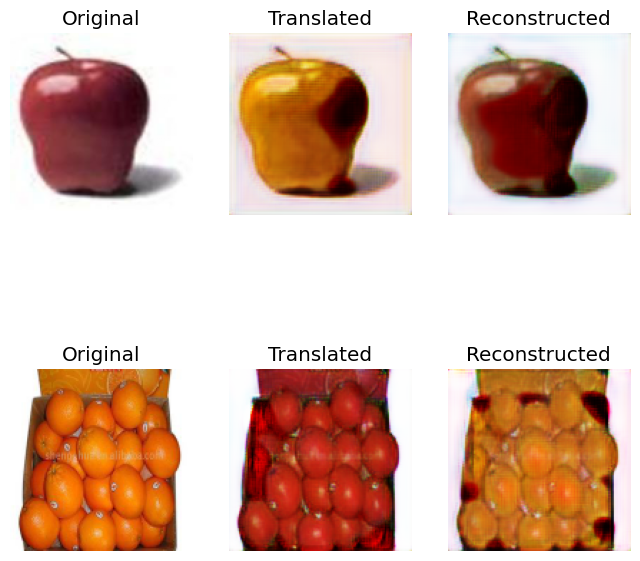

[Epoch 650/6] [Discriminator loss: 0.06738015357404947, accuracy: 94.140625][Generator loss: 6.999001502990723, Adversarial Loss: 1.0097147524356842, Reconstruction Loss: 0.22547416388988495, Identity Loss: 0.23578670620918274]
[Epoch 700/6] [Discriminator loss: 0.15788319427520037, accuracy: 82.03125][Generator loss: 6.1895670890808105, Adversarial Loss: 0.8982604146003723, Reconstruction Loss: 0.19619140028953552, Identity Loss: 0.2562507092952728]
[Epoch 750/6] [Discriminator loss: 0.1606962475925684, accuracy: 80.46875][Generator loss: 6.114828109741211, Adversarial Loss: 0.759521484375, Reconstruction Loss: 0.21053947508335114, Identity Loss: 0.1543971747159958]
[Epoch 800/6] [Discriminator loss: 0.18280655331909657, accuracy: 74.609375][Generator loss: 6.5502610206604, Adversarial Loss: 1.0396901667118073, Reconstruction Loss: 0.20689059048891068, Identity Loss: 0.13352879881858826]


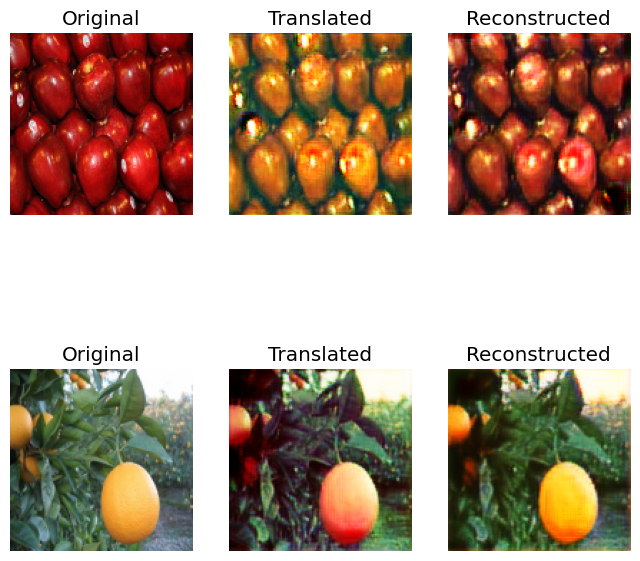

[Epoch 850/6] [Discriminator loss: 0.06323861563578248, accuracy: 93.75][Generator loss: 5.875089645385742, Adversarial Loss: 0.8525695204734802, Reconstruction Loss: 0.18494419753551483, Identity Loss: 0.18778783082962036]
[Epoch 900/6] [Discriminator loss: 0.11071963980793953, accuracy: 86.71875][Generator loss: 7.253523349761963, Adversarial Loss: 0.6222899556159973, Reconstruction Loss: 0.2720404714345932, Identity Loss: 0.2062113881111145]
[Epoch 950/6] [Discriminator loss: 0.3221065979450941, accuracy: 48.828125][Generator loss: 5.876184463500977, Adversarial Loss: 0.765158161520958, Reconstruction Loss: 0.19440877437591553, Identity Loss: 0.2030666172504425]
Epoch=7
[Epoch 0/7] [Discriminator loss: 0.15966289583593607, accuracy: 80.859375][Generator loss: 5.267601013183594, Adversarial Loss: 0.7782410979270935, Reconstruction Loss: 0.16064851731061935, Identity Loss: 0.22035029530525208]


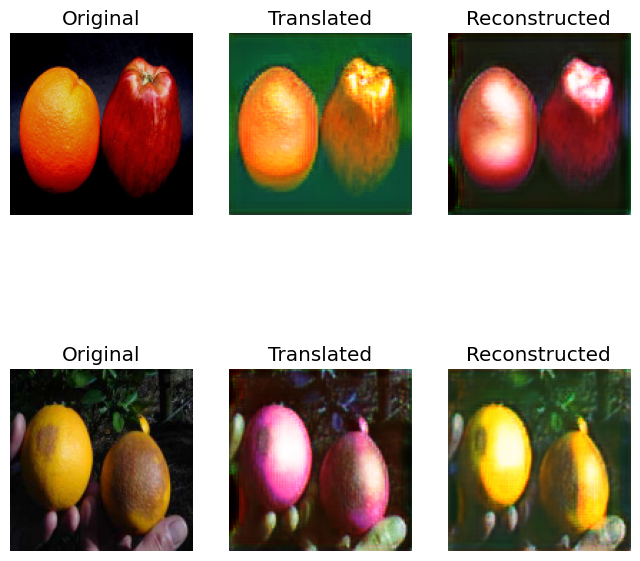

[Epoch 50/7] [Discriminator loss: 0.067313845269382, accuracy: 96.875][Generator loss: 6.701138019561768, Adversarial Loss: 0.9265971183776855, Reconstruction Loss: 0.21983195841312408, Identity Loss: 0.22148443758487701]
[Epoch 100/7] [Discriminator loss: 0.045561947859823704, accuracy: 100.0][Generator loss: 8.473688125610352, Adversarial Loss: 1.0804117918014526, Reconstruction Loss: 0.2846643626689911, Identity Loss: 0.38598692417144775]
[Epoch 150/7] [Discriminator loss: 0.1029909998178482, accuracy: 88.28125][Generator loss: 5.882570743560791, Adversarial Loss: 0.7956647276878357, Reconstruction Loss: 0.19295625388622284, Identity Loss: 0.27309781312942505]
[Epoch 200/7] [Discriminator loss: 0.24528713431209326, accuracy: 75.390625][Generator loss: 5.361364841461182, Adversarial Loss: 0.7827610075473785, Reconstruction Loss: 0.17293502390384674, Identity Loss: 0.13546277582645416]


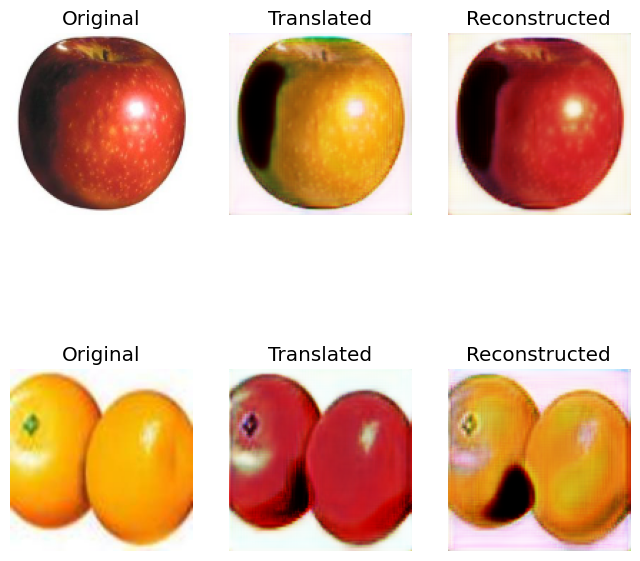

[Epoch 250/7] [Discriminator loss: 0.13274094834923744, accuracy: 83.59375][Generator loss: 7.193943023681641, Adversarial Loss: 0.7377012968063354, Reconstruction Loss: 0.2600997984409332, Identity Loss: 0.1627231240272522]
[Epoch 300/7] [Discriminator loss: 0.2383164456114173, accuracy: 82.8125][Generator loss: 6.307490348815918, Adversarial Loss: 0.936108410358429, Reconstruction Loss: 0.1982840895652771, Identity Loss: 0.1936347782611847]
[Epoch 350/7] [Discriminator loss: 0.062457174994051456, accuracy: 96.875][Generator loss: 5.64047908782959, Adversarial Loss: 0.8741258084774017, Reconstruction Loss: 0.1756821870803833, Identity Loss: 0.1678307056427002]
[Epoch 400/7] [Discriminator loss: 0.2698415871709585, accuracy: 73.046875][Generator loss: 6.962111473083496, Adversarial Loss: 0.5220003873109818, Reconstruction Loss: 0.26173630356788635, Identity Loss: 0.4559978246688843]


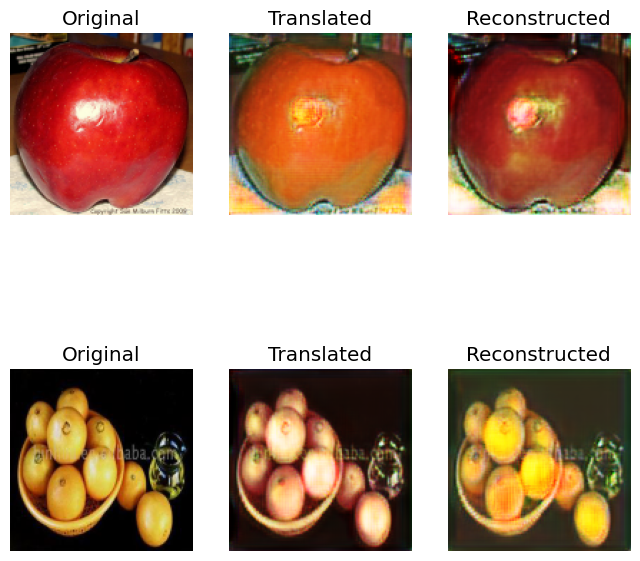

[Epoch 450/7] [Discriminator loss: 0.13388729002326727, accuracy: 84.765625][Generator loss: 5.952929496765137, Adversarial Loss: 0.9046100974082947, Reconstruction Loss: 0.1846761405467987, Identity Loss: 0.25970226526260376]
[Epoch 500/7] [Discriminator loss: 0.15275926422327757, accuracy: 88.28125][Generator loss: 5.77713680267334, Adversarial Loss: 0.8024841547012329, Reconstruction Loss: 0.18861937522888184, Identity Loss: 0.2005508542060852]
[Epoch 550/7] [Discriminator loss: 0.11593782715499401, accuracy: 83.203125][Generator loss: 6.390840530395508, Adversarial Loss: 0.8609122335910797, Reconstruction Loss: 0.21085534989833832, Identity Loss: 0.18413105607032776]
[Epoch 600/7] [Discriminator loss: 0.08890264853835106, accuracy: 89.453125][Generator loss: 7.143990516662598, Adversarial Loss: 0.8516988754272461, Reconstruction Loss: 0.2500503659248352, Identity Loss: 0.20933058857917786]


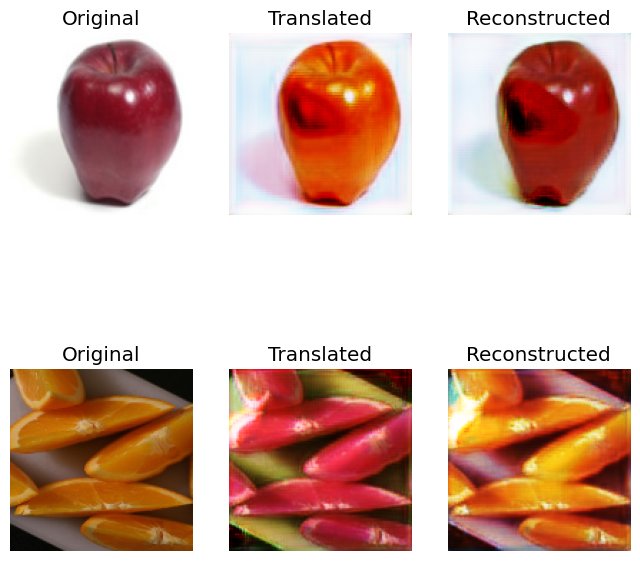

[Epoch 650/7] [Discriminator loss: 0.08179347403347492, accuracy: 96.09375][Generator loss: 6.545899868011475, Adversarial Loss: 0.9754344820976257, Reconstruction Loss: 0.2074904814362526, Identity Loss: 0.1937706619501114]
[Epoch 700/7] [Discriminator loss: 0.07418470457196236, accuracy: 94.140625][Generator loss: 5.980405330657959, Adversarial Loss: 0.8293657302856445, Reconstruction Loss: 0.1983877569437027, Identity Loss: 0.16021205484867096]
[Epoch 750/7] [Discriminator loss: 0.17406193912029266, accuracy: 76.171875][Generator loss: 6.569761753082275, Adversarial Loss: 0.8063871264457703, Reconstruction Loss: 0.2264084368944168, Identity Loss: 0.16437426209449768]
[Epoch 800/7] [Discriminator loss: 0.25511566177010536, accuracy: 58.984375][Generator loss: 4.549043655395508, Adversarial Loss: 0.5911222398281097, Reconstruction Loss: 0.1508539319038391, Identity Loss: 0.15208788216114044]


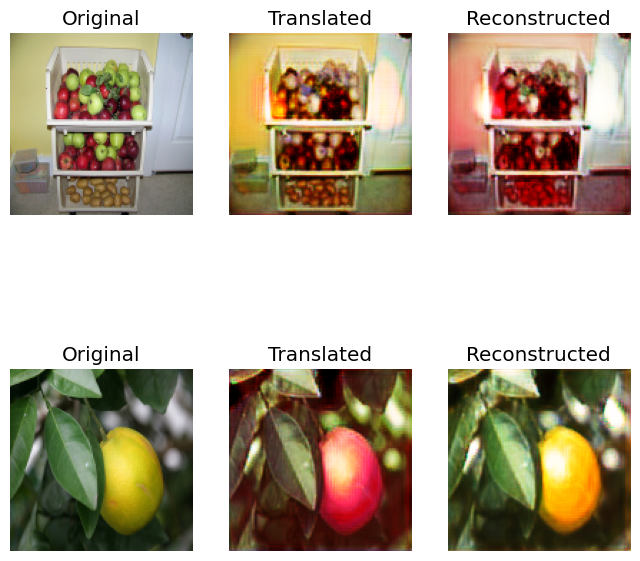

[Epoch 850/7] [Discriminator loss: 0.10564841236919165, accuracy: 84.765625][Generator loss: 5.2032647132873535, Adversarial Loss: 0.7685584723949432, Reconstruction Loss: 0.16595234349370003, Identity Loss: 0.2325357049703598]
[Epoch 900/7] [Discriminator loss: 0.14007172174751759, accuracy: 84.765625][Generator loss: 6.320322513580322, Adversarial Loss: 0.9698344469070435, Reconstruction Loss: 0.197586290538311, Identity Loss: 0.22467917203903198]
[Epoch 950/7] [Discriminator loss: 0.1296156970784068, accuracy: 82.8125][Generator loss: 5.17648983001709, Adversarial Loss: 0.8596084415912628, Reconstruction Loss: 0.15690800547599792, Identity Loss: 0.15158158540725708]
Epoch=8
[Epoch 0/8] [Discriminator loss: 0.21500584855675697, accuracy: 82.8125][Generator loss: 8.225716590881348, Adversarial Loss: 0.9886313378810883, Reconstruction Loss: 0.2848082482814789, Identity Loss: 0.2830377519130707]


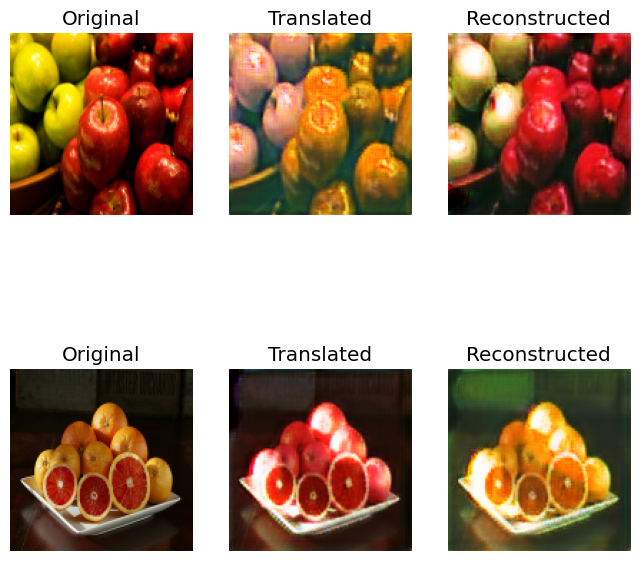

[Epoch 50/8] [Discriminator loss: 0.10100180096924305, accuracy: 92.1875][Generator loss: 5.775390625, Adversarial Loss: 0.8905084133148193, Reconstruction Loss: 0.17932209372520447, Identity Loss: 0.17357070744037628]
[Epoch 100/8] [Discriminator loss: 0.039567504078149796, accuracy: 100.0][Generator loss: 6.334481716156006, Adversarial Loss: 0.9793076813220978, Reconstruction Loss: 0.19617204368114471, Identity Loss: 0.2608790695667267]
[Epoch 150/8] [Discriminator loss: 0.21515253139659762, accuracy: 73.828125][Generator loss: 5.961941719055176, Adversarial Loss: 0.9356535077095032, Reconstruction Loss: 0.1887172982096672, Identity Loss: 0.14767125248908997]
[Epoch 200/8] [Discriminator loss: 0.0488570062443614, accuracy: 97.65625][Generator loss: 4.54266881942749, Adversarial Loss: 0.9214318990707397, Reconstruction Loss: 0.11969491839408875, Identity Loss: 0.1351500004529953]


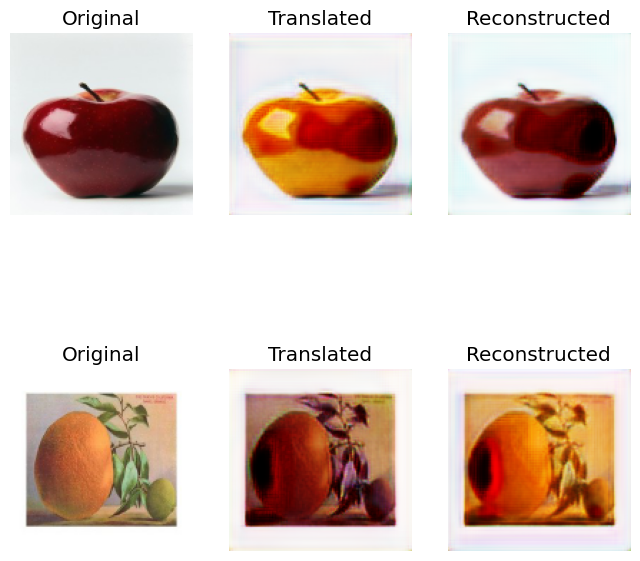

[Epoch 250/8] [Discriminator loss: 0.0673229075036943, accuracy: 96.09375][Generator loss: 5.7658185958862305, Adversarial Loss: 0.9121157824993134, Reconstruction Loss: 0.17772150039672852, Identity Loss: 0.20598626136779785]
[Epoch 300/8] [Discriminator loss: 0.24849102180451155, accuracy: 67.578125][Generator loss: 6.861460208892822, Adversarial Loss: 1.0056471824645996, Reconstruction Loss: 0.21616460382938385, Identity Loss: 0.21922606229782104]
[Epoch 350/8] [Discriminator loss: 0.30653708428144455, accuracy: 60.9375][Generator loss: 5.633898735046387, Adversarial Loss: 0.751316487789154, Reconstruction Loss: 0.18228232860565186, Identity Loss: 0.28187990188598633]
[Epoch 400/8] [Discriminator loss: 0.5798671618103981, accuracy: 32.8125][Generator loss: 3.9617319107055664, Adversarial Loss: 0.7237012982368469, Reconstruction Loss: 0.11318784207105637, Identity Loss: 0.12607204914093018]


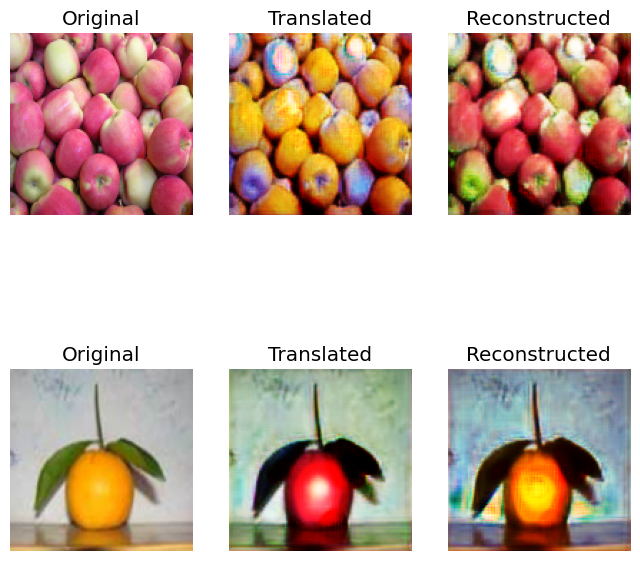

[Epoch 450/8] [Discriminator loss: 0.12398876808583736, accuracy: 87.5][Generator loss: 6.199543476104736, Adversarial Loss: 0.7940231561660767, Reconstruction Loss: 0.21095037460327148, Identity Loss: 0.23226943612098694]
[Epoch 500/8] [Discriminator loss: 0.23407509177923203, accuracy: 75.0][Generator loss: 7.598193645477295, Adversarial Loss: 0.6758199334144592, Reconstruction Loss: 0.2847079634666443, Identity Loss: 0.22132080793380737]
[Epoch 550/8] [Discriminator loss: 0.053227086551487446, accuracy: 95.703125][Generator loss: 6.37757682800293, Adversarial Loss: 0.9613749980926514, Reconstruction Loss: 0.2006901279091835, Identity Loss: 0.2205934226512909]
[Epoch 600/8] [Discriminator loss: 0.22743941470980644, accuracy: 64.0625][Generator loss: 5.518132209777832, Adversarial Loss: 0.6916282176971436, Reconstruction Loss: 0.1875993013381958, Identity Loss: 0.18046638369560242]


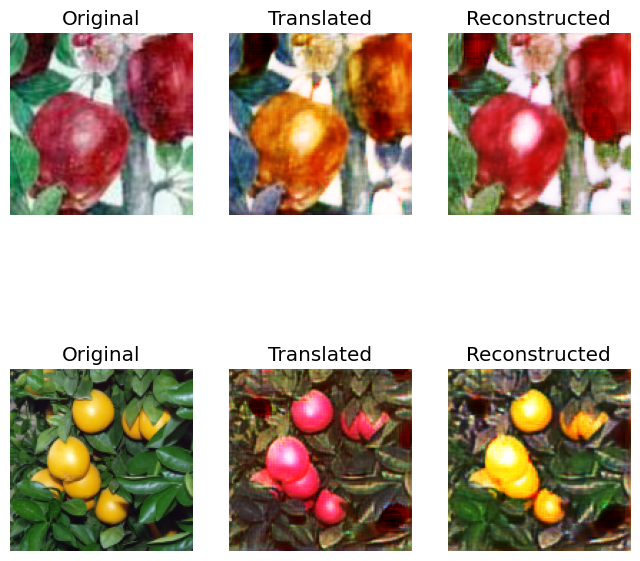

[Epoch 650/8] [Discriminator loss: 0.13648722413927317, accuracy: 86.328125][Generator loss: 4.927768707275391, Adversarial Loss: 0.925106406211853, Reconstruction Loss: 0.1385958418250084, Identity Loss: 0.1617896407842636]
[Epoch 700/8] [Discriminator loss: 0.175277566537261, accuracy: 77.734375][Generator loss: 5.741515159606934, Adversarial Loss: 0.9069566130638123, Reconstruction Loss: 0.17581314593553543, Identity Loss: 0.18081635236740112]
[Epoch 750/8] [Discriminator loss: 0.2016085097566247, accuracy: 71.875][Generator loss: 6.359334468841553, Adversarial Loss: 1.015743613243103, Reconstruction Loss: 0.1975853368639946, Identity Loss: 0.1756478101015091]
[Epoch 800/8] [Discriminator loss: 0.06997103057801723, accuracy: 98.828125][Generator loss: 6.21158504486084, Adversarial Loss: 0.7942620813846588, Reconstruction Loss: 0.21023617684841156, Identity Loss: 0.22551505267620087]


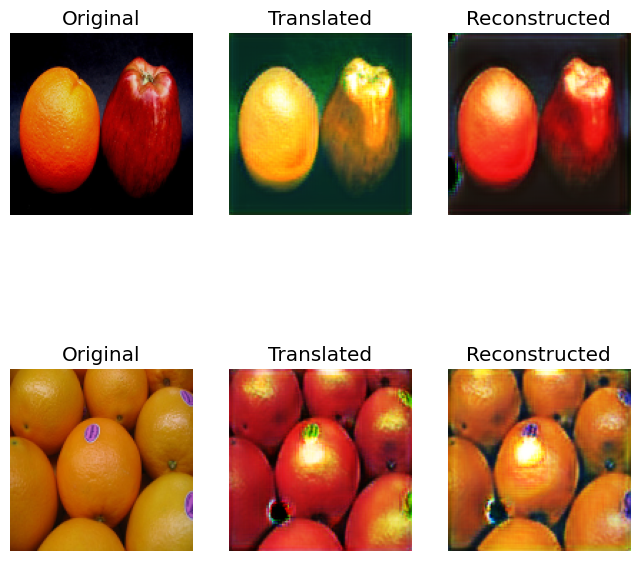

[Epoch 850/8] [Discriminator loss: 0.2046600915491581, accuracy: 71.09375][Generator loss: 5.775712966918945, Adversarial Loss: 1.0337185859680176, Reconstruction Loss: 0.17030418664216995, Identity Loss: 0.09867959469556808]
[Epoch 900/8] [Discriminator loss: 0.04108834592625499, accuracy: 97.65625][Generator loss: 5.9497833251953125, Adversarial Loss: 0.9301014840602875, Reconstruction Loss: 0.18162455409765244, Identity Loss: 0.22975021600723267]
[Epoch 950/8] [Discriminator loss: 0.25950120761990547, accuracy: 61.71875][Generator loss: 5.911324501037598, Adversarial Loss: 0.7043960392475128, Reconstruction Loss: 0.1985710710287094, Identity Loss: 0.35669466853141785]
Epoch=9
[Epoch 0/9] [Discriminator loss: 0.3055608691647649, accuracy: 64.84375][Generator loss: 5.443969249725342, Adversarial Loss: 0.6084105670452118, Reconstruction Loss: 0.18909554928541183, Identity Loss: 0.225333109498024]


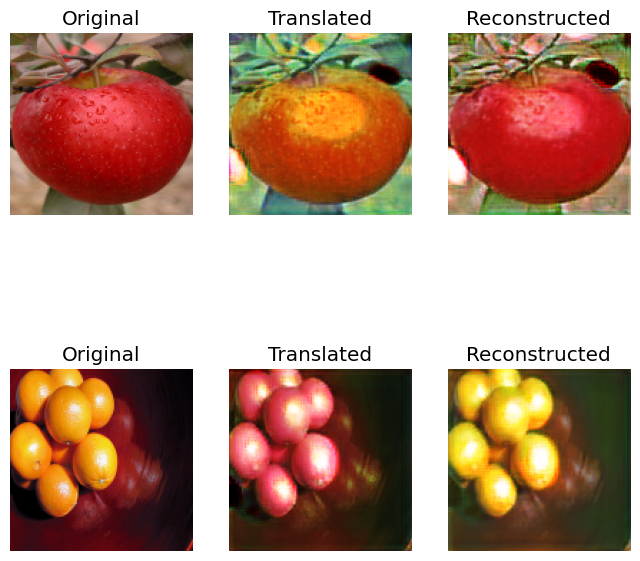

[Epoch 50/9] [Discriminator loss: 0.08888645470142365, accuracy: 90.625][Generator loss: 6.652942657470703, Adversarial Loss: 0.868000864982605, Reconstruction Loss: 0.22455211728811264, Identity Loss: 0.27458399534225464]
[Epoch 100/9] [Discriminator loss: 0.06806483678519726, accuracy: 95.703125][Generator loss: 5.97314453125, Adversarial Loss: 0.9524841904640198, Reconstruction Loss: 0.1875155344605446, Identity Loss: 0.131058931350708]
[Epoch 150/9] [Discriminator loss: 0.10442674439400434, accuracy: 88.28125][Generator loss: 5.564962387084961, Adversarial Loss: 0.6630686819553375, Reconstruction Loss: 0.1900544837117195, Identity Loss: 0.20848412811756134]
[Epoch 200/9] [Discriminator loss: 0.072255918988958, accuracy: 94.53125][Generator loss: 5.171809196472168, Adversarial Loss: 0.9484961330890656, Reconstruction Loss: 0.14417636394500732, Identity Loss: 0.18558672070503235]


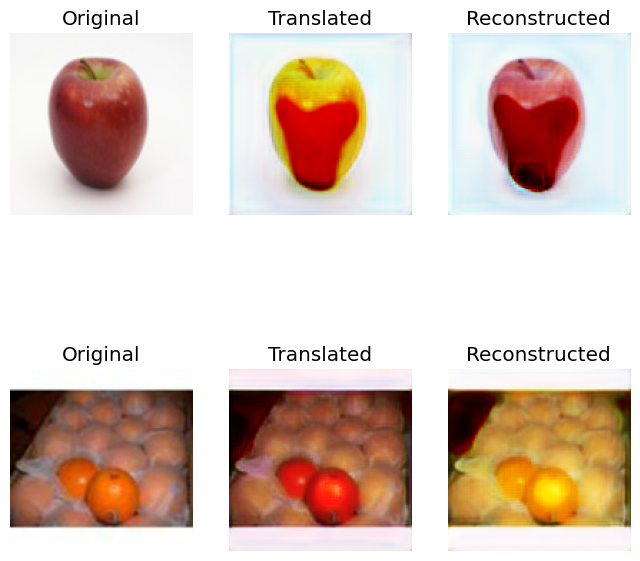

[Epoch 250/9] [Discriminator loss: 0.08697239682078362, accuracy: 92.1875][Generator loss: 5.179658889770508, Adversarial Loss: 0.8595708012580872, Reconstruction Loss: 0.15380436182022095, Identity Loss: 0.18389615416526794]
[Epoch 300/9] [Discriminator loss: 0.17884267400950193, accuracy: 75.78125][Generator loss: 6.154386043548584, Adversarial Loss: 0.8774022459983826, Reconstruction Loss: 0.19866173714399338, Identity Loss: 0.23485079407691956]
[Epoch 350/9] [Discriminator loss: 0.30938225984573364, accuracy: 67.1875][Generator loss: 5.191917419433594, Adversarial Loss: 0.7985647916793823, Reconstruction Loss: 0.16677884757518768, Identity Loss: 0.08266694843769073]
[Epoch 400/9] [Discriminator loss: 0.06553944014012814, accuracy: 95.703125][Generator loss: 7.251053810119629, Adversarial Loss: 0.8258912265300751, Reconstruction Loss: 0.25398464500904083, Identity Loss: 0.1673213243484497]


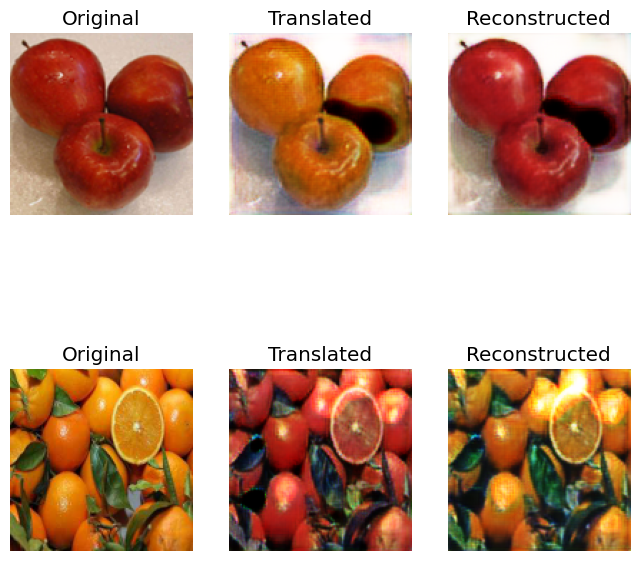

[Epoch 450/9] [Discriminator loss: 0.04969147127121687, accuracy: 98.828125][Generator loss: 7.80262565612793, Adversarial Loss: 0.8757948875427246, Reconstruction Loss: 0.27351781725883484, Identity Loss: 0.26497554779052734]
[Epoch 500/9] [Discriminator loss: 0.09196284972131252, accuracy: 89.0625][Generator loss: 6.180265426635742, Adversarial Loss: 0.8221918046474457, Reconstruction Loss: 0.20681321620941162, Identity Loss: 0.09097972512245178]
[Epoch 550/9] [Discriminator loss: 0.0671623470261693, accuracy: 97.265625][Generator loss: 6.913739204406738, Adversarial Loss: 0.9409058392047882, Reconstruction Loss: 0.22613469511270523, Identity Loss: 0.37761685252189636]
[Epoch 600/9] [Discriminator loss: 0.09462862089276314, accuracy: 89.453125][Generator loss: 5.617611408233643, Adversarial Loss: 0.8924441039562225, Reconstruction Loss: 0.17421304434537888, Identity Loss: 0.17454271018505096]


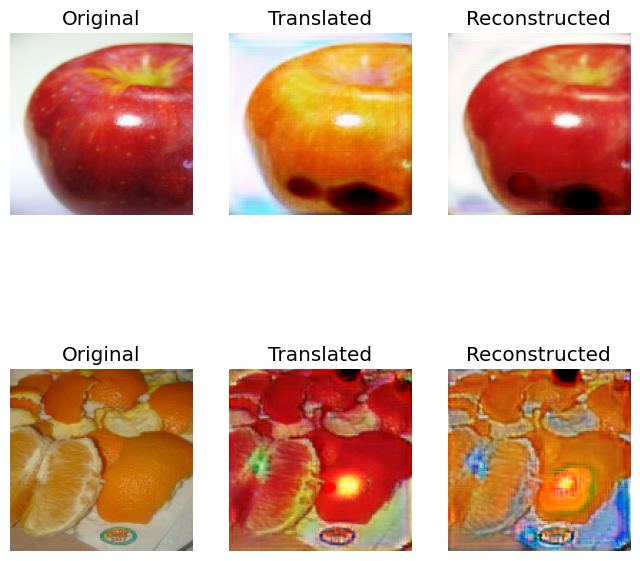

[Epoch 650/9] [Discriminator loss: 0.0627900892868638, accuracy: 96.875][Generator loss: 6.00394344329834, Adversarial Loss: 0.8835380673408508, Reconstruction Loss: 0.19038188457489014, Identity Loss: 0.15298959612846375]
[Epoch 700/9] [Discriminator loss: 0.10713063832372427, accuracy: 90.625][Generator loss: 5.651056289672852, Adversarial Loss: 0.7379858493804932, Reconstruction Loss: 0.18972577899694443, Identity Loss: 0.1992790699005127]
[Epoch 750/9] [Discriminator loss: 0.17145436257123947, accuracy: 72.265625][Generator loss: 5.015285968780518, Adversarial Loss: 0.8347752392292023, Reconstruction Loss: 0.15140670537948608, Identity Loss: 0.19225195050239563]
[Epoch 800/9] [Discriminator loss: 0.15249640680849552, accuracy: 84.375][Generator loss: 5.76224422454834, Adversarial Loss: 1.0136449337005615, Reconstruction Loss: 0.16840242594480515, Identity Loss: 0.1554570198059082]


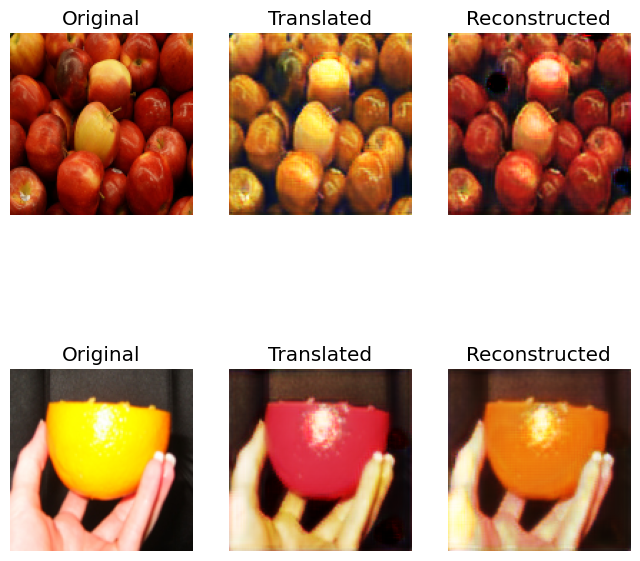

[Epoch 850/9] [Discriminator loss: 0.27907323092222214, accuracy: 63.671875][Generator loss: 6.459874153137207, Adversarial Loss: 0.7292619943618774, Reconstruction Loss: 0.22616168856620789, Identity Loss: 0.30304157733917236]
[Epoch 900/9] [Discriminator loss: 0.04730100370943546, accuracy: 97.65625][Generator loss: 6.390692710876465, Adversarial Loss: 0.9564484357833862, Reconstruction Loss: 0.2034071832895279, Identity Loss: 0.13735616207122803]
[Epoch 950/9] [Discriminator loss: 0.20804458111524582, accuracy: 69.53125][Generator loss: 4.70046329498291, Adversarial Loss: 1.0216511487960815, Reconstruction Loss: 0.11874106526374817, Identity Loss: 0.1399136483669281]
Epoch=10
[Epoch 0/10] [Discriminator loss: 0.08625328680500388, accuracy: 92.96875][Generator loss: 5.435548782348633, Adversarial Loss: 0.964708685874939, Reconstruction Loss: 0.15702596306800842, Identity Loss: 0.1661628782749176]


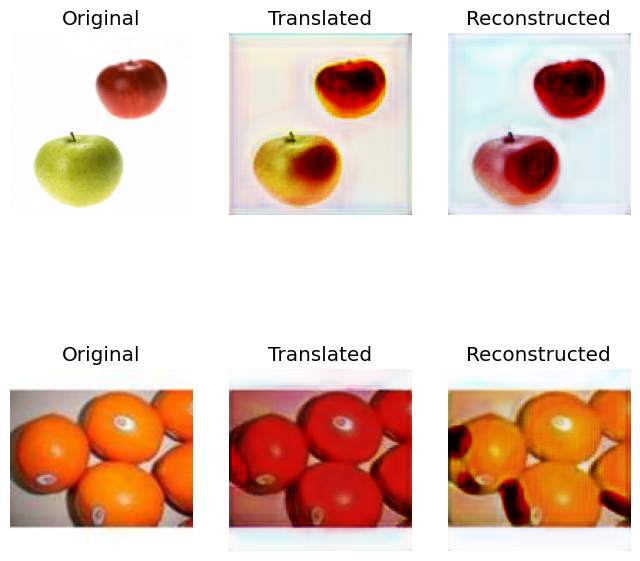

[Epoch 50/10] [Discriminator loss: 0.0850517163053155, accuracy: 89.84375][Generator loss: 5.4482421875, Adversarial Loss: 0.9182336628437042, Reconstruction Loss: 0.1627032607793808, Identity Loss: 0.17241761088371277]
[Epoch 100/10] [Discriminator loss: 0.04081284627318382, accuracy: 99.609375][Generator loss: 9.50716781616211, Adversarial Loss: 0.9692384898662567, Reconstruction Loss: 0.3433585613965988, Identity Loss: 0.4907766580581665]
[Epoch 150/10] [Discriminator loss: 0.1058562621474266, accuracy: 87.5][Generator loss: 5.006756782531738, Adversarial Loss: 1.0031869113445282, Reconstruction Loss: 0.13519446551799774, Identity Loss: 0.11656618863344193]
[Epoch 200/10] [Discriminator loss: 0.03735612751916051, accuracy: 100.0][Generator loss: 4.692734718322754, Adversarial Loss: 1.0215627551078796, Reconstruction Loss: 0.11892259865999222, Identity Loss: 0.13018831610679626]


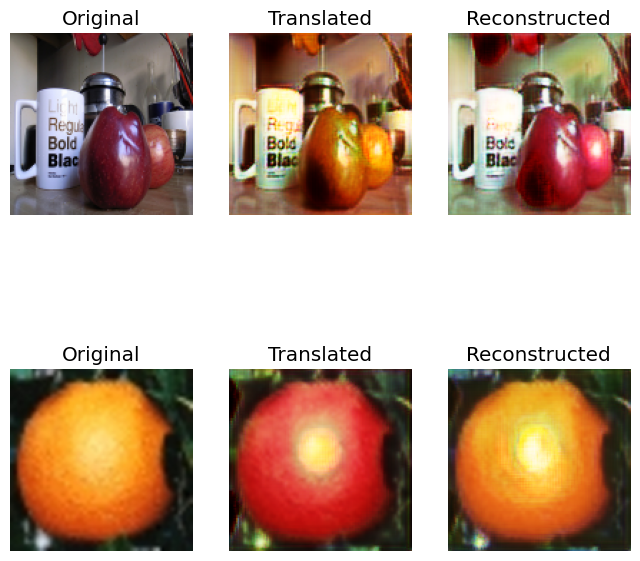

[Epoch 250/10] [Discriminator loss: 0.02829884667880833, accuracy: 100.0][Generator loss: 6.111964225769043, Adversarial Loss: 0.9376927018165588, Reconstruction Loss: 0.19131489843130112, Identity Loss: 0.19529467821121216]
[Epoch 300/10] [Discriminator loss: 0.25469521060585976, accuracy: 66.40625][Generator loss: 5.97104549407959, Adversarial Loss: 0.8497155010700226, Reconstruction Loss: 0.195587620139122, Identity Loss: 0.19777074456214905]
[Epoch 350/10] [Discriminator loss: 0.18836843082681298, accuracy: 66.015625][Generator loss: 5.936276435852051, Adversarial Loss: 0.8196350336074829, Reconstruction Loss: 0.19553305208683014, Identity Loss: 0.18961572647094727]
[Epoch 400/10] [Discriminator loss: 0.055233918596059084, accuracy: 97.265625][Generator loss: 5.744969367980957, Adversarial Loss: 0.9198048412799835, Reconstruction Loss: 0.17883217334747314, Identity Loss: 0.13524574041366577]


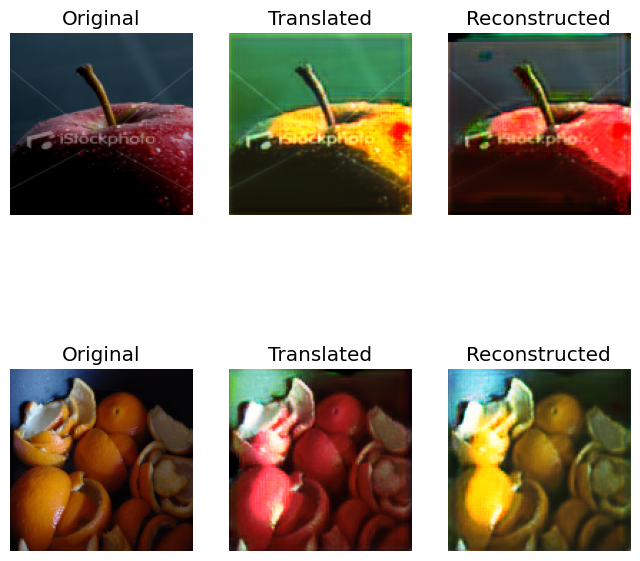

[Epoch 450/10] [Discriminator loss: 0.044667703565210104, accuracy: 100.0][Generator loss: 6.443103790283203, Adversarial Loss: 0.9312130808830261, Reconstruction Loss: 0.20883340388536453, Identity Loss: 0.18333593010902405]
[Epoch 500/10] [Discriminator loss: 0.2563573564402759, accuracy: 56.25][Generator loss: 4.5614237785339355, Adversarial Loss: 0.6852752268314362, Reconstruction Loss: 0.142740149050951, Identity Loss: 0.14223232865333557]
[Epoch 550/10] [Discriminator loss: 0.3427125168964267, accuracy: 57.421875][Generator loss: 5.42388916015625, Adversarial Loss: 0.5828742384910583, Reconstruction Loss: 0.1938999593257904, Identity Loss: 0.20291632413864136]
[Epoch 600/10] [Discriminator loss: 0.18556089978665113, accuracy: 73.4375][Generator loss: 5.078718185424805, Adversarial Loss: 0.7363460063934326, Reconstruction Loss: 0.15919195860624313, Identity Loss: 0.1632508635520935]


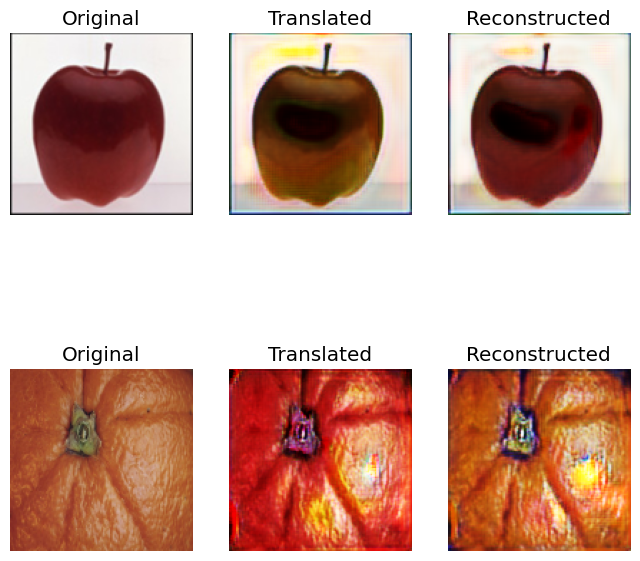

[Epoch 650/10] [Discriminator loss: 0.03819665592163801, accuracy: 98.828125][Generator loss: 6.5669426918029785, Adversarial Loss: 0.9251546859741211, Reconstruction Loss: 0.21477003395557404, Identity Loss: 0.22562918066978455]
[Epoch 700/10] [Discriminator loss: 0.08293827762827277, accuracy: 86.71875][Generator loss: 5.76456356048584, Adversarial Loss: 0.8476065397262573, Reconstruction Loss: 0.1843748837709427, Identity Loss: 0.19528113305568695]
[Epoch 750/10] [Discriminator loss: 0.0861935296561569, accuracy: 89.84375][Generator loss: 5.1760711669921875, Adversarial Loss: 0.8005838692188263, Reconstruction Loss: 0.15912844985723495, Identity Loss: 0.22396737337112427]
[Epoch 800/10] [Discriminator loss: 0.270493570715189, accuracy: 60.15625][Generator loss: 5.242242813110352, Adversarial Loss: 0.727633535861969, Reconstruction Loss: 0.1716204732656479, Identity Loss: 0.17069005966186523]


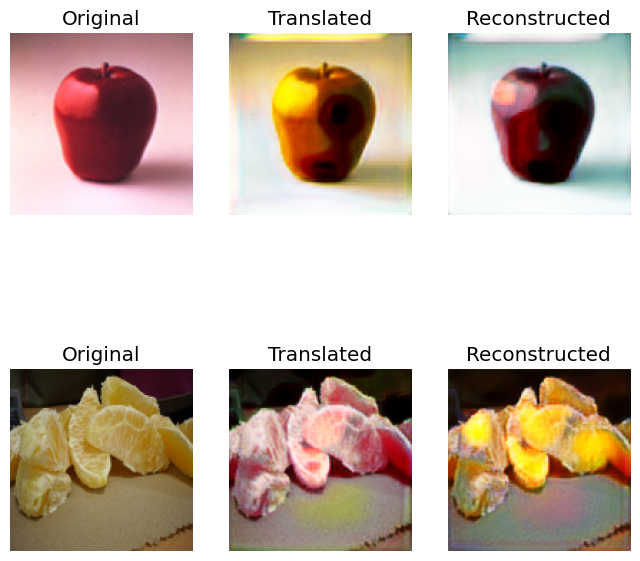

[Epoch 850/10] [Discriminator loss: 0.24164745956659317, accuracy: 53.125][Generator loss: 6.766232013702393, Adversarial Loss: 0.7581333518028259, Reconstruction Loss: 0.24509818106889725, Identity Loss: 0.1800244003534317]
[Epoch 900/10] [Discriminator loss: 0.057882473804056644, accuracy: 100.0][Generator loss: 7.36404275894165, Adversarial Loss: 0.8326853811740875, Reconstruction Loss: 0.2580743283033371, Identity Loss: 0.18825232982635498]
[Epoch 950/10] [Discriminator loss: 0.23775199428200722, accuracy: 72.265625][Generator loss: 4.691503524780273, Adversarial Loss: 0.7566099166870117, Reconstruction Loss: 0.14236363768577576, Identity Loss: 0.20440348982810974]
Epoch=11
[Epoch 0/11] [Discriminator loss: 0.09959038160741329, accuracy: 90.625][Generator loss: 8.105664253234863, Adversarial Loss: 0.9462049007415771, Reconstruction Loss: 0.2810470908880234, Identity Loss: 0.43544578552246094]


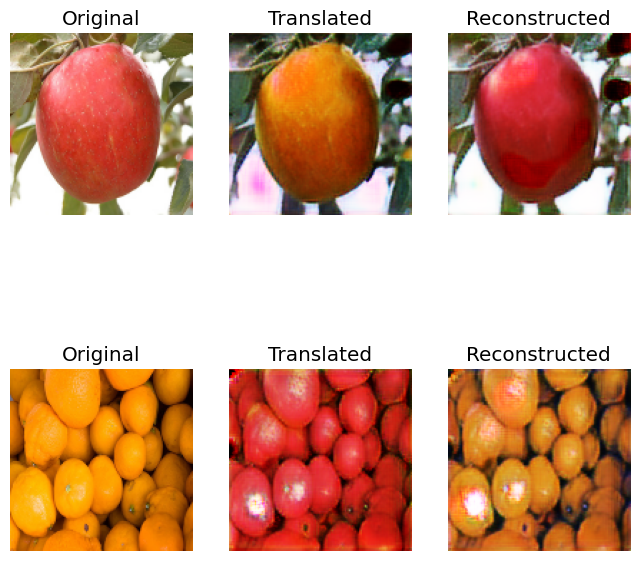

[Epoch 50/11] [Discriminator loss: 0.05653471313416958, accuracy: 98.046875][Generator loss: 5.3268303871154785, Adversarial Loss: 0.8950145244598389, Reconstruction Loss: 0.15912772715091705, Identity Loss: 0.16062673926353455]
[Epoch 100/11] [Discriminator loss: 0.10286169569008052, accuracy: 85.9375][Generator loss: 5.502481460571289, Adversarial Loss: 0.8486521244049072, Reconstruction Loss: 0.17041195183992386, Identity Loss: 0.18960148096084595]
[Epoch 150/11] [Discriminator loss: 0.05394024308770895, accuracy: 98.4375][Generator loss: 6.496496200561523, Adversarial Loss: 0.8232370018959045, Reconstruction Loss: 0.21830806881189346, Identity Loss: 0.28033527731895447]
[Epoch 200/11] [Discriminator loss: 0.05039601307362318, accuracy: 97.65625][Generator loss: 5.13372278213501, Adversarial Loss: 0.9380771219730377, Reconstruction Loss: 0.1490544006228447, Identity Loss: 0.1265375167131424]


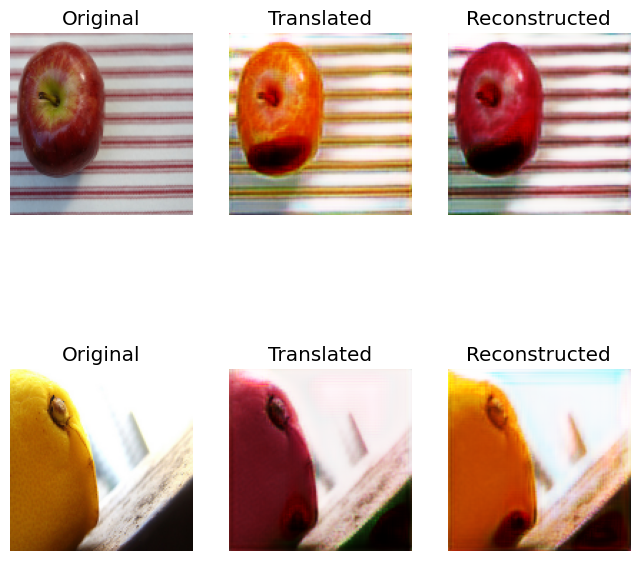

[Epoch 250/11] [Discriminator loss: 0.051001410000026226, accuracy: 95.3125][Generator loss: 6.705881595611572, Adversarial Loss: 0.9294919967651367, Reconstruction Loss: 0.22011129558086395, Identity Loss: 0.2133558690547943]
[Epoch 300/11] [Discriminator loss: 0.07909183390438557, accuracy: 89.453125][Generator loss: 6.202679634094238, Adversarial Loss: 0.8782965838909149, Reconstruction Loss: 0.19847793877124786, Identity Loss: 0.2889965772628784]
[Epoch 350/11] [Discriminator loss: 0.3971462957561016, accuracy: 57.8125][Generator loss: 5.265602111816406, Adversarial Loss: 0.6895276308059692, Reconstruction Loss: 0.17688599228858948, Identity Loss: 0.13397827744483948]
[Epoch 400/11] [Discriminator loss: 0.046358044259250164, accuracy: 100.0][Generator loss: 5.205046653747559, Adversarial Loss: 0.9439005255699158, Reconstruction Loss: 0.14841710776090622, Identity Loss: 0.14893309772014618]


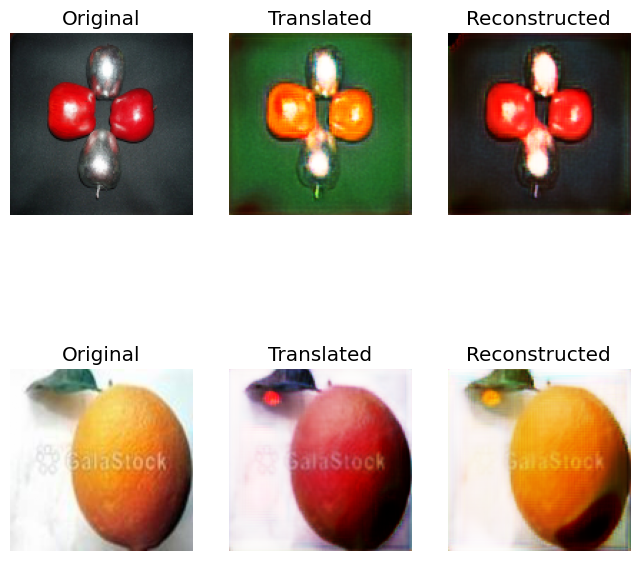

[Epoch 450/11] [Discriminator loss: 0.049148958176374435, accuracy: 97.265625][Generator loss: 5.890398979187012, Adversarial Loss: 1.0245448648929596, Reconstruction Loss: 0.17747269570827484, Identity Loss: 0.1416565477848053]
[Epoch 500/11] [Discriminator loss: 0.07416343782097101, accuracy: 98.046875][Generator loss: 5.9883832931518555, Adversarial Loss: 0.9014573693275452, Reconstruction Loss: 0.18817660212516785, Identity Loss: 0.10620634257793427]
[Epoch 550/11] [Discriminator loss: 0.08266351837664843, accuracy: 94.140625][Generator loss: 4.965720176696777, Adversarial Loss: 0.8073409199714661, Reconstruction Loss: 0.15098410099744797, Identity Loss: 0.17246124148368835]
[Epoch 600/11] [Discriminator loss: 0.2141393139027059, accuracy: 63.671875][Generator loss: 5.17603874206543, Adversarial Loss: 0.9103469848632812, Reconstruction Loss: 0.1492799147963524, Identity Loss: 0.15364229679107666]


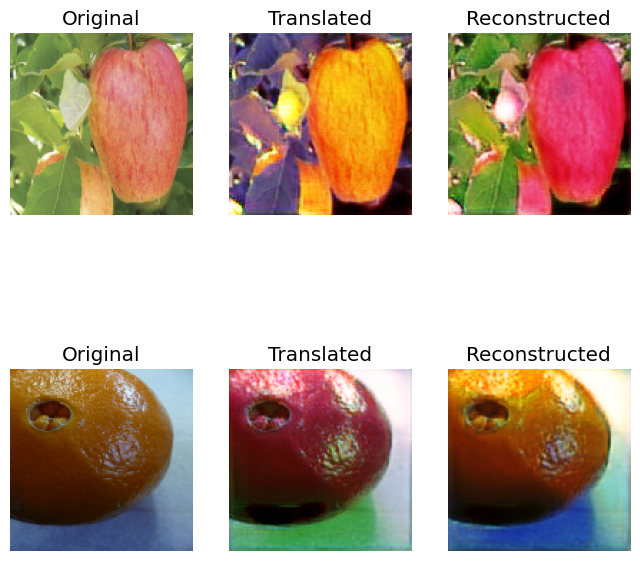

[Epoch 650/11] [Discriminator loss: 0.06327900011092424, accuracy: 95.703125][Generator loss: 6.244991302490234, Adversarial Loss: 0.9279728531837463, Reconstruction Loss: 0.19904323667287827, Identity Loss: 0.2226780652999878]
[Epoch 700/11] [Discriminator loss: 0.1834660079330206, accuracy: 75.0][Generator loss: 5.903395175933838, Adversarial Loss: 0.7559974789619446, Reconstruction Loss: 0.19907166063785553, Identity Loss: 0.23342907428741455]
[Epoch 750/11] [Discriminator loss: 0.09151522861793637, accuracy: 89.84375][Generator loss: 5.040918350219727, Adversarial Loss: 0.8418503403663635, Reconstruction Loss: 0.1497538536787033, Identity Loss: 0.20725944638252258]
[Epoch 800/11] [Discriminator loss: 0.0609141755849123, accuracy: 94.921875][Generator loss: 4.9951887130737305, Adversarial Loss: 0.8980961441993713, Reconstruction Loss: 0.14325324445962906, Identity Loss: 0.16505545377731323]


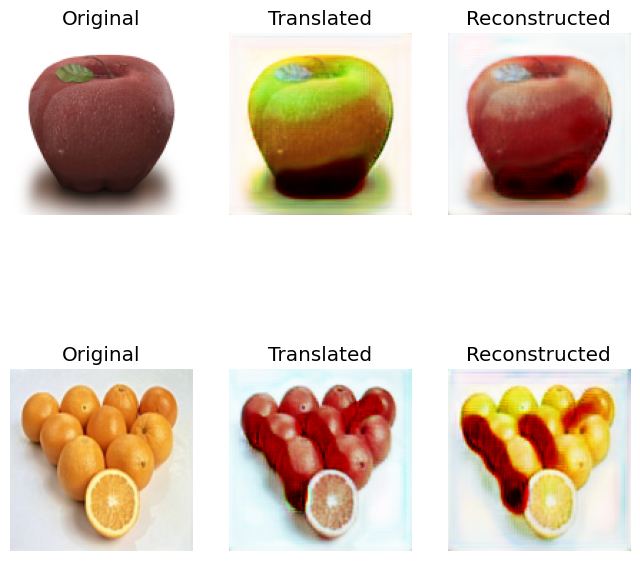

[Epoch 850/11] [Discriminator loss: 0.058951009064912796, accuracy: 96.09375][Generator loss: 6.180438041687012, Adversarial Loss: 0.9380377233028412, Reconstruction Loss: 0.19519002363085747, Identity Loss: 0.1291615515947342]
[Epoch 900/11] [Discriminator loss: 0.13786675408482552, accuracy: 80.078125][Generator loss: 5.254744529724121, Adversarial Loss: 0.828346461057663, Reconstruction Loss: 0.16238851845264435, Identity Loss: 0.14645633101463318]
[Epoch 950/11] [Discriminator loss: 0.031483590602874756, accuracy: 99.609375][Generator loss: 7.273923873901367, Adversarial Loss: 0.9289274513721466, Reconstruction Loss: 0.24731318652629852, Identity Loss: 0.19681799411773682]
Epoch=12
[Epoch 0/12] [Discriminator loss: 0.10284221870824695, accuracy: 87.5][Generator loss: 6.2527971267700195, Adversarial Loss: 0.9316928386688232, Reconstruction Loss: 0.1953246146440506, Identity Loss: 0.24592259526252747]


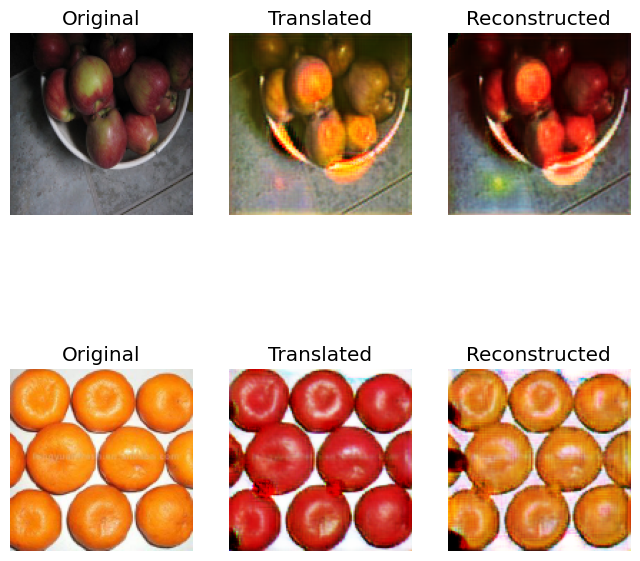

[Epoch 50/12] [Discriminator loss: 0.027977376244962215, accuracy: 99.609375][Generator loss: 5.418973445892334, Adversarial Loss: 1.0107472836971283, Reconstruction Loss: 0.15445824712514877, Identity Loss: 0.14208218455314636]
[Epoch 100/12] [Discriminator loss: 0.2093380196020007, accuracy: 69.140625][Generator loss: 6.278179168701172, Adversarial Loss: 1.2446481585502625, Reconstruction Loss: 0.1743251048028469, Identity Loss: 0.11417844891548157]
[Epoch 150/12] [Discriminator loss: 0.08192943315953016, accuracy: 91.015625][Generator loss: 4.705662727355957, Adversarial Loss: 0.8186435401439667, Reconstruction Loss: 0.14050784334540367, Identity Loss: 0.12004157900810242]
[Epoch 200/12] [Discriminator loss: 0.02552994666621089, accuracy: 100.0][Generator loss: 7.059668064117432, Adversarial Loss: 1.0124565660953522, Reconstruction Loss: 0.2279062718153, Identity Loss: 0.19807574152946472]


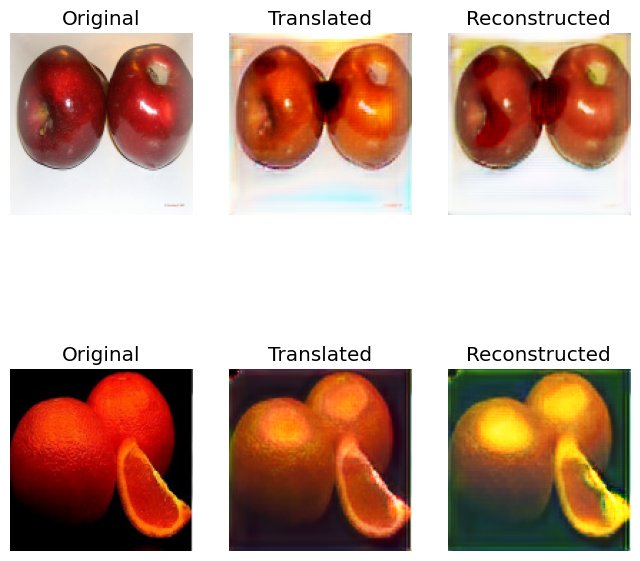

[Epoch 250/12] [Discriminator loss: 0.0932331713847816, accuracy: 89.0625][Generator loss: 5.526488304138184, Adversarial Loss: 0.9514485895633698, Reconstruction Loss: 0.1654028594493866, Identity Loss: 0.14996621012687683]
[Epoch 300/12] [Discriminator loss: 0.08090572897344828, accuracy: 88.671875][Generator loss: 5.5569000244140625, Adversarial Loss: 0.9716411232948303, Reconstruction Loss: 0.16299380362033844, Identity Loss: 0.19536718726158142]
[Epoch 350/12] [Discriminator loss: 0.028518390376120806, accuracy: 100.0][Generator loss: 5.754401206970215, Adversarial Loss: 0.9472765922546387, Reconstruction Loss: 0.17425493896007538, Identity Loss: 0.17743231356143951]
[Epoch 400/12] [Discriminator loss: 0.06858325423672795, accuracy: 94.921875][Generator loss: 7.143542289733887, Adversarial Loss: 0.9090169072151184, Reconstruction Loss: 0.23992494493722916, Identity Loss: 0.2528822422027588]


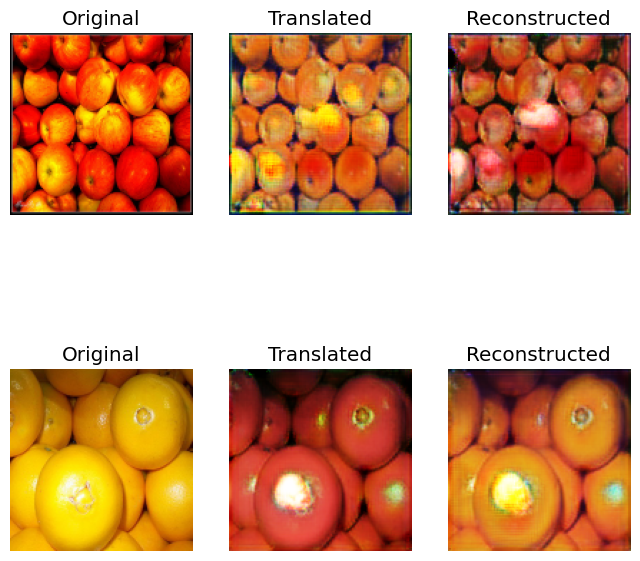

[Epoch 450/12] [Discriminator loss: 0.10578352096490562, accuracy: 84.375][Generator loss: 6.425084114074707, Adversarial Loss: 0.7991665899753571, Reconstruction Loss: 0.21821237355470657, Identity Loss: 0.1890186369419098]
[Epoch 500/12] [Discriminator loss: 0.03951786505058408, accuracy: 99.21875][Generator loss: 5.402287483215332, Adversarial Loss: 0.9818910360336304, Reconstruction Loss: 0.1535487025976181, Identity Loss: 0.20031483471393585]
[Epoch 550/12] [Discriminator loss: 0.15630175452679396, accuracy: 80.078125][Generator loss: 6.478689193725586, Adversarial Loss: 0.8392252326011658, Reconstruction Loss: 0.21438166499137878, Identity Loss: 0.2517482042312622]
[Epoch 600/12] [Discriminator loss: 0.13754737749695778, accuracy: 77.734375][Generator loss: 5.835167407989502, Adversarial Loss: 0.8352062106132507, Reconstruction Loss: 0.1863204389810562, Identity Loss: 0.27146977186203003]


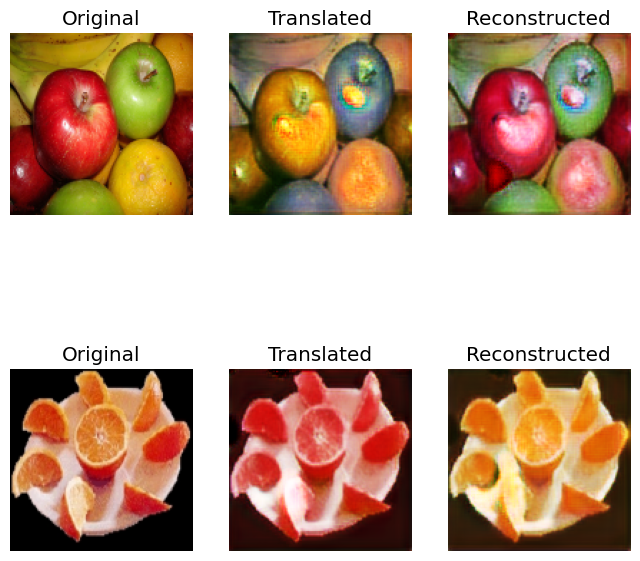

[Epoch 650/12] [Discriminator loss: 0.05253963451832533, accuracy: 98.4375][Generator loss: 6.365946292877197, Adversarial Loss: 0.8547132909297943, Reconstruction Loss: 0.20713049173355103, Identity Loss: 0.31014251708984375]
[Epoch 700/12] [Discriminator loss: 0.18721073493361473, accuracy: 76.953125][Generator loss: 4.449411392211914, Adversarial Loss: 0.8127979338169098, Reconstruction Loss: 0.12754908204078674, Identity Loss: 0.11373990029096603]
[Epoch 750/12] [Discriminator loss: 0.1342419246211648, accuracy: 83.984375][Generator loss: 4.849534034729004, Adversarial Loss: 1.0156053602695465, Reconstruction Loss: 0.12523366510868073, Identity Loss: 0.11779139935970306]
[Epoch 800/12] [Discriminator loss: 0.0665725376456976, accuracy: 92.1875][Generator loss: 5.66128396987915, Adversarial Loss: 0.8829632997512817, Reconstruction Loss: 0.17736328393220901, Identity Loss: 0.18193507194519043]


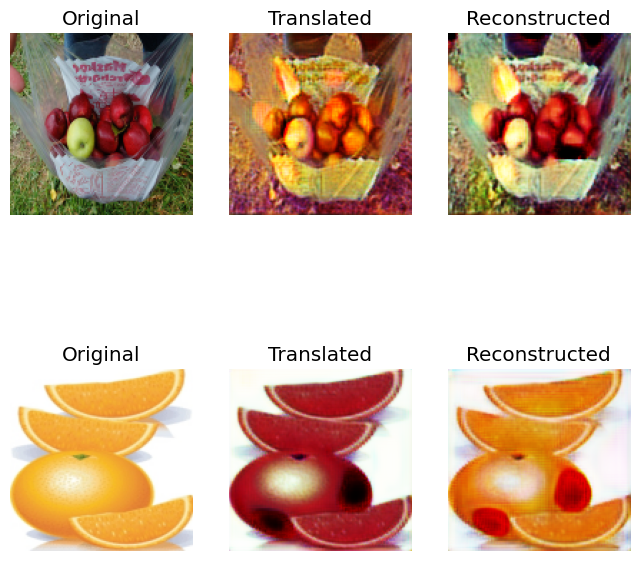

[Epoch 850/12] [Discriminator loss: 0.027162904851138592, accuracy: 100.0][Generator loss: 6.679272651672363, Adversarial Loss: 0.9500335454940796, Reconstruction Loss: 0.21700266748666763, Identity Loss: 0.1823146492242813]
[Epoch 900/12] [Discriminator loss: 0.10962474066764116, accuracy: 88.671875][Generator loss: 5.033889293670654, Adversarial Loss: 0.7707104980945587, Reconstruction Loss: 0.1555461399257183, Identity Loss: 0.18162409961223602]
[Epoch 950/12] [Discriminator loss: 0.1147249611094594, accuracy: 83.984375][Generator loss: 4.794401168823242, Adversarial Loss: 0.9424331188201904, Reconstruction Loss: 0.13180555775761604, Identity Loss: 0.1059713363647461]
Epoch=13
[Epoch 0/13] [Discriminator loss: 0.11012344085611403, accuracy: 83.984375][Generator loss: 5.757853984832764, Adversarial Loss: 0.8995636105537415, Reconstruction Loss: 0.1781928837299347, Identity Loss: 0.18323543667793274]


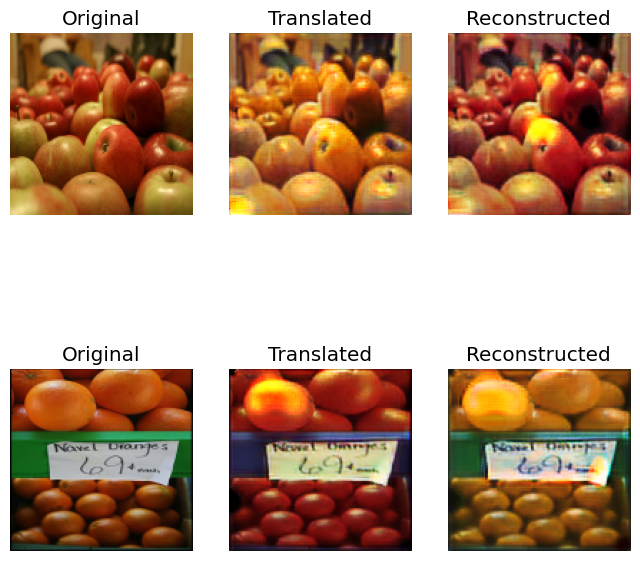

[Epoch 50/13] [Discriminator loss: 0.05694274138659239, accuracy: 98.4375][Generator loss: 5.380956172943115, Adversarial Loss: 0.9438371360301971, Reconstruction Loss: 0.1546575278043747, Identity Loss: 0.19939635694026947]
[Epoch 100/13] [Discriminator loss: 0.12760905409231782, accuracy: 76.953125][Generator loss: 5.368152141571045, Adversarial Loss: 0.7631901800632477, Reconstruction Loss: 0.17281953245401382, Identity Loss: 0.18632441759109497]
[Epoch 150/13] [Discriminator loss: 0.20438574673607945, accuracy: 69.140625][Generator loss: 5.38645601272583, Adversarial Loss: 0.9594183564186096, Reconstruction Loss: 0.15605078265070915, Identity Loss: 0.16419613361358643]
[Epoch 200/13] [Discriminator loss: 0.07543177390471101, accuracy: 94.921875][Generator loss: 5.9209465980529785, Adversarial Loss: 0.9038554131984711, Reconstruction Loss: 0.18539012968540192, Identity Loss: 0.24393080174922943]


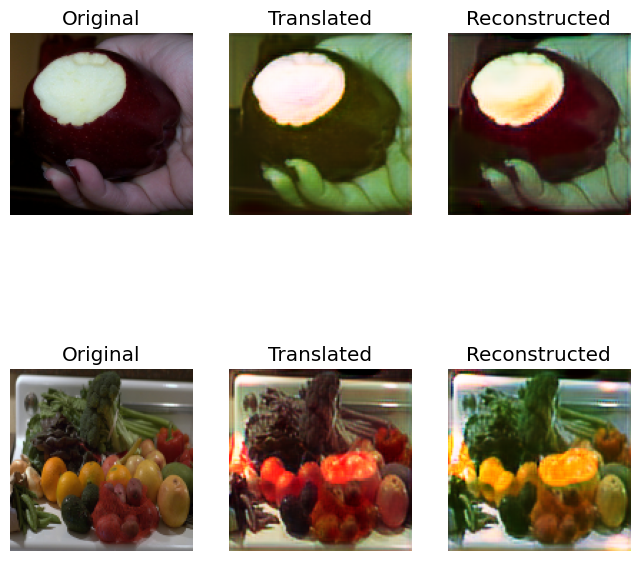

[Epoch 250/13] [Discriminator loss: 0.05454315571114421, accuracy: 97.65625][Generator loss: 5.19523286819458, Adversarial Loss: 0.8155919909477234, Reconstruction Loss: 0.16316865384578705, Identity Loss: 0.14298537373542786]
[Epoch 300/13] [Discriminator loss: 0.030033142305910587, accuracy: 100.0][Generator loss: 5.637929916381836, Adversarial Loss: 1.0594680309295654, Reconstruction Loss: 0.15775906294584274, Identity Loss: 0.12487418949604034]
[Epoch 350/13] [Discriminator loss: 0.08774618525058031, accuracy: 92.1875][Generator loss: 4.504885673522949, Adversarial Loss: 0.7272544503211975, Reconstruction Loss: 0.13671065121889114, Identity Loss: 0.16778162121772766]
[Epoch 400/13] [Discriminator loss: 0.0446453511249274, accuracy: 99.21875][Generator loss: 6.57605504989624, Adversarial Loss: 0.894885241985321, Reconstruction Loss: 0.2153734415769577, Identity Loss: 0.2360028326511383]


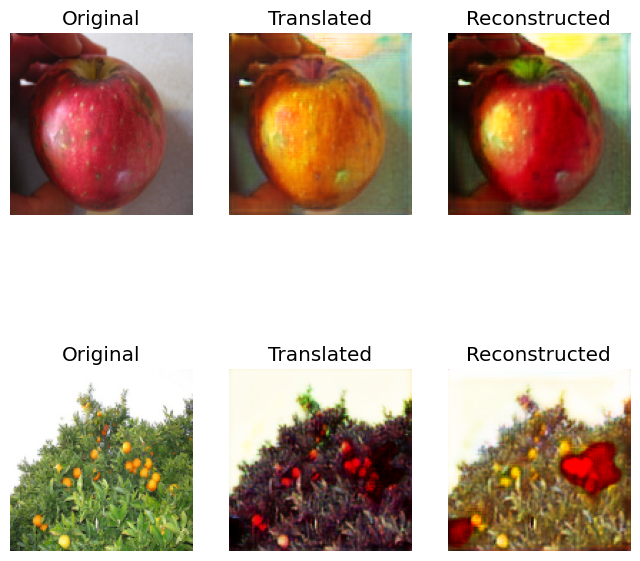

[Epoch 450/13] [Discriminator loss: 0.10880977474153042, accuracy: 88.28125][Generator loss: 4.651856422424316, Adversarial Loss: 0.8348926603794098, Reconstruction Loss: 0.1305701956152916, Identity Loss: 0.15435902774333954]
[Epoch 500/13] [Discriminator loss: 0.05499092768877745, accuracy: 98.828125][Generator loss: 5.843272686004639, Adversarial Loss: 0.9344778954982758, Reconstruction Loss: 0.17883823066949844, Identity Loss: 0.21333420276641846]
[Epoch 550/13] [Discriminator loss: 0.03447246132418513, accuracy: 99.609375][Generator loss: 5.575588703155518, Adversarial Loss: 0.9586725234985352, Reconstruction Loss: 0.16478466987609863, Identity Loss: 0.20586535334587097]
[Epoch 600/13] [Discriminator loss: 0.07026868313550949, accuracy: 98.4375][Generator loss: 5.700075626373291, Adversarial Loss: 1.038978397846222, Reconstruction Loss: 0.16257095336914062, Identity Loss: 0.15163233876228333]


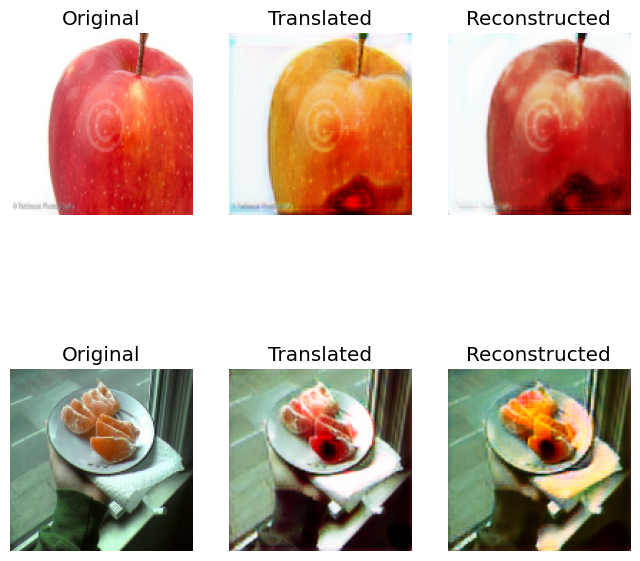

[Epoch 650/13] [Discriminator loss: 0.10468216985464096, accuracy: 91.40625][Generator loss: 5.338554859161377, Adversarial Loss: 0.7828613519668579, Reconstruction Loss: 0.17057568579912186, Identity Loss: 0.2034728080034256]
[Epoch 700/13] [Discriminator loss: 0.03989406302571297, accuracy: 98.828125][Generator loss: 6.040293216705322, Adversarial Loss: 1.0358011424541473, Reconstruction Loss: 0.1803191751241684, Identity Loss: 0.1466098129749298]
[Epoch 750/13] [Discriminator loss: 0.028210391756147146, accuracy: 100.0][Generator loss: 5.6880598068237305, Adversarial Loss: 1.0931093990802765, Reconstruction Loss: 0.15797830373048782, Identity Loss: 0.17989879846572876]
[Epoch 800/13] [Discriminator loss: 0.06174252741038799, accuracy: 98.4375][Generator loss: 5.6894612312316895, Adversarial Loss: 0.8411085307598114, Reconstruction Loss: 0.18053016811609268, Identity Loss: 0.20512539148330688]


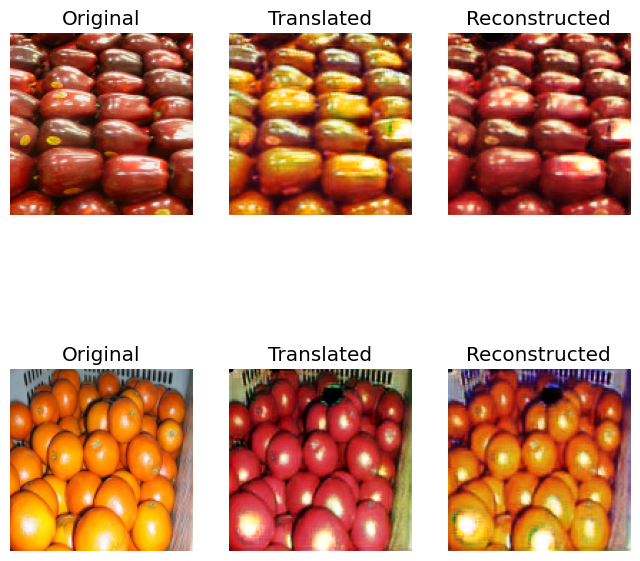

[Epoch 850/13] [Discriminator loss: 0.2729396247304976, accuracy: 75.0][Generator loss: 5.964742660522461, Adversarial Loss: 0.9262881577014923, Reconstruction Loss: 0.18764042109251022, Identity Loss: 0.14745377004146576]
[Epoch 900/13] [Discriminator loss: 0.10351484781131148, accuracy: 87.5][Generator loss: 5.332314968109131, Adversarial Loss: 0.8165596425533295, Reconstruction Loss: 0.16747117042541504, Identity Loss: 0.17530876398086548]
[Epoch 950/13] [Discriminator loss: 0.1187751879915595, accuracy: 85.546875][Generator loss: 4.429603576660156, Adversarial Loss: 0.761794775724411, Reconstruction Loss: 0.12843383103609085, Identity Loss: 0.16729527711868286]
Epoch=14
[Epoch 0/14] [Discriminator loss: 0.08930272795259953, accuracy: 92.578125][Generator loss: 6.4187331199646, Adversarial Loss: 1.1450062692165375, Reconstruction Loss: 0.18887513130903244, Identity Loss: 0.13892653584480286]


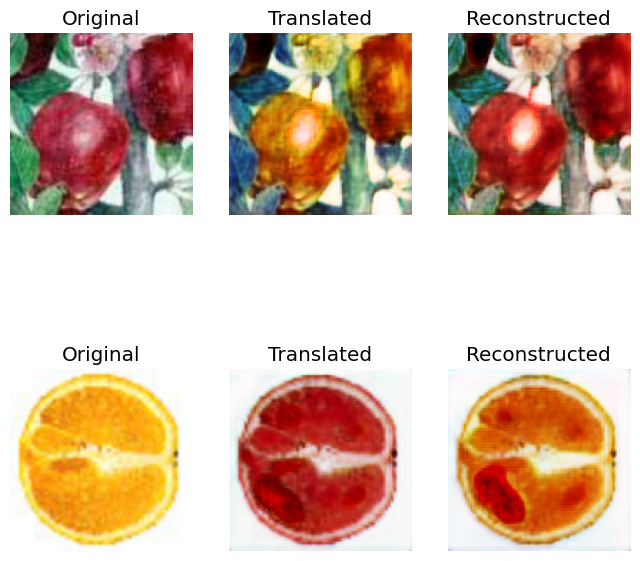

[Epoch 50/14] [Discriminator loss: 0.05136699741706252, accuracy: 97.65625][Generator loss: 6.583138942718506, Adversarial Loss: 0.818792462348938, Reconstruction Loss: 0.2202187478542328, Identity Loss: 0.34913092851638794]
[Epoch 100/14] [Discriminator loss: 0.023177813040092587, accuracy: 99.21875][Generator loss: 5.1807708740234375, Adversarial Loss: 1.0005564093589783, Reconstruction Loss: 0.14464809000492096, Identity Loss: 0.09381106495857239]
[Epoch 150/14] [Discriminator loss: 0.12082476355135441, accuracy: 84.765625][Generator loss: 4.262252330780029, Adversarial Loss: 0.8133213520050049, Reconstruction Loss: 0.11591930687427521, Identity Loss: 0.20024141669273376]
[Epoch 200/14] [Discriminator loss: 0.051000963198021054, accuracy: 97.65625][Generator loss: 6.017388343811035, Adversarial Loss: 1.0048089623451233, Reconstruction Loss: 0.17996341735124588, Identity Loss: 0.25803321599960327]


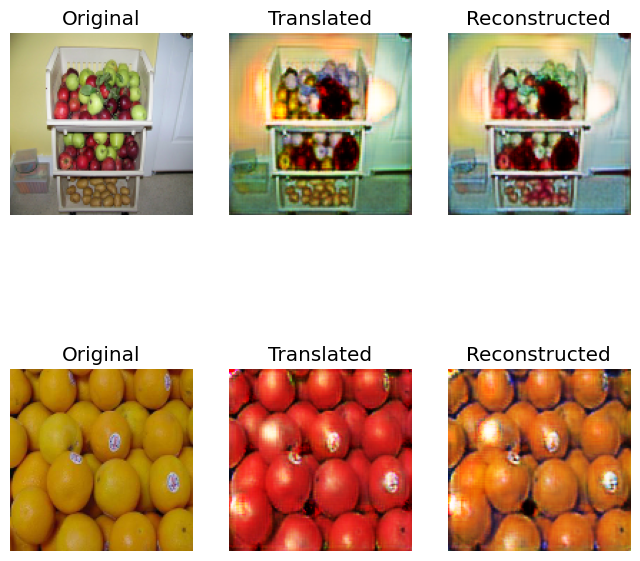

[Epoch 250/14] [Discriminator loss: 0.09678992629051208, accuracy: 89.453125][Generator loss: 4.727187156677246, Adversarial Loss: 0.8083042502403259, Reconstruction Loss: 0.14057590067386627, Identity Loss: 0.13255727291107178]
[Epoch 300/14] [Discriminator loss: 0.051059253979474306, accuracy: 97.265625][Generator loss: 5.555996417999268, Adversarial Loss: 1.0040250718593597, Reconstruction Loss: 0.15961167961359024, Identity Loss: 0.19256143271923065]
[Epoch 350/14] [Discriminator loss: 0.05967238126322627, accuracy: 97.265625][Generator loss: 5.245734214782715, Adversarial Loss: 0.8739573061466217, Reconstruction Loss: 0.15852037072181702, Identity Loss: 0.15399320423603058]
[Epoch 400/14] [Discriminator loss: 0.06861209264025092, accuracy: 92.96875][Generator loss: 5.254595756530762, Adversarial Loss: 0.8833631277084351, Reconstruction Loss: 0.15731219947338104, Identity Loss: 0.2002660632133484]


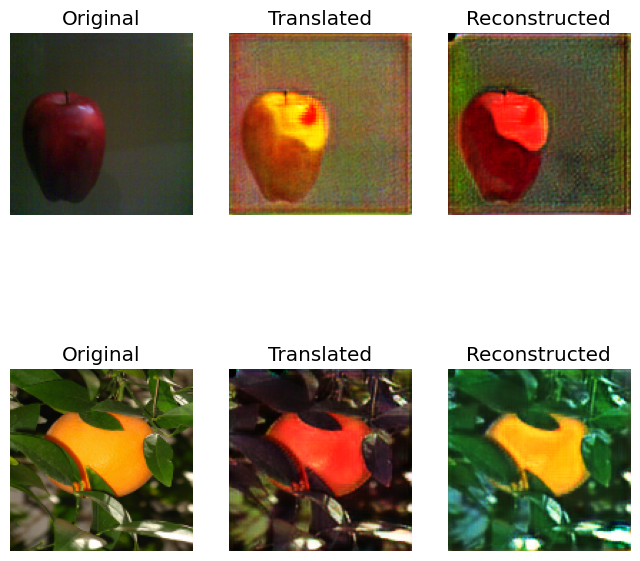

[Epoch 450/14] [Discriminator loss: 0.03020169585943222, accuracy: 100.0][Generator loss: 6.146330833435059, Adversarial Loss: 0.9913514852523804, Reconstruction Loss: 0.1881941631436348, Identity Loss: 0.20343993604183197]
[Epoch 500/14] [Discriminator loss: 0.08153591491281986, accuracy: 92.1875][Generator loss: 5.789053916931152, Adversarial Loss: 0.827178955078125, Reconstruction Loss: 0.1839330866932869, Identity Loss: 0.26157158613204956]
[Epoch 550/14] [Discriminator loss: 0.1794805214740336, accuracy: 72.265625][Generator loss: 5.255399703979492, Adversarial Loss: 0.7322444915771484, Reconstruction Loss: 0.17169878631830215, Identity Loss: 0.14852869510650635]
[Epoch 600/14] [Discriminator loss: 0.058239259640686214, accuracy: 94.921875][Generator loss: 4.934991836547852, Adversarial Loss: 0.8938091397285461, Reconstruction Loss: 0.1441500186920166, Identity Loss: 0.0829659253358841]


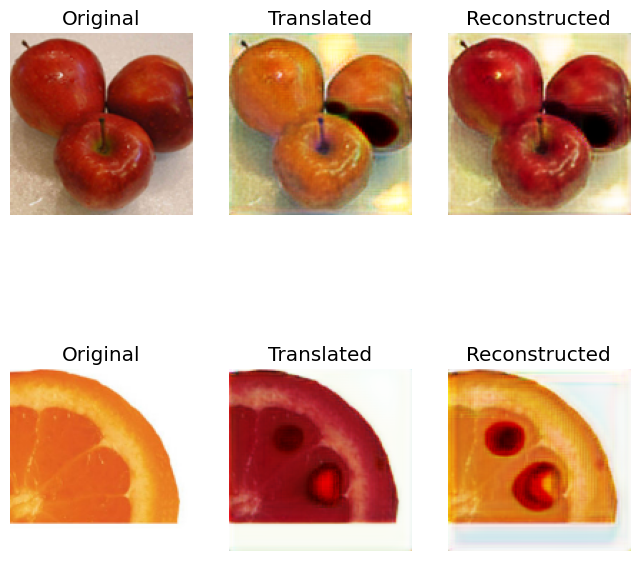

[Epoch 650/14] [Discriminator loss: 0.021482134703546762, accuracy: 100.0][Generator loss: 6.306519031524658, Adversarial Loss: 0.8965390920639038, Reconstruction Loss: 0.20221710950136185, Identity Loss: 0.21831756830215454]
[Epoch 700/14] [Discriminator loss: 0.05548355635255575, accuracy: 99.21875][Generator loss: 5.66628360748291, Adversarial Loss: 0.9318394660949707, Reconstruction Loss: 0.17068341374397278, Identity Loss: 0.24890828132629395]
[Epoch 750/14] [Discriminator loss: 0.039068445563316345, accuracy: 99.609375][Generator loss: 5.429427623748779, Adversarial Loss: 0.9932141900062561, Reconstruction Loss: 0.15251871198415756, Identity Loss: 0.24996817111968994]
[Epoch 800/14] [Discriminator loss: 0.11599131999537349, accuracy: 83.984375][Generator loss: 5.6004767417907715, Adversarial Loss: 0.9932999908924103, Reconstruction Loss: 0.16270484030246735, Identity Loss: 0.20518183708190918]


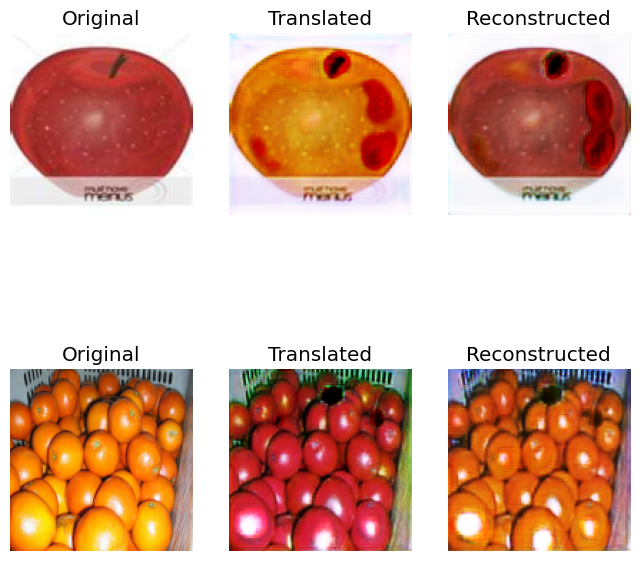

[Epoch 850/14] [Discriminator loss: 0.03778880788013339, accuracy: 99.21875][Generator loss: 8.705606460571289, Adversarial Loss: 0.9843766689300537, Reconstruction Loss: 0.3093324303627014, Identity Loss: 0.37182700634002686]
[Epoch 900/14] [Discriminator loss: 0.2414077715948224, accuracy: 71.09375][Generator loss: 4.8519768714904785, Adversarial Loss: 0.8780592679977417, Reconstruction Loss: 0.13746869564056396, Identity Loss: 0.18178485333919525]
[Epoch 950/14] [Discriminator loss: 0.11710493080317974, accuracy: 84.765625][Generator loss: 5.159022331237793, Adversarial Loss: 0.8927624225616455, Reconstruction Loss: 0.15104734152555466, Identity Loss: 0.16873130202293396]
Epoch=15
[Epoch 0/15] [Discriminator loss: 0.12615149654448032, accuracy: 79.6875][Generator loss: 5.655830383300781, Adversarial Loss: 1.0184403657913208, Reconstruction Loss: 0.16174987703561783, Identity Loss: 0.16350138187408447]


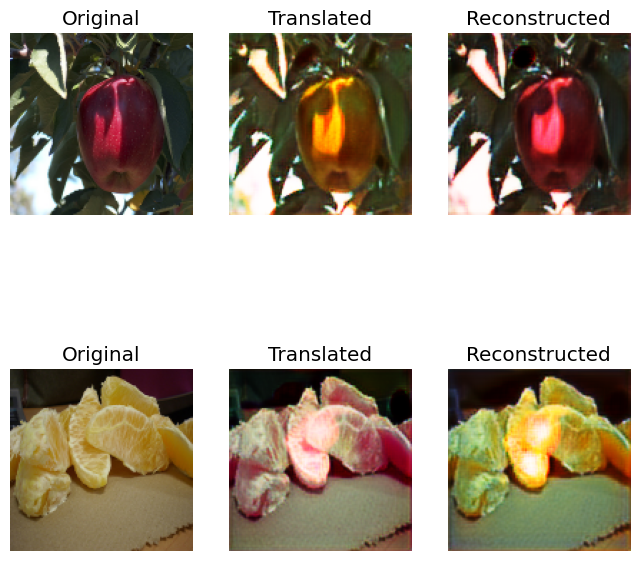

[Epoch 50/15] [Discriminator loss: 0.16636512940749526, accuracy: 74.21875][Generator loss: 5.00920295715332, Adversarial Loss: 0.6605182886123657, Reconstruction Loss: 0.16522768884897232, Identity Loss: 0.22605812549591064]
[Epoch 100/15] [Discriminator loss: 0.02320011076517403, accuracy: 99.609375][Generator loss: 5.252182960510254, Adversarial Loss: 0.9399914741516113, Reconstruction Loss: 0.15430770069360733, Identity Loss: 0.11981061846017838]
[Epoch 150/15] [Discriminator loss: 0.1570076416246593, accuracy: 76.5625][Generator loss: 5.0287017822265625, Adversarial Loss: 0.8684629201889038, Reconstruction Loss: 0.14895635098218918, Identity Loss: 0.1442871391773224]
[Epoch 200/15] [Discriminator loss: 0.039905612473376095, accuracy: 99.609375][Generator loss: 5.943387508392334, Adversarial Loss: 0.930743932723999, Reconstruction Loss: 0.18786520510911942, Identity Loss: 0.14557817578315735]


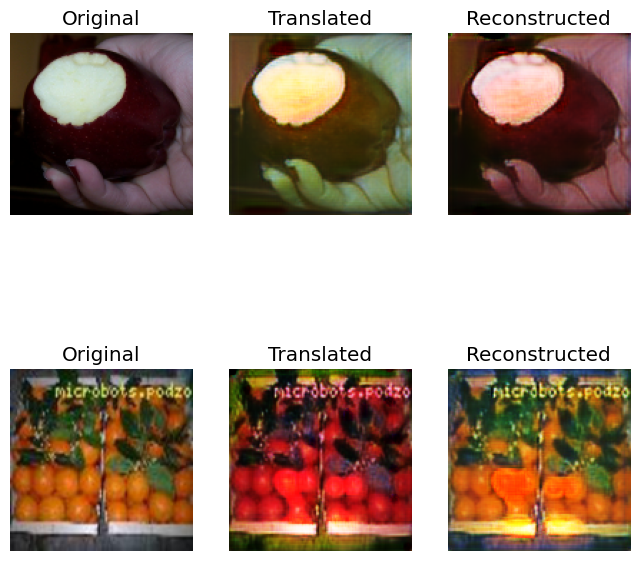

[Epoch 250/15] [Discriminator loss: 0.20683849789202213, accuracy: 66.40625][Generator loss: 5.683349132537842, Adversarial Loss: 0.7651148736476898, Reconstruction Loss: 0.1884702891111374, Identity Loss: 0.15120156109333038]
[Epoch 300/15] [Discriminator loss: 0.02788354642689228, accuracy: 99.21875][Generator loss: 6.705148696899414, Adversarial Loss: 0.8986888527870178, Reconstruction Loss: 0.21994216740131378, Identity Loss: 0.2952045798301697]
[Epoch 350/15] [Discriminator loss: 0.028089279192499816, accuracy: 99.21875][Generator loss: 7.293787002563477, Adversarial Loss: 1.0825848579406738, Reconstruction Loss: 0.2294570729136467, Identity Loss: 0.17032723128795624]
[Epoch 400/15] [Discriminator loss: 0.08912252588197589, accuracy: 92.96875][Generator loss: 5.020524024963379, Adversarial Loss: 0.8101252615451813, Reconstruction Loss: 0.1536928191781044, Identity Loss: 0.16962355375289917]


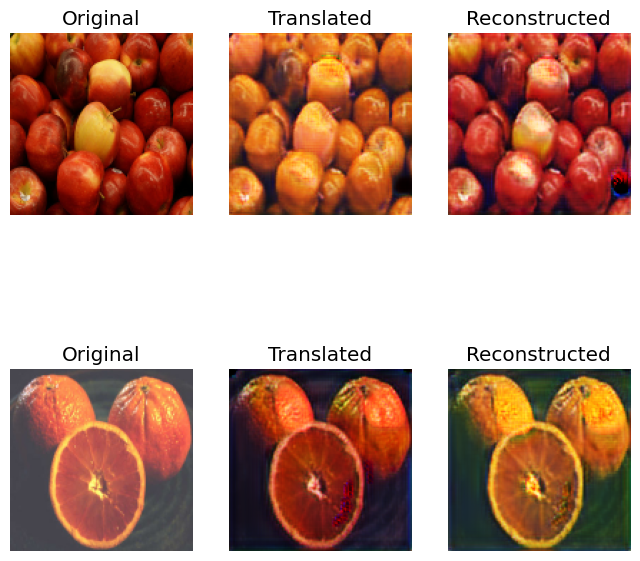

[Epoch 450/15] [Discriminator loss: 0.0726415985263884, accuracy: 96.484375][Generator loss: 6.821540832519531, Adversarial Loss: 0.9071694016456604, Reconstruction Loss: 0.2273675501346588, Identity Loss: 0.19859930872917175]
[Epoch 500/15] [Discriminator loss: 0.11227731872349977, accuracy: 84.375][Generator loss: 5.182277202606201, Adversarial Loss: 0.8734970092773438, Reconstruction Loss: 0.14939933270215988, Identity Loss: 0.2831352949142456]
[Epoch 550/15] [Discriminator loss: 0.10820535011589527, accuracy: 86.328125][Generator loss: 5.6467132568359375, Adversarial Loss: 0.789137214422226, Reconstruction Loss: 0.18308809399604797, Identity Loss: 0.17727214097976685]
[Epoch 600/15] [Discriminator loss: 0.03170444816350937, accuracy: 99.609375][Generator loss: 6.2091779708862305, Adversarial Loss: 1.094334065914154, Reconstruction Loss: 0.18226198107004166, Identity Loss: 0.1670149564743042]


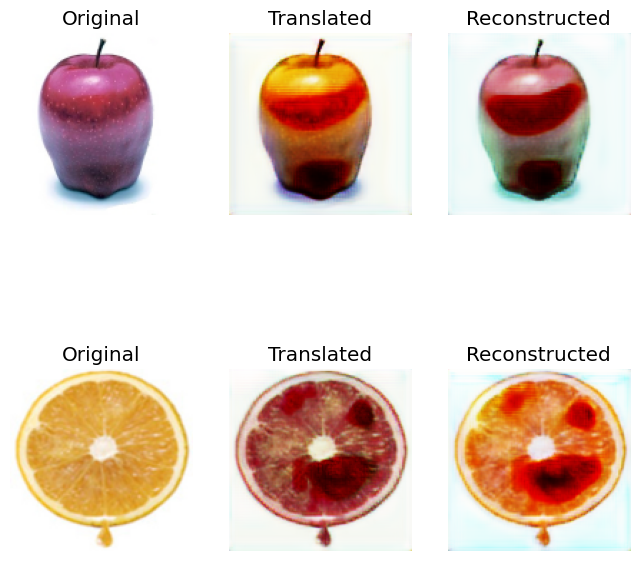

[Epoch 650/15] [Discriminator loss: 0.07873381837271154, accuracy: 89.0625][Generator loss: 5.5382795333862305, Adversarial Loss: 0.9512244462966919, Reconstruction Loss: 0.16462364792823792, Identity Loss: 0.15282359719276428]
[Epoch 700/15] [Discriminator loss: 0.22680581407621503, accuracy: 74.609375][Generator loss: 5.592583656311035, Adversarial Loss: 0.9969800710678101, Reconstruction Loss: 0.16395260393619537, Identity Loss: 0.1105562299489975]
[Epoch 750/15] [Discriminator loss: 0.04733908176422119, accuracy: 98.046875][Generator loss: 5.487557411193848, Adversarial Loss: 0.9409547448158264, Reconstruction Loss: 0.1640683263540268, Identity Loss: 0.12048787623643875]
[Epoch 800/15] [Discriminator loss: 0.023131603375077248, accuracy: 100.0][Generator loss: 4.8023247718811035, Adversarial Loss: 0.9733603000640869, Reconstruction Loss: 0.1272360011935234, Identity Loss: 0.14988231658935547]


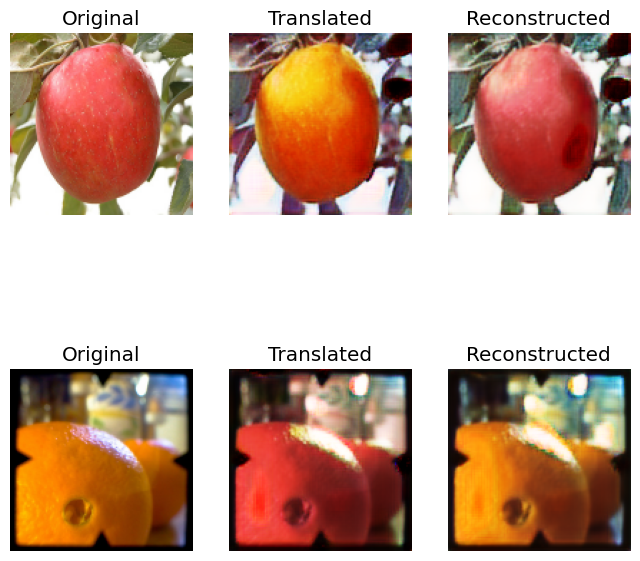

[Epoch 850/15] [Discriminator loss: 0.023733014706522226, accuracy: 99.609375][Generator loss: 5.161783695220947, Adversarial Loss: 0.9053034782409668, Reconstruction Loss: 0.14828963577747345, Identity Loss: 0.23163126409053802]
[Epoch 900/15] [Discriminator loss: 0.08393843751400709, accuracy: 94.140625][Generator loss: 4.656076431274414, Adversarial Loss: 0.8279208242893219, Reconstruction Loss: 0.13330654427409172, Identity Loss: 0.20726630091667175]
[Epoch 950/15] [Discriminator loss: 0.24587494926527143, accuracy: 63.28125][Generator loss: 5.664292812347412, Adversarial Loss: 0.7836662232875824, Reconstruction Loss: 0.18548470735549927, Identity Loss: 0.1658044457435608]
Epoch=16
[Epoch 0/16] [Discriminator loss: 0.017840057611465454, accuracy: 100.0][Generator loss: 7.524988174438477, Adversarial Loss: 1.0634490847587585, Reconstruction Loss: 0.24367256462574005, Identity Loss: 0.31218209862709045]


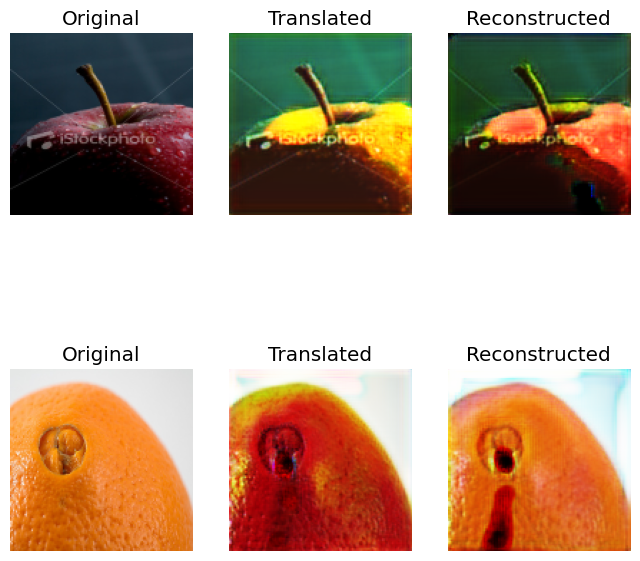

[Epoch 50/16] [Discriminator loss: 0.05907709524035454, accuracy: 98.4375][Generator loss: 4.97830867767334, Adversarial Loss: 1.0600806772708893, Reconstruction Loss: 0.127897709608078, Identity Loss: 0.14132454991340637]
[Epoch 100/16] [Discriminator loss: 0.04580231895670295, accuracy: 98.4375][Generator loss: 5.205266952514648, Adversarial Loss: 0.8990575969219208, Reconstruction Loss: 0.15231437608599663, Identity Loss: 0.12603223323822021]
[Epoch 150/16] [Discriminator loss: 0.024266690481454134, accuracy: 100.0][Generator loss: 6.548752784729004, Adversarial Loss: 0.9007206857204437, Reconstruction Loss: 0.21489094197750092, Identity Loss: 0.2674378752708435]
[Epoch 200/16] [Discriminator loss: 0.21452169306576252, accuracy: 65.625][Generator loss: 4.892396926879883, Adversarial Loss: 0.8587965667247772, Reconstruction Loss: 0.1396622136235237, Identity Loss: 0.13976413011550903]


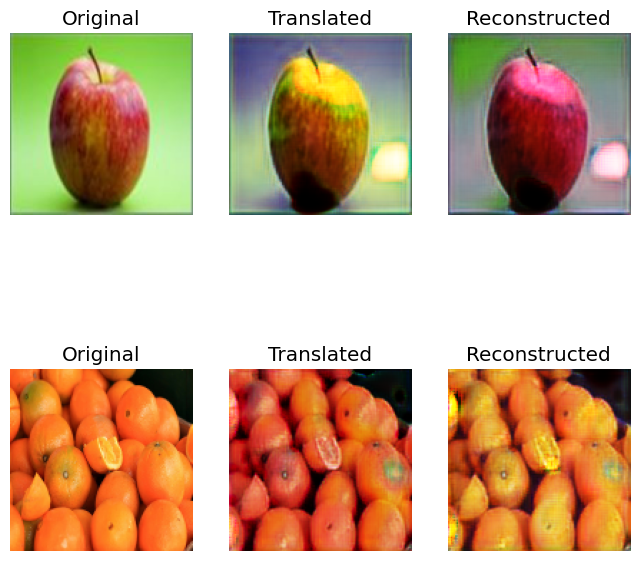

[Epoch 250/16] [Discriminator loss: 0.03972078487277031, accuracy: 98.4375][Generator loss: 4.835854530334473, Adversarial Loss: 0.8837236762046814, Reconstruction Loss: 0.13662490993738174, Identity Loss: 0.10893669724464417]
[Epoch 300/16] [Discriminator loss: 0.14951041247695684, accuracy: 80.46875][Generator loss: 4.768466949462891, Adversarial Loss: 0.8171311616897583, Reconstruction Loss: 0.14004449546337128, Identity Loss: 0.14586511254310608]
[Epoch 350/16] [Discriminator loss: 0.01803174545057118, accuracy: 100.0][Generator loss: 6.357242584228516, Adversarial Loss: 1.0416570901870728, Reconstruction Loss: 0.1920768916606903, Identity Loss: 0.24198593199253082]
[Epoch 400/16] [Discriminator loss: 0.14560620160773396, accuracy: 80.46875][Generator loss: 5.904972076416016, Adversarial Loss: 0.8350778222084045, Reconstruction Loss: 0.19225236028432846, Identity Loss: 0.1927112340927124]


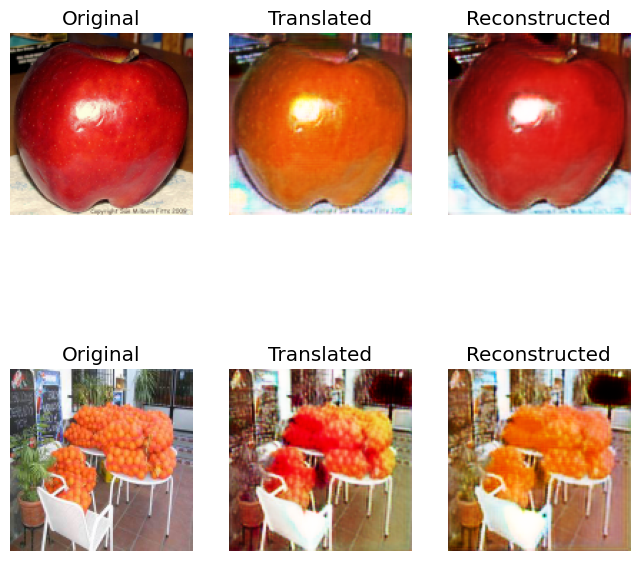

[Epoch 450/16] [Discriminator loss: 0.03793079871684313, accuracy: 99.609375][Generator loss: 5.670009613037109, Adversarial Loss: 0.8702057301998138, Reconstruction Loss: 0.17956839501857758, Identity Loss: 0.15988773107528687]
[Epoch 500/16] [Discriminator loss: 0.02540789032354951, accuracy: 99.609375][Generator loss: 5.427244663238525, Adversarial Loss: 0.9307191967964172, Reconstruction Loss: 0.16265933215618134, Identity Loss: 0.15300819277763367]
[Epoch 550/16] [Discriminator loss: 0.05842309328727424, accuracy: 94.140625][Generator loss: 6.592601299285889, Adversarial Loss: 1.07776540517807, Reconstruction Loss: 0.1979827880859375, Identity Loss: 0.25064826011657715]
[Epoch 600/16] [Discriminator loss: 0.015254801837727427, accuracy: 100.0][Generator loss: 6.336919784545898, Adversarial Loss: 1.1285147070884705, Reconstruction Loss: 0.18493147939443588, Identity Loss: 0.22317802906036377]


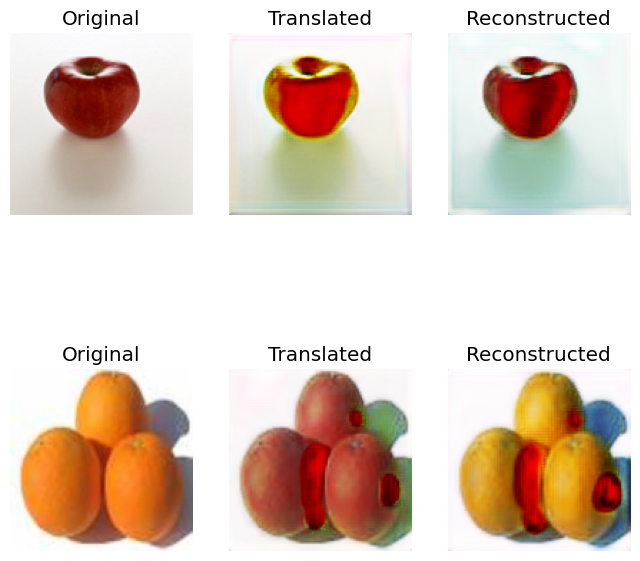

[Epoch 650/16] [Discriminator loss: 0.10829133400693536, accuracy: 85.15625][Generator loss: 5.206816673278809, Adversarial Loss: 0.804986298084259, Reconstruction Loss: 0.15979600697755814, Identity Loss: 0.2079426348209381]
[Epoch 700/16] [Discriminator loss: 0.0423961840569973, accuracy: 99.609375][Generator loss: 5.862748622894287, Adversarial Loss: 0.8919967710971832, Reconstruction Loss: 0.17902038991451263, Identity Loss: 0.18653708696365356]
[Epoch 750/16] [Discriminator loss: 0.07447081338614225, accuracy: 92.578125][Generator loss: 6.059269905090332, Adversarial Loss: 0.8904958963394165, Reconstruction Loss: 0.19673338904976845, Identity Loss: 0.11309530586004257]
[Epoch 800/16] [Discriminator loss: 0.10029994137585163, accuracy: 89.0625][Generator loss: 6.5750651359558105, Adversarial Loss: 0.9445424377918243, Reconstruction Loss: 0.21366308629512787, Identity Loss: 0.22817352414131165]


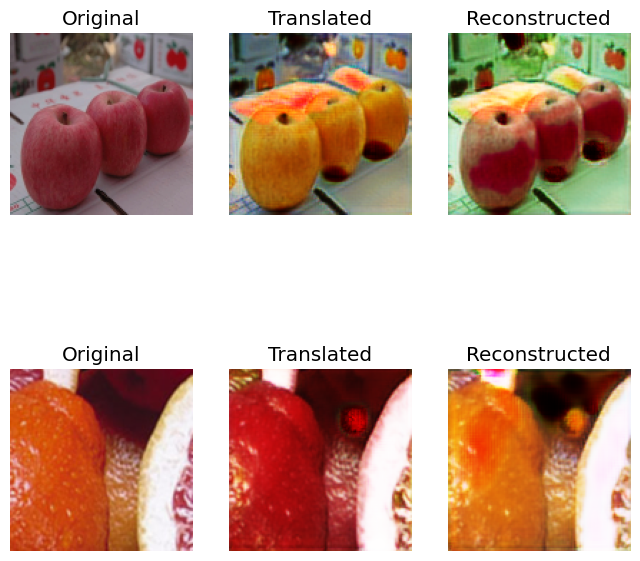

[Epoch 850/16] [Discriminator loss: 0.04330003424547613, accuracy: 99.609375][Generator loss: 5.096456527709961, Adversarial Loss: 0.9288046956062317, Reconstruction Loss: 0.14311254397034645, Identity Loss: 0.17013755440711975]
[Epoch 900/16] [Discriminator loss: 0.03746417025104165, accuracy: 97.265625][Generator loss: 7.333700180053711, Adversarial Loss: 0.909978598356247, Reconstruction Loss: 0.25086086988449097, Identity Loss: 0.2509191632270813]
[Epoch 950/16] [Discriminator loss: 0.2034001478459686, accuracy: 75.0][Generator loss: 5.16826057434082, Adversarial Loss: 0.9283815920352936, Reconstruction Loss: 0.14851437509059906, Identity Loss: 0.14465931057929993]
Epoch=17
[Epoch 0/17] [Discriminator loss: 0.04054105235263705, accuracy: 99.21875][Generator loss: 7.774932861328125, Adversarial Loss: 0.9157019853591919, Reconstruction Loss: 0.2683370113372803, Identity Loss: 0.2028997540473938]


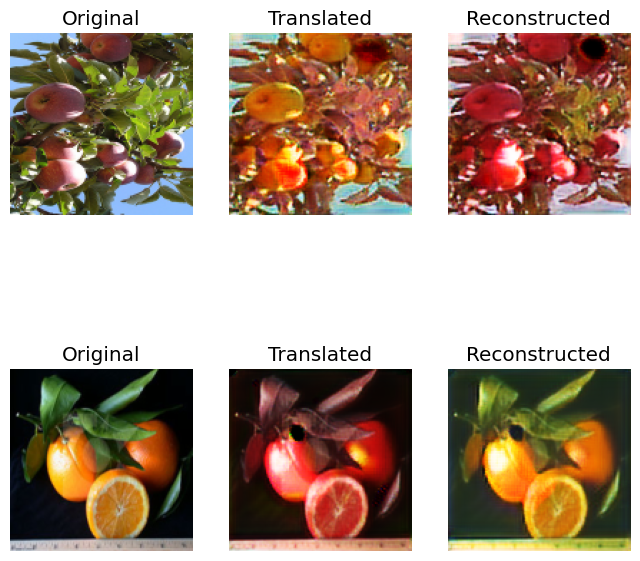

[Epoch 50/17] [Discriminator loss: 0.05967596033588052, accuracy: 97.265625][Generator loss: 5.0008440017700195, Adversarial Loss: 0.9425635039806366, Reconstruction Loss: 0.14222554862499237, Identity Loss: 0.15563403069972992]
[Epoch 100/17] [Discriminator loss: 0.05637031374499202, accuracy: 97.65625][Generator loss: 6.026371002197266, Adversarial Loss: 0.9229398965835571, Reconstruction Loss: 0.18995214253664017, Identity Loss: 0.16566959023475647]
[Epoch 150/17] [Discriminator loss: 0.07277497090399265, accuracy: 94.921875][Generator loss: 4.573452472686768, Adversarial Loss: 0.8242987990379333, Reconstruction Loss: 0.13438745588064194, Identity Loss: 0.09056875854730606]
[Epoch 200/17] [Discriminator loss: 0.16132697276771069, accuracy: 76.953125][Generator loss: 5.879685401916504, Adversarial Loss: 0.8358516693115234, Reconstruction Loss: 0.18811960518360138, Identity Loss: 0.22870725393295288]


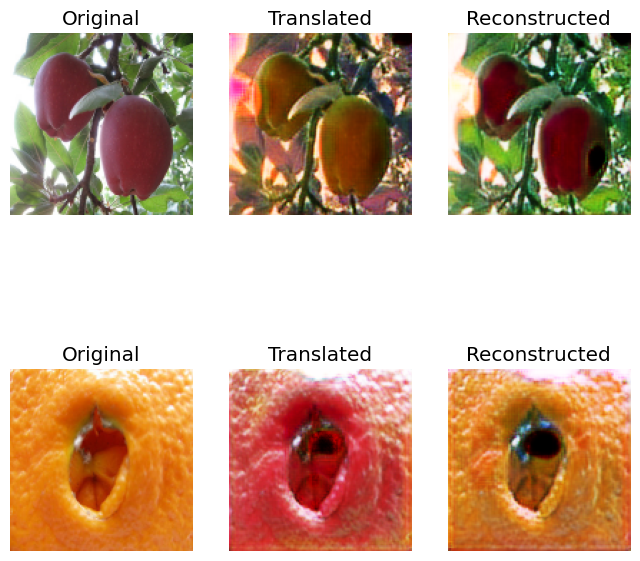

[Epoch 250/17] [Discriminator loss: 0.11847527069039643, accuracy: 81.25][Generator loss: 5.517845153808594, Adversarial Loss: 0.964300274848938, Reconstruction Loss: 0.16371078044176102, Identity Loss: 0.1048709824681282]
[Epoch 300/17] [Discriminator loss: 0.08446898078545928, accuracy: 87.5][Generator loss: 5.942434310913086, Adversarial Loss: 1.1211084723472595, Reconstruction Loss: 0.16644790023565292, Identity Loss: 0.19449269771575928]
[Epoch 350/17] [Discriminator loss: 0.029327364172786474, accuracy: 100.0][Generator loss: 6.03407096862793, Adversarial Loss: 1.0046814382076263, Reconstruction Loss: 0.18485260009765625, Identity Loss: 0.15381136536598206]
[Epoch 400/17] [Discriminator loss: 0.2718907818198204, accuracy: 53.515625][Generator loss: 4.219628810882568, Adversarial Loss: 0.6953399181365967, Reconstruction Loss: 0.12558036297559738, Identity Loss: 0.1778666228055954]


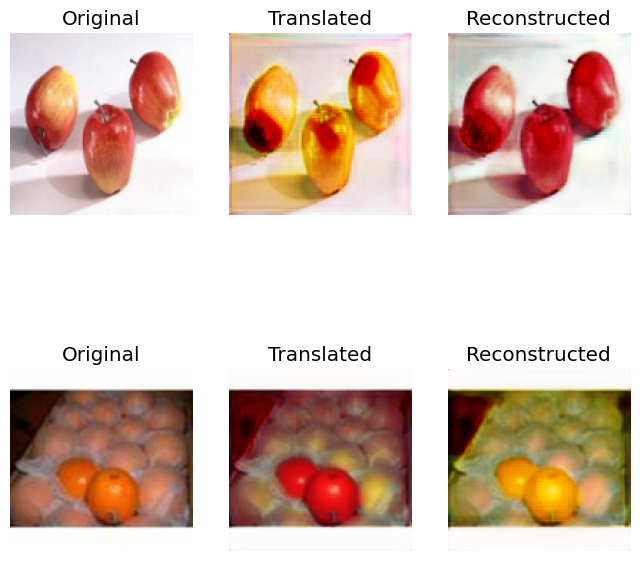

[Epoch 450/17] [Discriminator loss: 0.0718695791438222, accuracy: 94.53125][Generator loss: 5.882077217102051, Adversarial Loss: 0.9232743382453918, Reconstruction Loss: 0.18051809817552567, Identity Loss: 0.19655552506446838]
[Epoch 500/17] [Discriminator loss: 0.07232330366969109, accuracy: 92.96875][Generator loss: 5.271681785583496, Adversarial Loss: 0.7993308901786804, Reconstruction Loss: 0.16888507455587387, Identity Loss: 0.12370793521404266]
[Epoch 550/17] [Discriminator loss: 0.033706833608448505, accuracy: 100.0][Generator loss: 5.088730812072754, Adversarial Loss: 0.9318749308586121, Reconstruction Loss: 0.14267867803573608, Identity Loss: 0.14843279123306274]
[Epoch 600/17] [Discriminator loss: 0.10533716110512614, accuracy: 83.203125][Generator loss: 4.73094367980957, Adversarial Loss: 0.9241392016410828, Reconstruction Loss: 0.1284455992281437, Identity Loss: 0.17566096782684326]


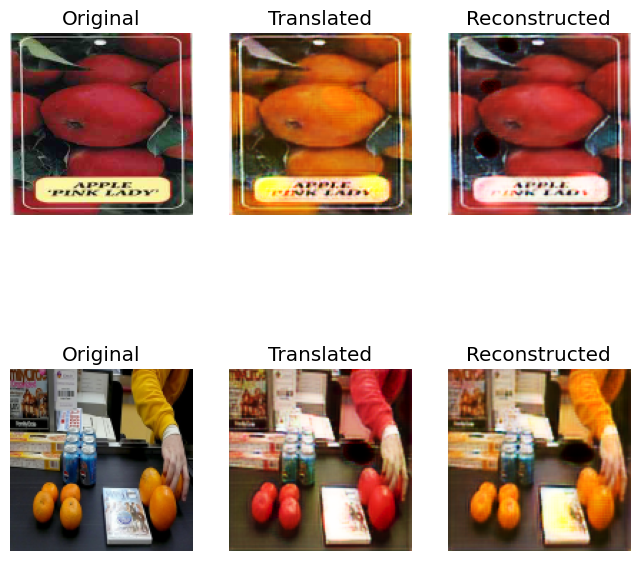

[Epoch 650/17] [Discriminator loss: 0.018535278039053082, accuracy: 99.21875][Generator loss: 6.092595100402832, Adversarial Loss: 1.096654236316681, Reconstruction Loss: 0.17649203538894653, Identity Loss: 0.15522779524326324]
[Epoch 700/17] [Discriminator loss: 0.2034676279872656, accuracy: 76.171875][Generator loss: 4.578474521636963, Adversarial Loss: 0.850302517414093, Reconstruction Loss: 0.1287745013833046, Identity Loss: 0.14554131031036377]
[Epoch 750/17] [Discriminator loss: 0.02518743183463812, accuracy: 100.0][Generator loss: 4.97698974609375, Adversarial Loss: 0.9900795221328735, Reconstruction Loss: 0.13521112501621246, Identity Loss: 0.14578311145305634]
[Epoch 800/17] [Discriminator loss: 0.07373394630849361, accuracy: 92.578125][Generator loss: 4.920912742614746, Adversarial Loss: 0.9110016822814941, Reconstruction Loss: 0.1420263722538948, Identity Loss: 0.1351819932460785]


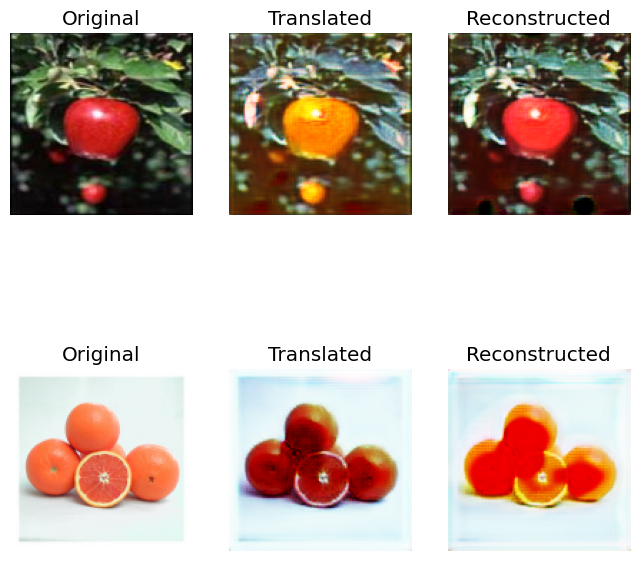

[Epoch 850/17] [Discriminator loss: 0.10259490367025137, accuracy: 92.578125][Generator loss: 5.210544586181641, Adversarial Loss: 0.9469597935676575, Reconstruction Loss: 0.15129345655441284, Identity Loss: 0.12641841173171997]
[Epoch 900/17] [Discriminator loss: 0.13679822953417897, accuracy: 76.953125][Generator loss: 4.783501625061035, Adversarial Loss: 0.8424704372882843, Reconstruction Loss: 0.1420486643910408, Identity Loss: 0.14489586651325226]
[Epoch 950/17] [Discriminator loss: 0.06569068902172148, accuracy: 90.234375][Generator loss: 6.501557350158691, Adversarial Loss: 0.8579173684120178, Reconstruction Loss: 0.2136709913611412, Identity Loss: 0.1368771344423294]
Epoch=18
[Epoch 0/18] [Discriminator loss: 0.03185983817093074, accuracy: 98.828125][Generator loss: 5.469849109649658, Adversarial Loss: 0.9404242038726807, Reconstruction Loss: 0.16187049448490143, Identity Loss: 0.16820964217185974]


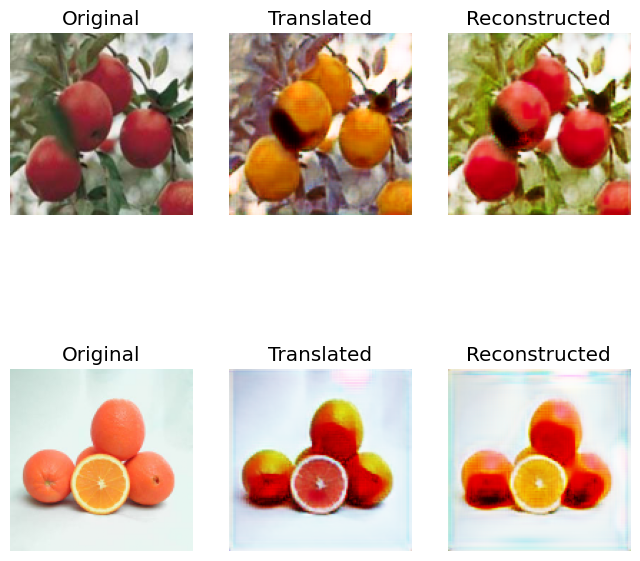

[Epoch 50/18] [Discriminator loss: 0.16313193598762155, accuracy: 76.171875][Generator loss: 5.13141393661499, Adversarial Loss: 0.7718502581119537, Reconstruction Loss: 0.15914235264062881, Identity Loss: 0.23572497069835663]
[Epoch 100/18] [Discriminator loss: 0.03802448103670031, accuracy: 97.265625][Generator loss: 5.611685752868652, Adversarial Loss: 0.9849472045898438, Reconstruction Loss: 0.1642543375492096, Identity Loss: 0.1362236738204956]
[Epoch 150/18] [Discriminator loss: 0.009801560314372182, accuracy: 100.0][Generator loss: 4.978753089904785, Adversarial Loss: 0.9841441512107849, Reconstruction Loss: 0.135383702814579, Identity Loss: 0.11220487952232361]
[Epoch 200/18] [Discriminator loss: 0.39779078867286444, accuracy: 51.171875][Generator loss: 4.4893693923950195, Adversarial Loss: 0.685558557510376, Reconstruction Loss: 0.1418902352452278, Identity Loss: 0.11256425082683563]


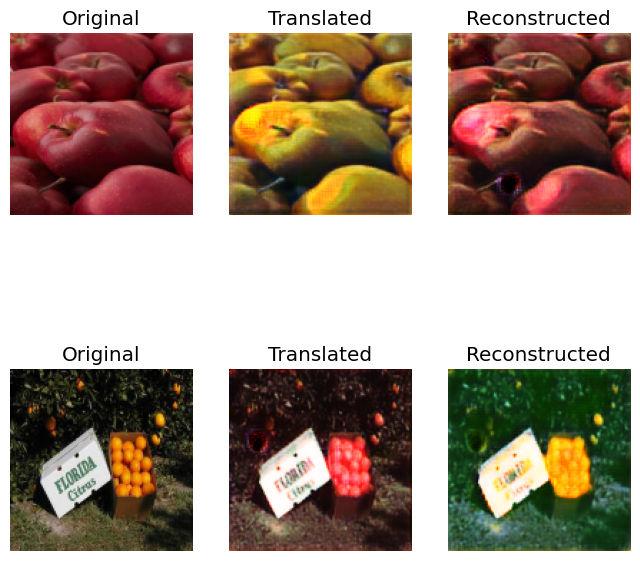

[Epoch 250/18] [Discriminator loss: 0.0789385437965393, accuracy: 92.578125][Generator loss: 5.421337604522705, Adversarial Loss: 0.9099705219268799, Reconstruction Loss: 0.1625092327594757, Identity Loss: 0.1927398443222046]
[Epoch 300/18] [Discriminator loss: 0.02040730812586844, accuracy: 99.609375][Generator loss: 5.817794322967529, Adversarial Loss: 1.080161452293396, Reconstruction Loss: 0.16438277065753937, Identity Loss: 0.17433197796344757]
[Epoch 350/18] [Discriminator loss: 0.15662212623283267, accuracy: 75.0][Generator loss: 6.504264831542969, Adversarial Loss: 1.0690332651138306, Reconstruction Loss: 0.19633059203624725, Identity Loss: 0.10304088890552521]
[Epoch 400/18] [Discriminator loss: 0.09190787374973297, accuracy: 89.84375][Generator loss: 4.00492000579834, Adversarial Loss: 0.8949124813079834, Reconstruction Loss: 0.09858518838882446, Identity Loss: 0.12052886188030243]


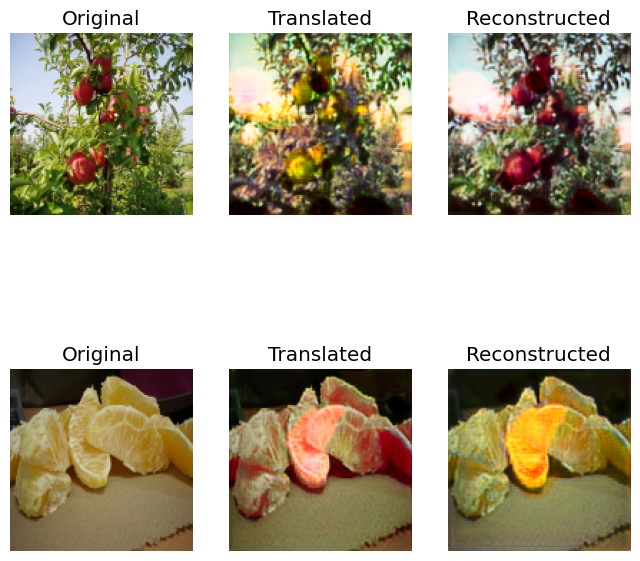

[Epoch 450/18] [Discriminator loss: 0.08043312933295965, accuracy: 89.0625][Generator loss: 5.14306640625, Adversarial Loss: 0.8290730118751526, Reconstruction Loss: 0.15687912702560425, Identity Loss: 0.19154158234596252]
[Epoch 500/18] [Discriminator loss: 0.025680222548544407, accuracy: 100.0][Generator loss: 5.789239883422852, Adversarial Loss: 0.9908043146133423, Reconstruction Loss: 0.16849802061915398, Identity Loss: 0.1785101294517517]
[Epoch 550/18] [Discriminator loss: 0.1724920365959406, accuracy: 74.21875][Generator loss: 4.037171363830566, Adversarial Loss: 0.6910475194454193, Reconstruction Loss: 0.11754828691482544, Identity Loss: 0.1868126094341278]
[Epoch 600/18] [Discriminator loss: 0.03905063075944781, accuracy: 98.4375][Generator loss: 4.830636501312256, Adversarial Loss: 0.8988926708698273, Reconstruction Loss: 0.1302356719970703, Identity Loss: 0.2635566294193268]


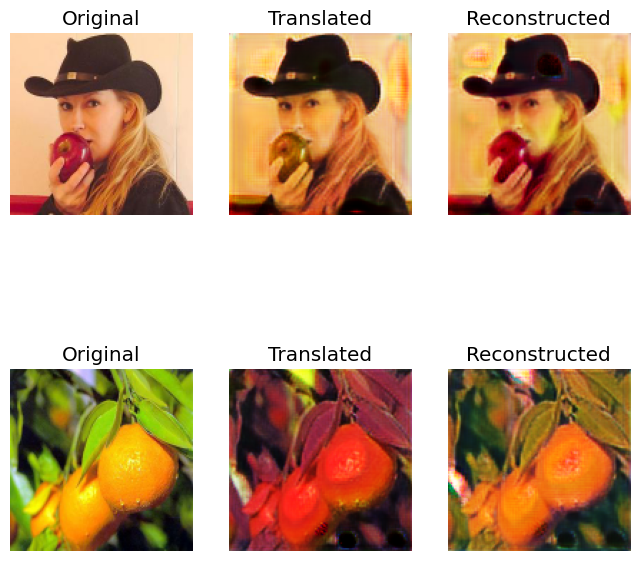

[Epoch 650/18] [Discriminator loss: 0.1276828944683075, accuracy: 79.296875][Generator loss: 5.364889621734619, Adversarial Loss: 0.8907499313354492, Reconstruction Loss: 0.1614530310034752, Identity Loss: 0.18727391958236694]
[Epoch 700/18] [Discriminator loss: 0.09307154326234013, accuracy: 83.203125][Generator loss: 4.947246551513672, Adversarial Loss: 0.9478018879890442, Reconstruction Loss: 0.13702574744820595, Identity Loss: 0.09319169819355011]
[Epoch 750/18] [Discriminator loss: 0.06135590514168143, accuracy: 95.3125][Generator loss: 4.790493488311768, Adversarial Loss: 0.8291465044021606, Reconstruction Loss: 0.14052178710699081, Identity Loss: 0.1834314465522766]
[Epoch 800/18] [Discriminator loss: 0.30151789728552103, accuracy: 69.140625][Generator loss: 5.972574710845947, Adversarial Loss: 0.9313453733921051, Reconstruction Loss: 0.18365158885717392, Identity Loss: 0.27088379859924316]


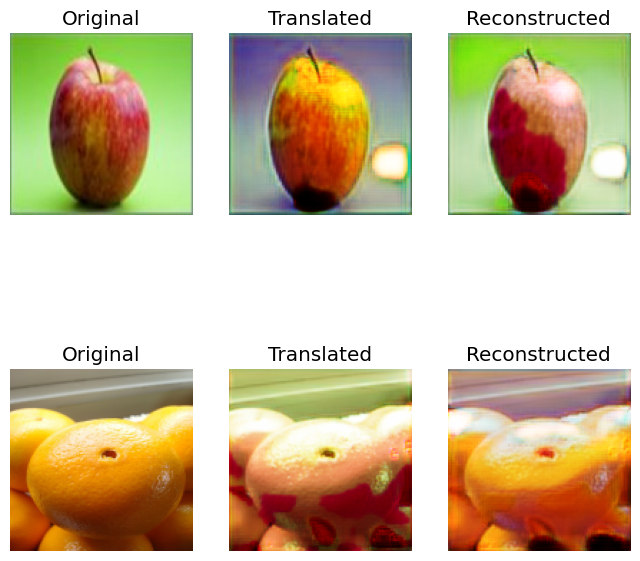

[Epoch 850/18] [Discriminator loss: 0.14918383350595832, accuracy: 73.828125][Generator loss: 4.723466873168945, Adversarial Loss: 0.8033144176006317, Reconstruction Loss: 0.14365911111235619, Identity Loss: 0.10516169667243958]
[Epoch 900/18] [Discriminator loss: 0.05062777688726783, accuracy: 97.265625][Generator loss: 7.639565467834473, Adversarial Loss: 1.0454825162887573, Reconstruction Loss: 0.25155994296073914, Identity Loss: 0.2599746584892273]
[Epoch 950/18] [Discriminator loss: 0.031726031098514795, accuracy: 100.0][Generator loss: 5.509835243225098, Adversarial Loss: 1.0369606018066406, Reconstruction Loss: 0.15391384810209274, Identity Loss: 0.2068367898464203]
Epoch=19
[Epoch 0/19] [Discriminator loss: 0.026378636015579104, accuracy: 100.0][Generator loss: 5.818248271942139, Adversarial Loss: 0.8798312842845917, Reconstruction Loss: 0.1799870878458023, Identity Loss: 0.22391536831855774]


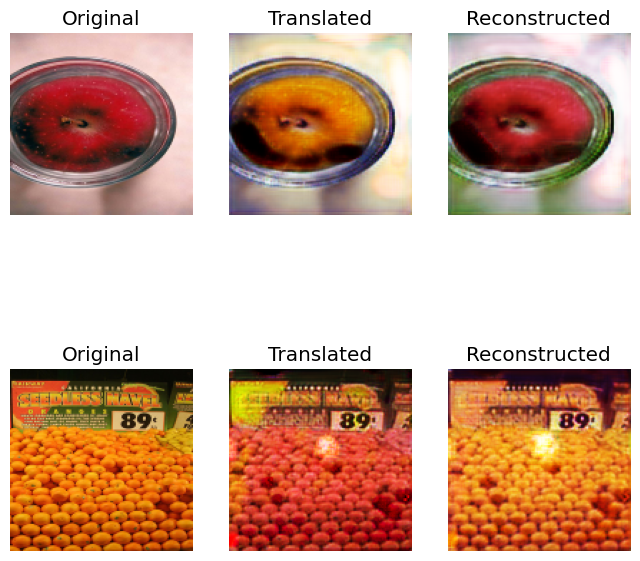

[Epoch 50/19] [Discriminator loss: 0.015038876794278622, accuracy: 100.0][Generator loss: 5.379086494445801, Adversarial Loss: 0.9975740909576416, Reconstruction Loss: 0.15208691358566284, Identity Loss: 0.16684558987617493]
[Epoch 100/19] [Discriminator loss: 0.010217057541012764, accuracy: 100.0][Generator loss: 6.034948348999023, Adversarial Loss: 1.0302590727806091, Reconstruction Loss: 0.1775132343173027, Identity Loss: 0.1969512403011322]
[Epoch 150/19] [Discriminator loss: 0.04313543951138854, accuracy: 94.921875][Generator loss: 4.905213832855225, Adversarial Loss: 0.8730692565441132, Reconstruction Loss: 0.1447906792163849, Identity Loss: 0.1262175440788269]
[Epoch 200/19] [Discriminator loss: 0.11284915776923299, accuracy: 89.0625][Generator loss: 5.340543270111084, Adversarial Loss: 0.9967251121997833, Reconstruction Loss: 0.1501896157860756, Identity Loss: 0.19144371151924133]


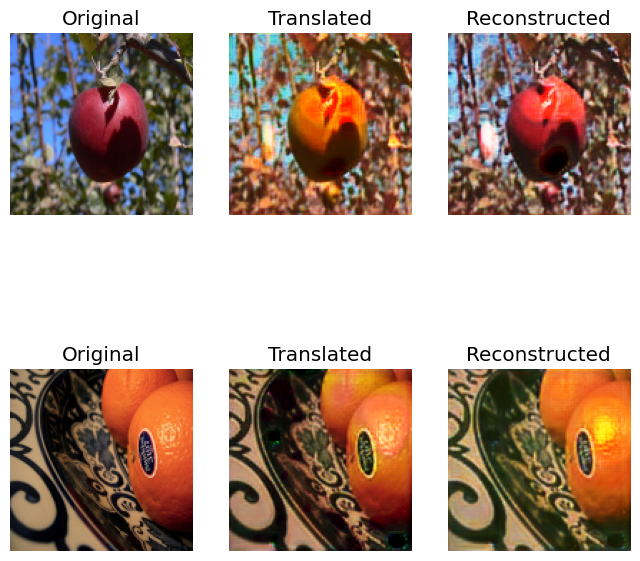

[Epoch 250/19] [Discriminator loss: 0.11621008533984423, accuracy: 87.109375][Generator loss: 5.446393013000488, Adversarial Loss: 1.0563184022903442, Reconstruction Loss: 0.15299341827630997, Identity Loss: 0.14277160167694092]
[Epoch 300/19] [Discriminator loss: 0.10664172458928078, accuracy: 84.765625][Generator loss: 4.652580738067627, Adversarial Loss: 0.995624840259552, Reconstruction Loss: 0.117658581584692, Identity Loss: 0.13645315170288086]
[Epoch 350/19] [Discriminator loss: 0.02184618718456477, accuracy: 100.0][Generator loss: 5.162064552307129, Adversarial Loss: 0.937503844499588, Reconstruction Loss: 0.14588751271367073, Identity Loss: 0.15641982853412628]
[Epoch 400/19] [Discriminator loss: 0.05198901274707168, accuracy: 94.53125][Generator loss: 6.183305740356445, Adversarial Loss: 1.0578908920288086, Reconstruction Loss: 0.18570337444543839, Identity Loss: 0.16117504239082336]


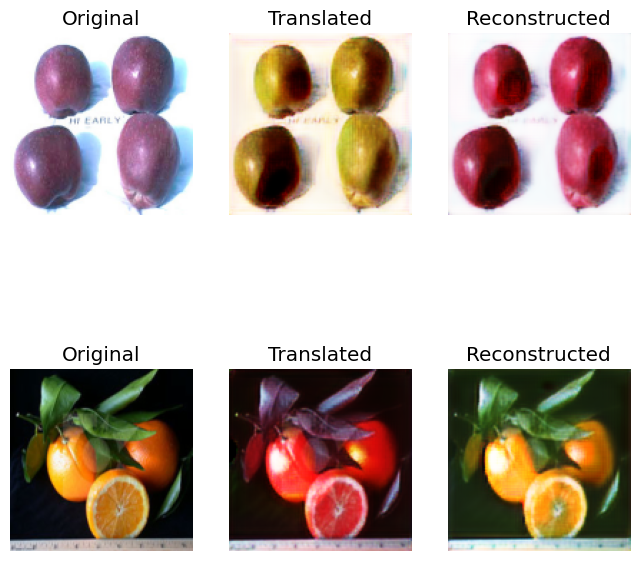

[Epoch 450/19] [Discriminator loss: 0.06604151480132714, accuracy: 95.703125][Generator loss: 5.412848472595215, Adversarial Loss: 0.9970203042030334, Reconstruction Loss: 0.15617333725094795, Identity Loss: 0.14027446508407593]
[Epoch 500/19] [Discriminator loss: 0.07014168193563819, accuracy: 92.96875][Generator loss: 5.326041221618652, Adversarial Loss: 0.869251936674118, Reconstruction Loss: 0.15901566296815872, Identity Loss: 0.18112465739250183]
[Epoch 550/19] [Discriminator loss: 0.08802384464070201, accuracy: 91.796875][Generator loss: 5.518732070922852, Adversarial Loss: 0.8568752110004425, Reconstruction Loss: 0.1663224697113037, Identity Loss: 0.21061921119689941]
[Epoch 600/19] [Discriminator loss: 0.22462713136337698, accuracy: 62.109375][Generator loss: 6.36137580871582, Adversarial Loss: 0.8430930376052856, Reconstruction Loss: 0.2105764001607895, Identity Loss: 0.3064160943031311]


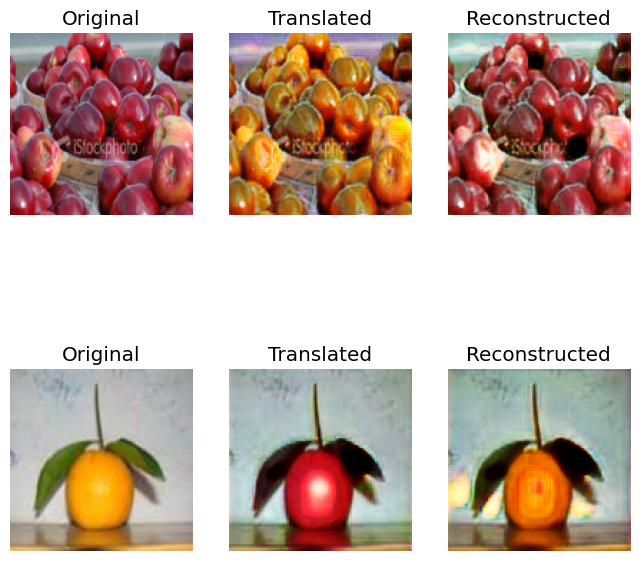

[Epoch 650/19] [Discriminator loss: 0.40834181010723114, accuracy: 44.921875][Generator loss: 3.688906669616699, Adversarial Loss: 0.6677418351173401, Reconstruction Loss: 0.10184336081147194, Identity Loss: 0.13486547768115997]
[Epoch 700/19] [Discriminator loss: 0.052732547745108604, accuracy: 97.265625][Generator loss: 5.699613094329834, Adversarial Loss: 0.7620188891887665, Reconstruction Loss: 0.18184740096330643, Identity Loss: 0.309005469083786]
[Epoch 750/19] [Discriminator loss: 0.03982310742139816, accuracy: 96.484375][Generator loss: 4.959627151489258, Adversarial Loss: 0.9651258587837219, Reconstruction Loss: 0.13686765357851982, Identity Loss: 0.1470922827720642]
[Epoch 800/19] [Discriminator loss: 0.02013581432402134, accuracy: 100.0][Generator loss: 6.130114555358887, Adversarial Loss: 1.000707358121872, Reconstruction Loss: 0.18407978117465973, Identity Loss: 0.25825685262680054]


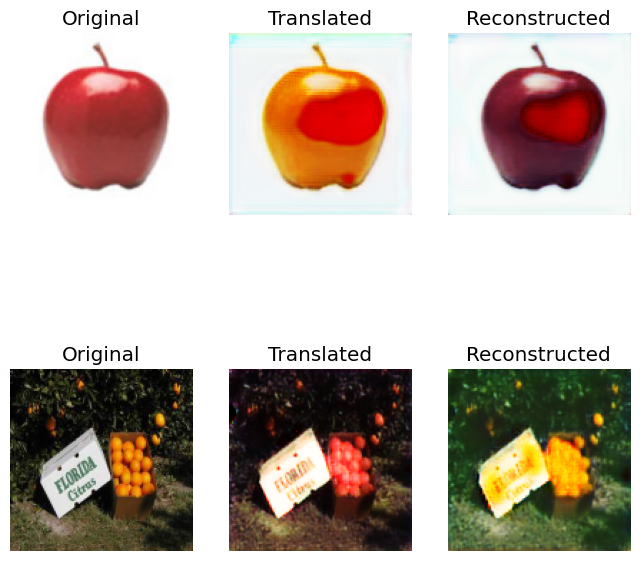

[Epoch 850/19] [Discriminator loss: 0.08411095524206758, accuracy: 91.40625][Generator loss: 4.556167125701904, Adversarial Loss: 0.85055872797966, Reconstruction Loss: 0.12597671523690224, Identity Loss: 0.15288160741329193]
[Epoch 900/19] [Discriminator loss: 0.015075161587446928, accuracy: 100.0][Generator loss: 4.947476387023926, Adversarial Loss: 0.954968273639679, Reconstruction Loss: 0.13523850962519646, Identity Loss: 0.1355287730693817]
[Epoch 950/19] [Discriminator loss: 0.07658663019537926, accuracy: 89.453125][Generator loss: 6.120765209197998, Adversarial Loss: 1.1288418769836426, Reconstruction Loss: 0.17514148354530334, Identity Loss: 0.2251119315624237]
Epoch=20
[Epoch 0/20] [Discriminator loss: 0.018985206028446555, accuracy: 100.0][Generator loss: 5.46157169342041, Adversarial Loss: 1.0637675523757935, Reconstruction Loss: 0.15099740773439407, Identity Loss: 0.1521117240190506]


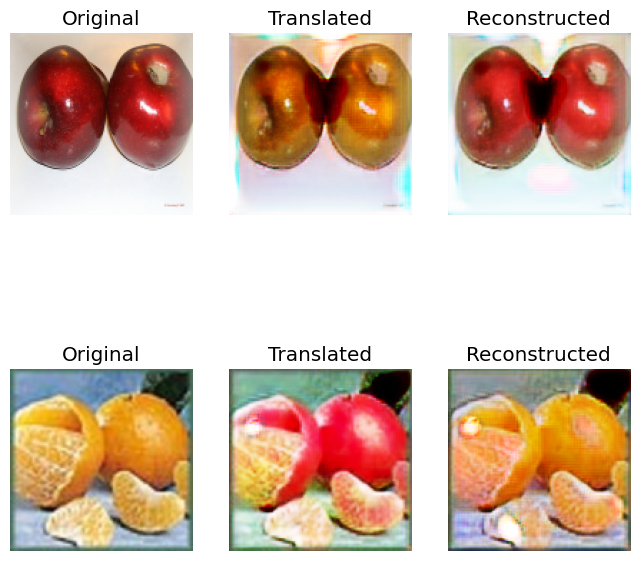

[Epoch 50/20] [Discriminator loss: 0.09778043488040566, accuracy: 84.765625][Generator loss: 4.9162092208862305, Adversarial Loss: 0.8629537224769592, Reconstruction Loss: 0.14338567107915878, Identity Loss: 0.17513546347618103]
[Epoch 100/20] [Discriminator loss: 0.03619229840114713, accuracy: 96.484375][Generator loss: 6.003270149230957, Adversarial Loss: 0.8862895369529724, Reconstruction Loss: 0.1880282536149025, Identity Loss: 0.30809101462364197]
[Epoch 150/20] [Discriminator loss: 0.06646553752943873, accuracy: 96.484375][Generator loss: 5.2605509757995605, Adversarial Loss: 0.9118772149085999, Reconstruction Loss: 0.1520717442035675, Identity Loss: 0.21539825201034546]
[Epoch 200/20] [Discriminator loss: 0.02373937680386007, accuracy: 99.21875][Generator loss: 6.434344291687012, Adversarial Loss: 0.940344512462616, Reconstruction Loss: 0.20736155658960342, Identity Loss: 0.13305985927581787]


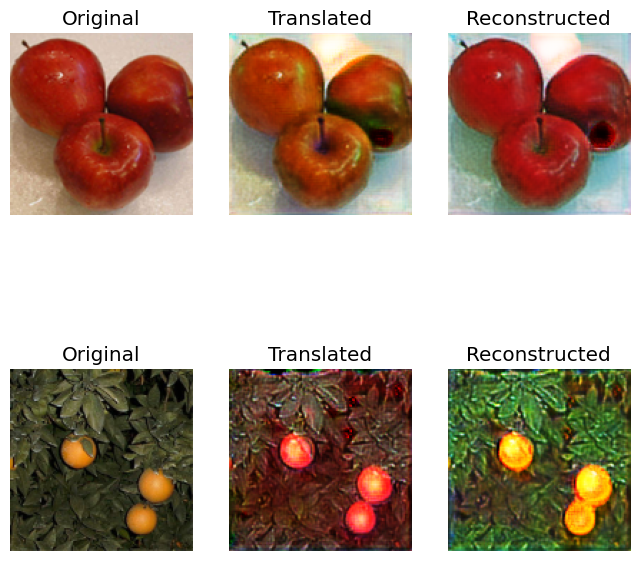

[Epoch 250/20] [Discriminator loss: 0.10582750290632248, accuracy: 83.59375][Generator loss: 4.914192199707031, Adversarial Loss: 1.028419315814972, Reconstruction Loss: 0.12970803678035736, Identity Loss: 0.09936262667179108]
[Epoch 300/20] [Discriminator loss: 0.052325943019241095, accuracy: 93.359375][Generator loss: 5.171174049377441, Adversarial Loss: 0.8959428369998932, Reconstruction Loss: 0.15047092735767365, Identity Loss: 0.14405325055122375]
[Epoch 350/20] [Discriminator loss: 0.026867058128118515, accuracy: 100.0][Generator loss: 5.566951751708984, Adversarial Loss: 0.8666092753410339, Reconstruction Loss: 0.1714961901307106, Identity Loss: 0.19922158122062683]
[Epoch 400/20] [Discriminator loss: 0.02168560097925365, accuracy: 100.0][Generator loss: 5.66502046585083, Adversarial Loss: 1.0665221214294434, Reconstruction Loss: 0.15903377532958984, Identity Loss: 0.17933005094528198]


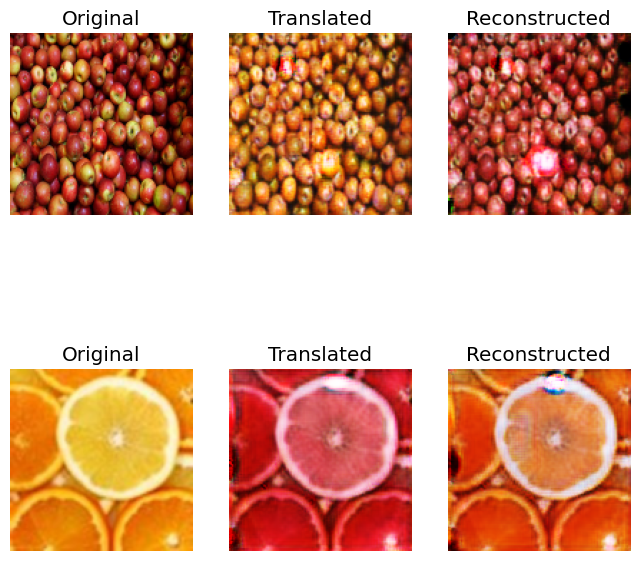

[Epoch 450/20] [Discriminator loss: 0.026260956656187773, accuracy: 100.0][Generator loss: 4.831294059753418, Adversarial Loss: 0.9169909656047821, Reconstruction Loss: 0.13644953817129135, Identity Loss: 0.1258980929851532]


In [ ]:
train(gen_AB, 
      gen_BA, 
      disc_A, 
      disc_B, 
      gan, 
      patch_gan_shape, 
      epochs=200, 
      batch_size=1, 
      sample_interval=200)